In [1]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="T6GLHVi1ZPBseih858yD")
project = rf.workspace("ngoc-tfn96").project("speech-balloons-detection-txibf")
version = project.version(3)
dataset = version.download("voc")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Speech-Balloons-Detection-3 in voc:: 100%|██████████| 465/465 [00:00<00:00, 883.85it/s]


In [1]:
import os
import subprocess
from pathlib import Path

END_WITH_LOCAL = 'bubble-detection'

os.environ['PATH'] = f"/root/.cargo/bin:{os.environ['PATH']}"

BASE_DIR = os.getcwd()
print(f"BASE_DIR: {BASE_DIR}")

# Simple validation
if not (BASE_DIR.endswith('/content') or BASE_DIR.endswith(END_WITH_LOCAL)):
    raise ValueError(f"Expected to be in .../{END_WITH_LOCAL} or .../content directory, but got: {BASE_DIR}")

BASE_DIR: e:\B3\group_prj\characters-and-dialouges-association-in-comics\code\bubble-detection


In [2]:
import shutil
import os
from pathlib import Path

# Move and rename the annotation folder
source_dir = os.path.join(BASE_DIR, 'Speech-Balloons-Detection-3')
# Note: The destination is now inside the Manga109 data folder
dest_parent_dir = os.path.join(BASE_DIR, '../../data/Manga109/')
final_dest_dir = os.path.join(dest_parent_dir, 'Human_Annotate_300')

if os.path.isdir(source_dir):
    try:
        # If the destination directory already exists, remove it to ensure a clean move
        if os.path.exists(final_dest_dir):
            print(f"Destination '{final_dest_dir}' already exists. Removing it.")
            shutil.rmtree(final_dest_dir)
        
        # Move and rename the directory
        shutil.move(source_dir, final_dest_dir)
        print(f"Successfully moved and renamed '{source_dir}' to '{final_dest_dir}'")
    except Exception as e:
        print(f"An error occurred while moving the folder: {e}")
else:
    print(f"Source folder '{source_dir}' not found. Skipping move operation.")


Source folder 'e:\B3\group_prj\characters-and-dialouges-association-in-comics\code\bubble-detection\Speech-Balloons-Detection-3' not found. Skipping move operation.


In [3]:
import os
from pathlib import Path

Manga109_dir = os.path.join(BASE_DIR,'../../data/Manga109/Manga109_released_2023_12_07/images')


In [4]:
folders = [f.name for f in Path(Manga109_dir).iterdir() if f.is_dir()]
print(folders)

['AisazuNihaIrarenai', 'AkkeraKanjinchou', 'Akuhamu', 'AosugiruHaru', 'AppareKappore', 'Arisa', 'ARMS', 'BakuretsuKungFuGirl', 'Belmondo', 'BEMADER_P', 'BokuHaSitatakaKun', 'BurariTessenTorimonocho', 'ByebyeC-BOY', 'Count3DeKimeteAgeru', 'DollGun', 'Donburakokko', 'DualJustice', 'EienNoWith', 'EvaLady', 'EverydayOsakanaChan', 'GakuenNoise', 'GarakutayaManta', 'GinNoChimera', 'GOOD_KISS_Ver2', 'Hamlet', 'HanzaiKousyouninMinegishiEitarou', 'HaruichibanNoFukukoro', 'HarukaRefrain', 'HealingPlanet', 'HeiseiJimen', 'HighschoolKimengumi_vol01', 'HighschoolKimengumi_vol20', 'HinagikuKenzan', 'HisokaReturns', 'JangiriPonpon', 'JijiBabaFight', 'Joouari', 'Jyovolley', 'KarappoHighschool', 'KimiHaBokuNoTaiyouDa', 'KoukouNoHitotachi', 'KuroidoGanka', 'KyokugenCyclone', 'LancelotFullThrottle', 'LoveHina_vol01', 'LoveHina_vol14', 'MadouTaiga', 'MAD_STONE', 'MagicianLoad', 'MagicStarGakuin', 'MariaSamaNihaNaisyo', 'MayaNoAkaiKutsu', 'MemorySeijin', 'MeteoSanStrikeDesu', 'MiraiSan', 'MisutenaideDaisy'

In [5]:
folders = sorted([f.name for f in Path(Manga109_dir).iterdir() if f.is_dir()])
print(folders)

['ARMS', 'AisazuNihaIrarenai', 'AkkeraKanjinchou', 'Akuhamu', 'AosugiruHaru', 'AppareKappore', 'Arisa', 'BEMADER_P', 'BakuretsuKungFuGirl', 'Belmondo', 'BokuHaSitatakaKun', 'BurariTessenTorimonocho', 'ByebyeC-BOY', 'Count3DeKimeteAgeru', 'DollGun', 'Donburakokko', 'DualJustice', 'EienNoWith', 'EvaLady', 'EverydayOsakanaChan', 'GOOD_KISS_Ver2', 'GakuenNoise', 'GarakutayaManta', 'GinNoChimera', 'Hamlet', 'HanzaiKousyouninMinegishiEitarou', 'HaruichibanNoFukukoro', 'HarukaRefrain', 'HealingPlanet', 'HeiseiJimen', 'HighschoolKimengumi_vol01', 'HighschoolKimengumi_vol20', 'HinagikuKenzan', 'HisokaReturns', 'JangiriPonpon', 'JijiBabaFight', 'Joouari', 'Jyovolley', 'KarappoHighschool', 'KimiHaBokuNoTaiyouDa', 'KoukouNoHitotachi', 'KuroidoGanka', 'KyokugenCyclone', 'LancelotFullThrottle', 'LoveHina_vol01', 'LoveHina_vol14', 'MAD_STONE', 'MadouTaiga', 'MagicStarGakuin', 'MagicianLoad', 'MariaSamaNihaNaisyo', 'MayaNoAkaiKutsu', 'MemorySeijin', 'MeteoSanStrikeDesu', 'MiraiSan', 'MisutenaideDaisy'

In [6]:
original_image_path = []

# Get the first 30 sorted (case-sensitive) folders (volumes)
first_30_volumes = sorted([f for f in Path(Manga109_dir).iterdir() if f.is_dir()], key=lambda x: x.name)[:35]

# For each volume, get the first 11 images sorted in ascending order
for volume in first_30_volumes:
    images = sorted([f for f in volume.iterdir() if f.is_file() and f.suffix.lower() == '.jpg'], key=lambda x: x.name)
    for img_path in images[:21]:
        original_image_path.append(str(img_path))

print(len(original_image_path))

human_annotate_dir = os.path.join(BASE_DIR,'../../data/Manga109/Human_Annotate_300/train')

all_img_paths = []

# for root, dirs, files in os.walk(human_annotate_dir):
#     for file in files:
#         if file.lower().endswith(('.jpg', '.jpeg', '.png')):
#             all_img_paths.append(os.path.join(root, file))

# Only scan immediate directory (no subdirectories)
all_img_paths = []
for file in os.listdir(human_annotate_dir):
    file_path = os.path.join(human_annotate_dir, file)
    if os.path.isfile(file_path) and file.lower().endswith(('.jpg', '.jpeg', '.png')):
        all_img_paths.append(file_path)

print(len(all_img_paths))

for volume in first_30_volumes:
    os.makedirs(os.path.join(human_annotate_dir, volume.name), exist_ok=True)

588
0


In [34]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
import time
import hashlib
from concurrent.futures import ThreadPoolExecutor
import os

# Option 1: Fast hash-based comparison (fastest)
def compare_images_hash(path1, path2):
    """Fast comparison using file hash"""
    try:
        with open(path1, 'rb') as f1, open(path2, 'rb') as f2:
            hash1 = hashlib.md5(f1.read()).hexdigest()
            hash2 = hashlib.md5(f2.read()).hexdigest()
            return hash1 == hash2
    except:
        return False

# Option 2: Fast perceptual hash comparison
def compare_images_phash(path1, path2, threshold=5):
    """Fast perceptual hash comparison"""
    try:
        import imagehash
        from PIL import Image
        
        img1 = Image.open(path1)
        img2 = Image.open(path2)
        
        hash1 = imagehash.phash(img1)
        hash2 = imagehash.phash(img2)
        
        difference = hash1 - hash2
        return difference <= threshold
    except:
        return False

# Option 3: GPU-accelerated comparison using OpenCV with Metal Performance Shaders (Mac)
def compare_images_fast(path1, path2, threshold=0.85):
    """Faster comparison with reduced image size and GPU acceleration where possible"""
    img1 = cv2.imread(path1)
    img2 = cv2.imread(path2)

    if img1 is None or img2 is None:
        return False
    
    # Resize images to smaller size for faster processing
    target_size = (256, 256)  # Much smaller for speed
    img1_small = cv2.resize(img1, target_size)
    img2_small = cv2.resize(img2, target_size)
    
    # Convert to grayscale
    gray1 = cv2.cvtColor(img1_small, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(img2_small, cv2.COLOR_BGR2GRAY)
    
    # Use template matching (faster than SSIM)
    result = cv2.matchTemplate(gray1, gray2, cv2.TM_CCOEFF_NORMED)
    similarity_score = np.max(result)
    
    if similarity_score >= threshold:
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
        plt.title('Image Original to compare')
        plt.subplot(1, 3, 2)
        plt.imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
        plt.title('Image in Human Annotate')
        plt.subplot(1, 3, 3)
        plt.text(0.5, 0.5, f'Similarity Score: {similarity_score:.4f}', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes, fontsize=14)
        plt.axis('off')
        plt.show()
        time.sleep(0.2)
        plt.close()
        return True
    
    return False

# Option 4: Multi-threaded batch comparison
def compare_images_batch(original_paths, human_paths, comparison_func=compare_images_fast):
    """Process multiple images in parallel"""
    matches = []
    
    def compare_single(args):
        orig_path, human_path = args
        return comparison_func(orig_path, human_path), orig_path, human_path
    
    # Create all combinations to compare
    comparisons = [(orig, human) for orig in original_paths for human in human_paths]
    
    # Use ThreadPoolExecutor for parallel processing
    with ThreadPoolExecutor(max_workers=os.cpu_count()) as executor:
        results = list(executor.map(compare_single, comparisons))
    
    # Filter matches
    for is_match, orig_path, human_path in results:
        if is_match:
            matches.append((orig_path, human_path))
    
    return matches

# Choose your comparison function:
# For exact matches: compare_images = compare_images_hash
# For similar images: compare_images = compare_images_phash  
# For flexible similarity: compare_images = compare_images_fast

compare_images = compare_images_fast  # Default choice

Total original images to find: 588
Total images in human annotate directory: 231


Processing original images:   4%|▍         | 23/588 [02:20<58:06,  6.17s/it] 

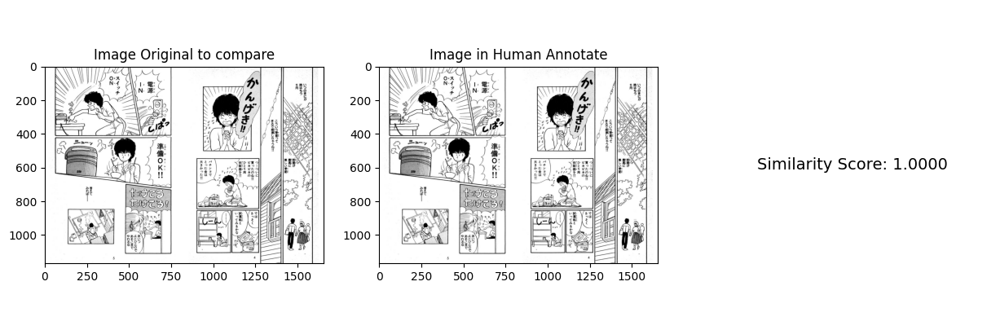

Processing original images:   4%|▍         | 24/588 [02:21<45:24,  4.83s/it]

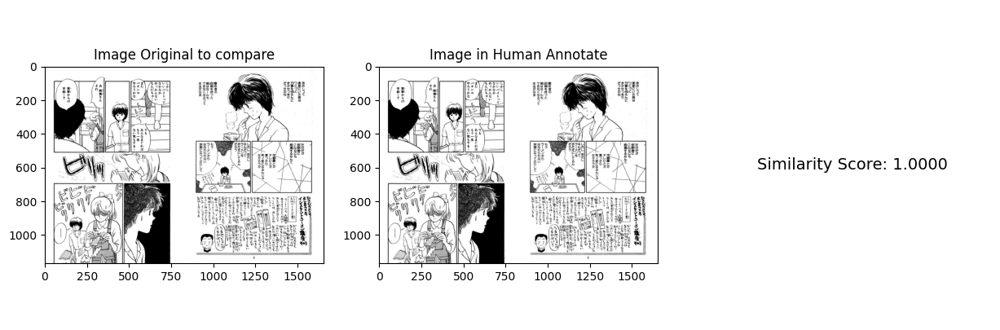

Processing original images:   4%|▍         | 25/588 [02:24<39:13,  4.18s/it]

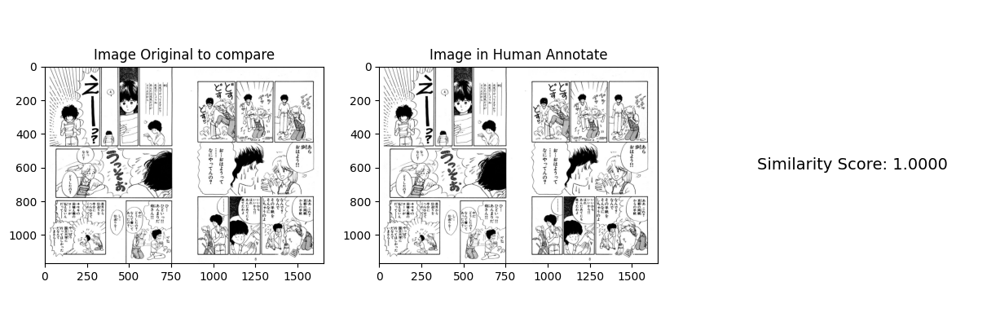

Processing original images:   4%|▍         | 26/588 [02:27<36:18,  3.88s/it]

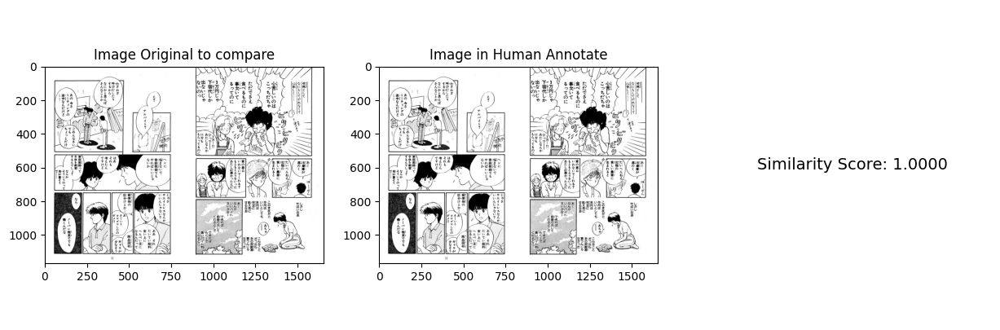

Processing original images:   5%|▍         | 27/588 [02:30<33:56,  3.63s/it]

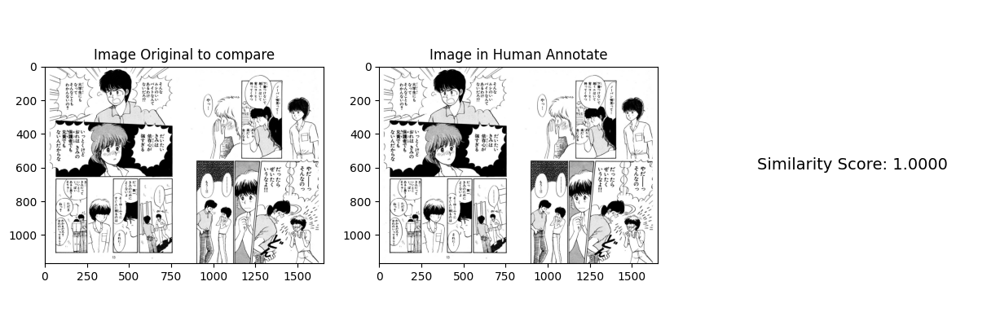

Processing original images:   5%|▍         | 28/588 [02:34<34:13,  3.67s/it]

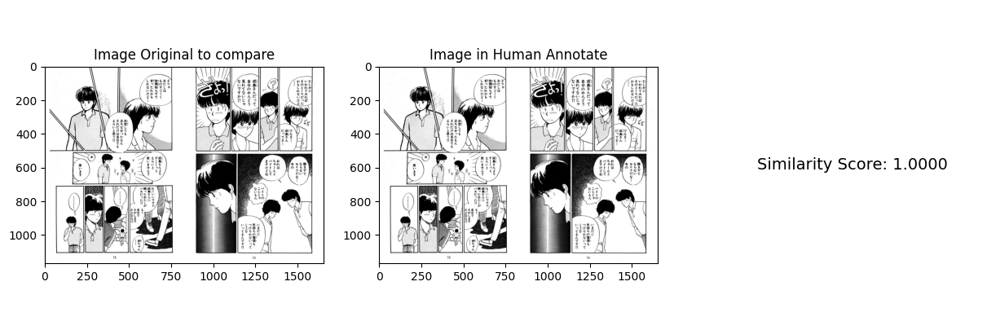

Processing original images:   5%|▍         | 29/588 [02:39<37:39,  4.04s/it]

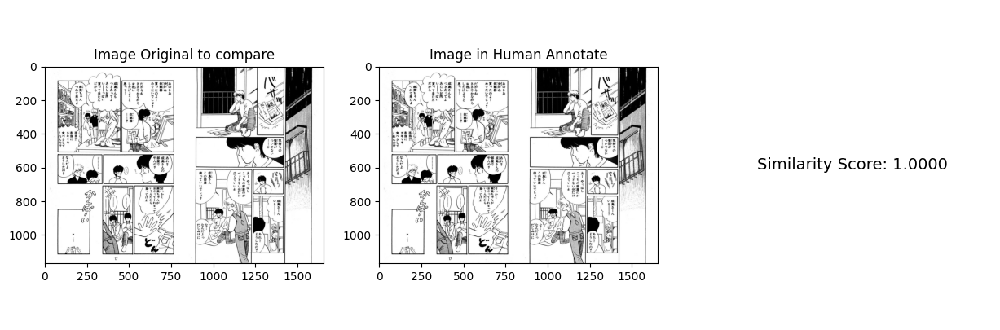

Processing original images:   5%|▌         | 30/588 [02:45<41:58,  4.51s/it]

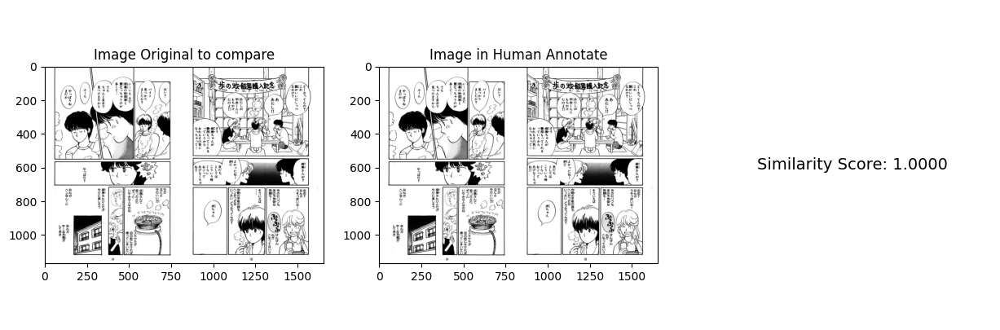

Processing original images:   7%|▋         | 43/588 [04:09<1:00:21,  6.64s/it]

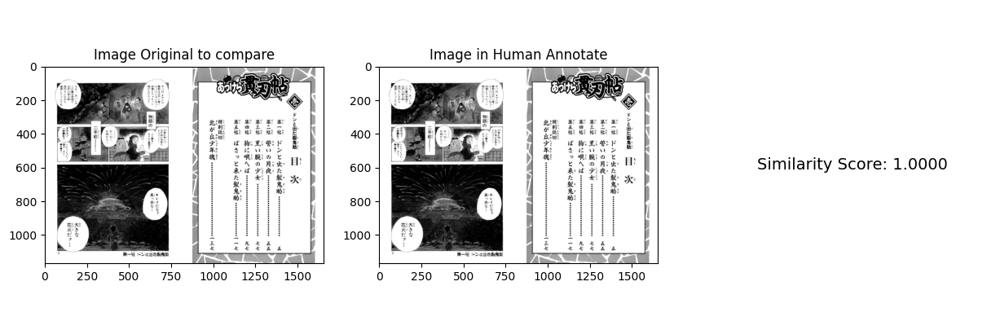

Processing original images:   8%|▊         | 45/588 [04:16<48:12,  5.33s/it]  

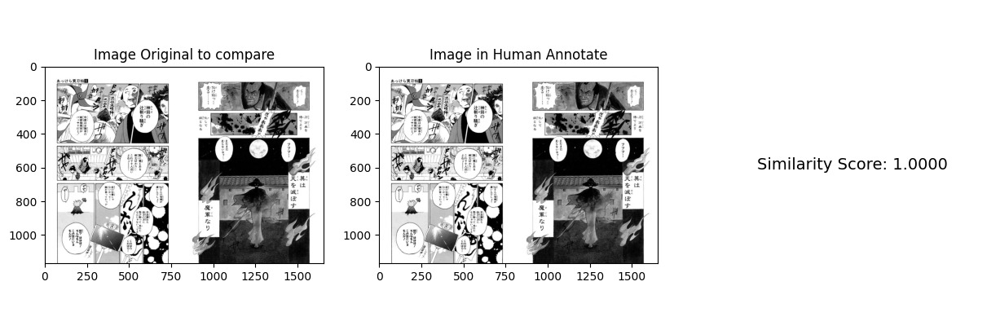

Processing original images:   8%|▊         | 46/588 [04:18<38:15,  4.24s/it]

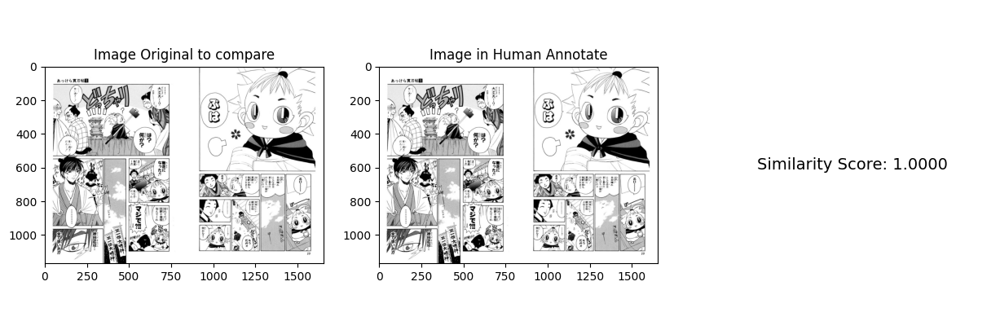

Processing original images:   8%|▊         | 47/588 [04:20<34:09,  3.79s/it]

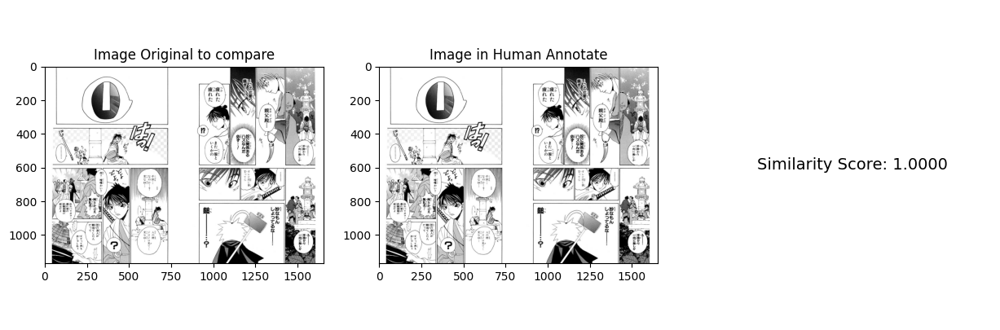

Processing original images:   8%|▊         | 48/588 [04:24<32:56,  3.66s/it]

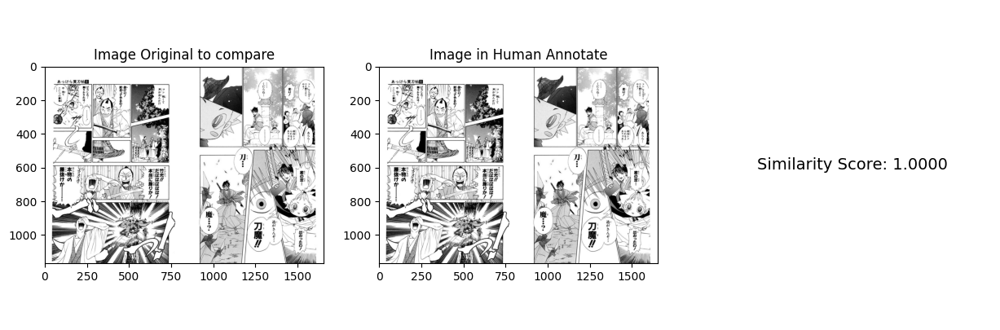

Processing original images:   8%|▊         | 49/588 [04:28<34:02,  3.79s/it]

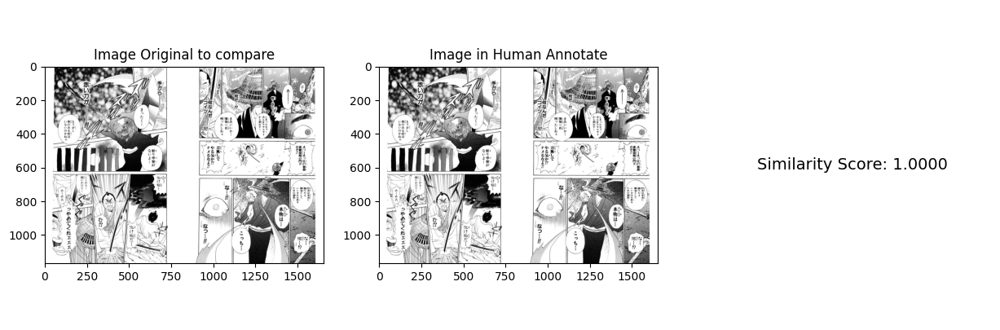

Processing original images:   9%|▊         | 50/588 [04:33<36:51,  4.11s/it]

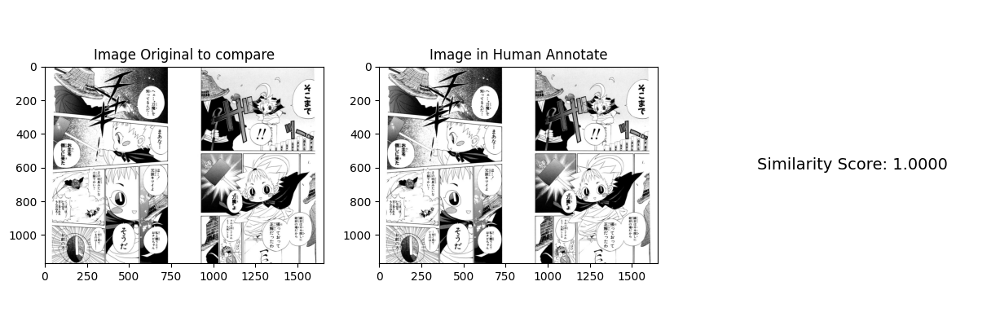

Processing original images:   9%|▊         | 51/588 [04:38<40:17,  4.50s/it]

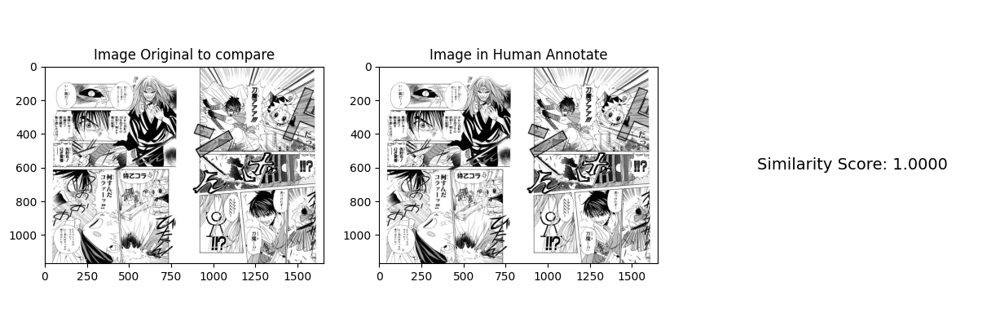

Processing original images:  11%|█         | 64/588 [05:51<47:02,  5.39s/it]

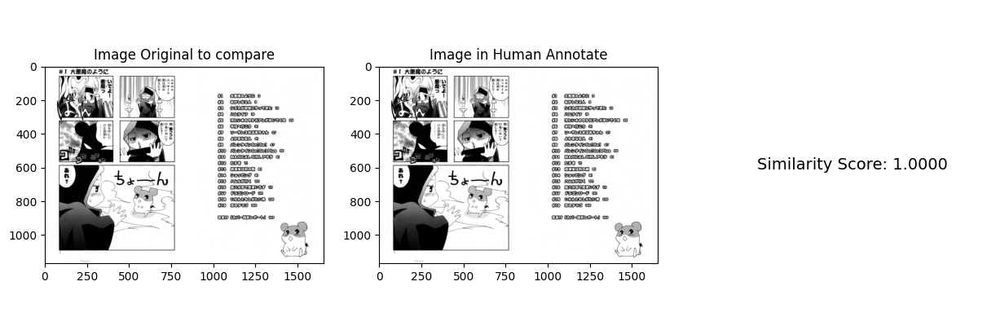

Processing original images:  11%|█         | 65/588 [05:52<35:01,  4.02s/it]

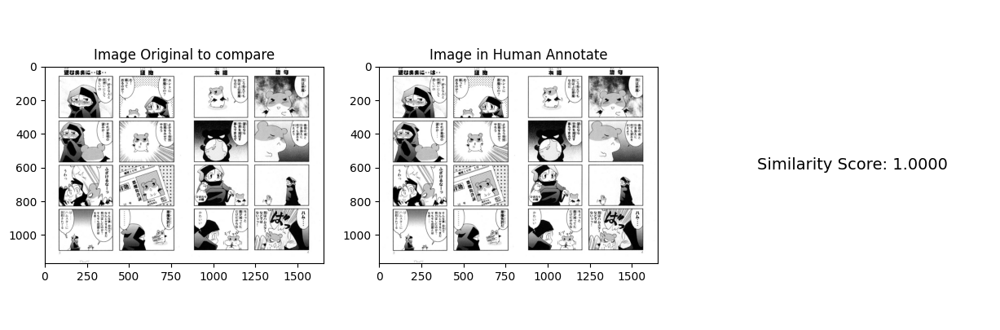

Processing original images:  11%|█         | 66/588 [05:53<27:56,  3.21s/it]

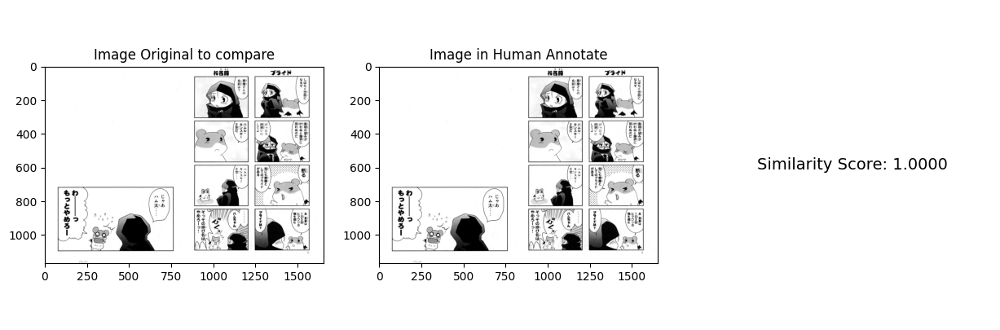

Processing original images:  11%|█▏        | 67/588 [05:55<24:09,  2.78s/it]

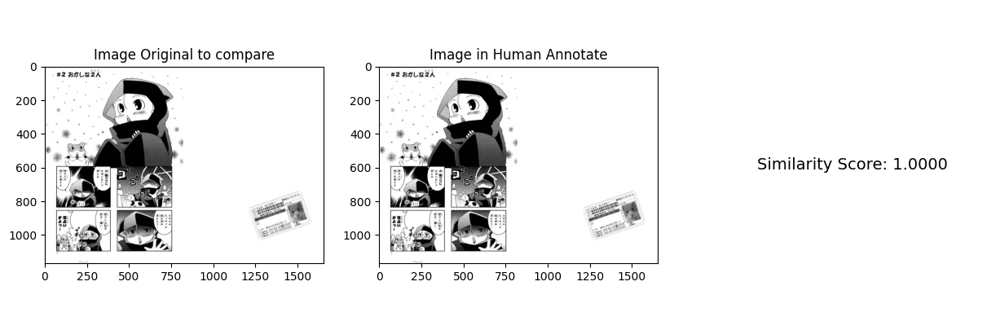

Processing original images:  12%|█▏        | 68/588 [05:57<22:42,  2.62s/it]

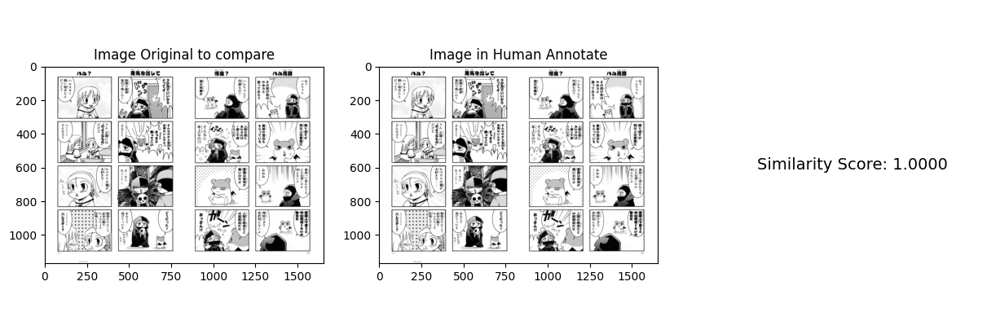

Processing original images:  12%|█▏        | 69/588 [06:00<24:06,  2.79s/it]

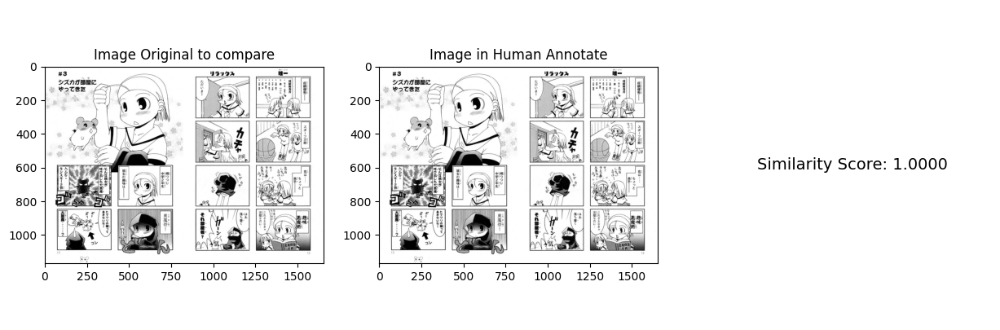

Processing original images:  12%|█▏        | 70/588 [06:04<26:44,  3.10s/it]

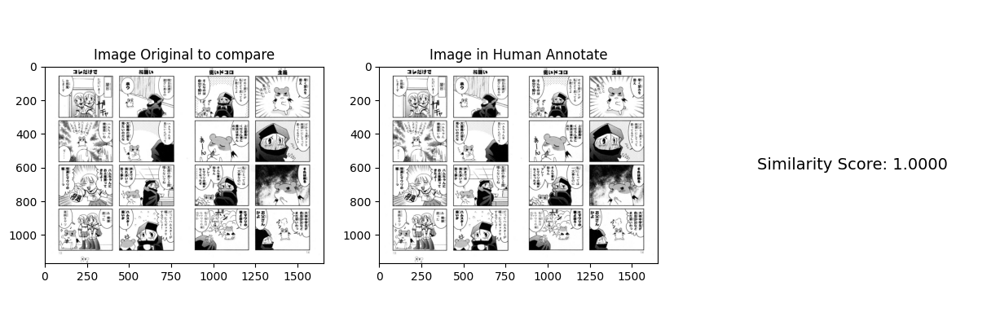

Processing original images:  12%|█▏        | 71/588 [06:09<31:17,  3.63s/it]

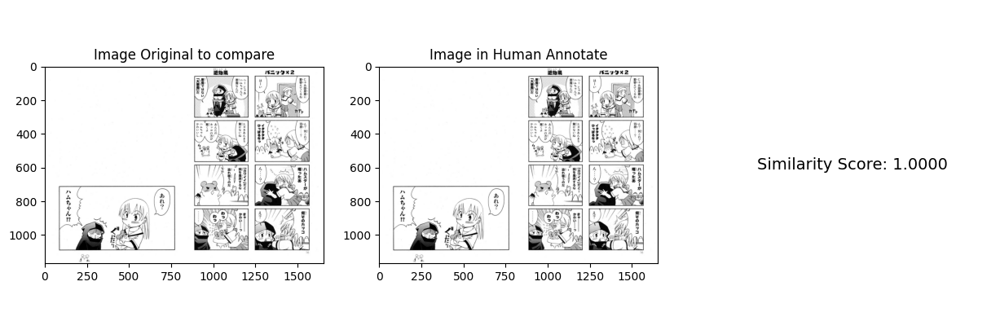

Processing original images:  12%|█▏        | 72/588 [06:14<35:13,  4.10s/it]

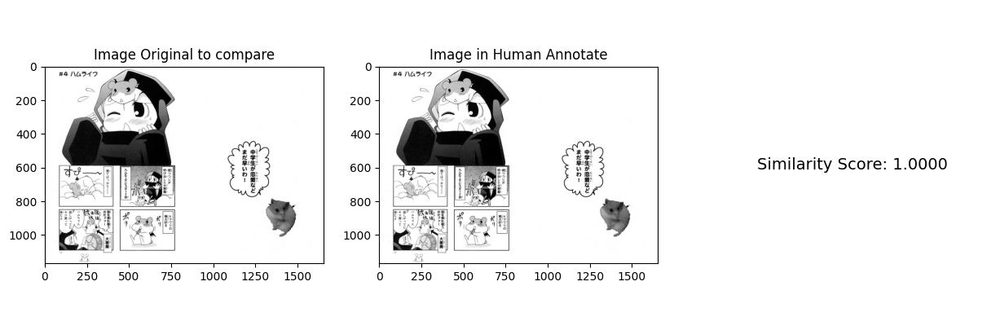

Processing original images:  15%|█▍        | 88/588 [07:24<35:23,  4.25s/it]

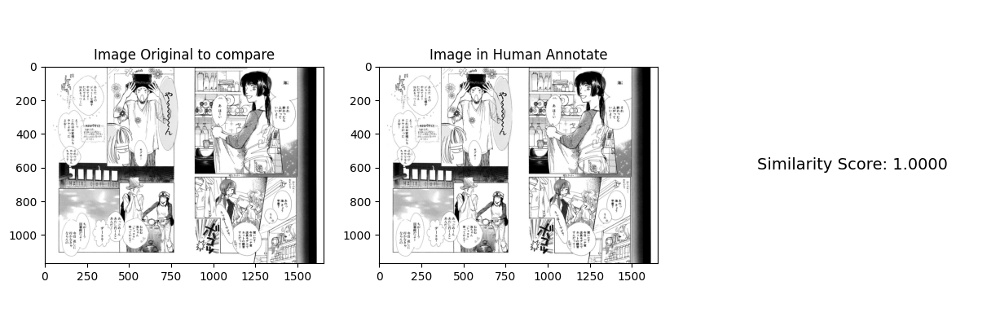

Processing original images:  15%|█▌        | 89/588 [07:26<29:27,  3.54s/it]

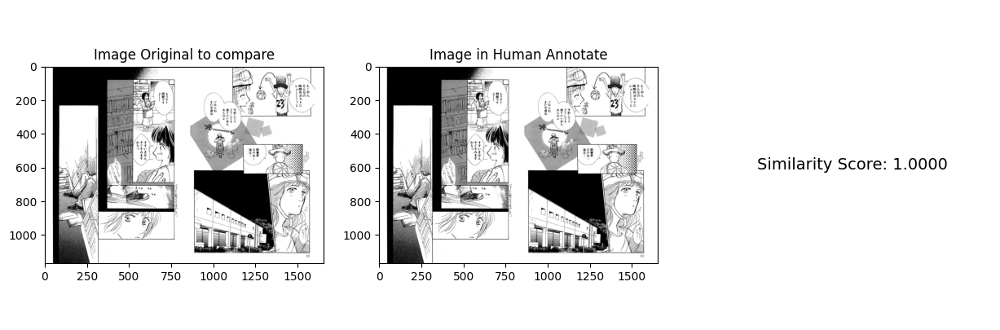

Processing original images:  15%|█▌        | 90/588 [07:29<27:33,  3.32s/it]

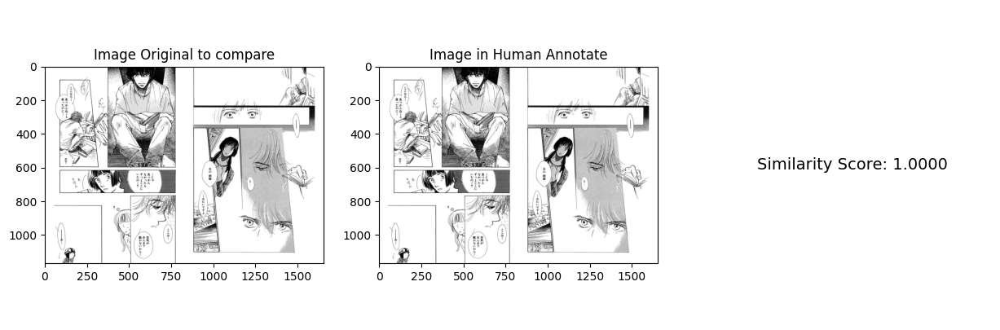

Processing original images:  15%|█▌        | 91/588 [07:32<27:02,  3.26s/it]

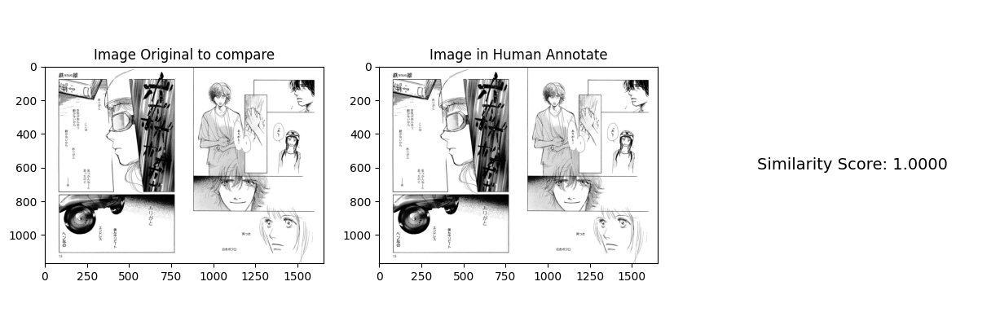

Processing original images:  16%|█▌        | 92/588 [07:35<27:32,  3.33s/it]

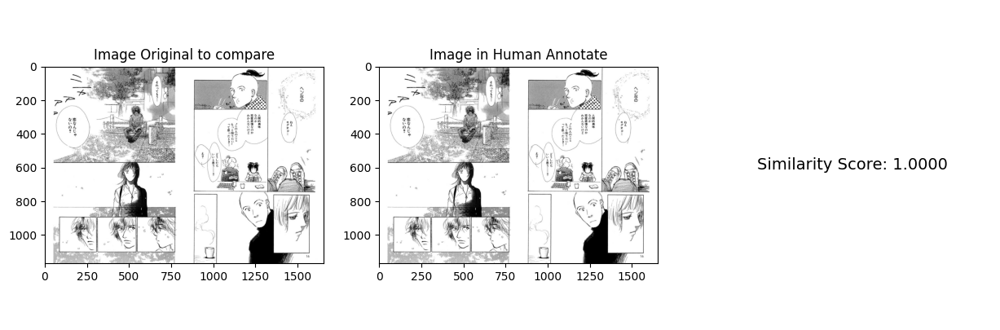

Processing original images:  16%|█▌        | 93/588 [07:39<29:36,  3.59s/it]

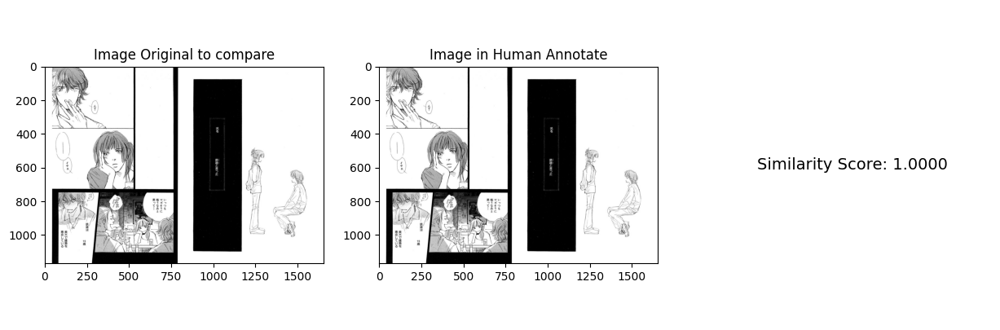

Processing original images:  18%|█▊        | 106/588 [08:33<33:30,  4.17s/it]

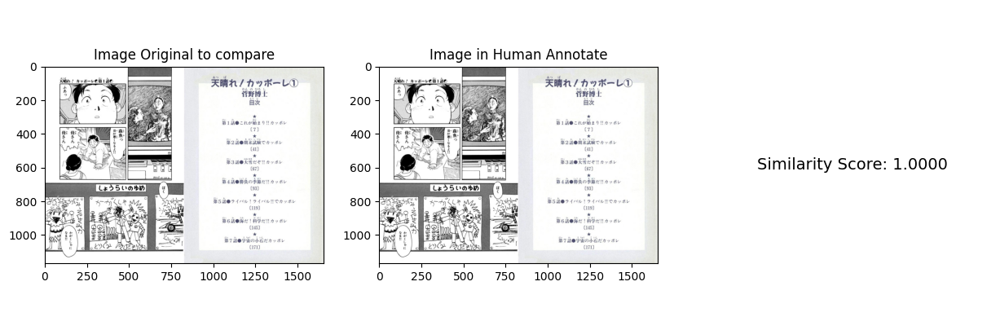

Processing original images:  18%|█▊        | 107/588 [08:34<25:27,  3.18s/it]

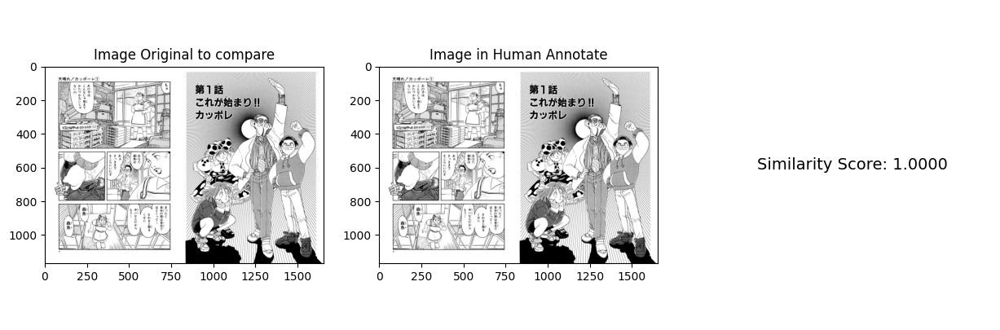

Processing original images:  18%|█▊        | 108/588 [08:35<19:57,  2.49s/it]

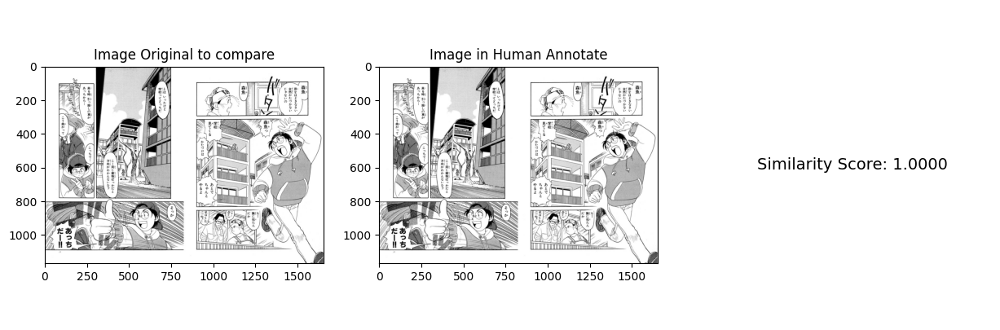

Processing original images:  19%|█▊        | 109/588 [08:37<18:16,  2.29s/it]

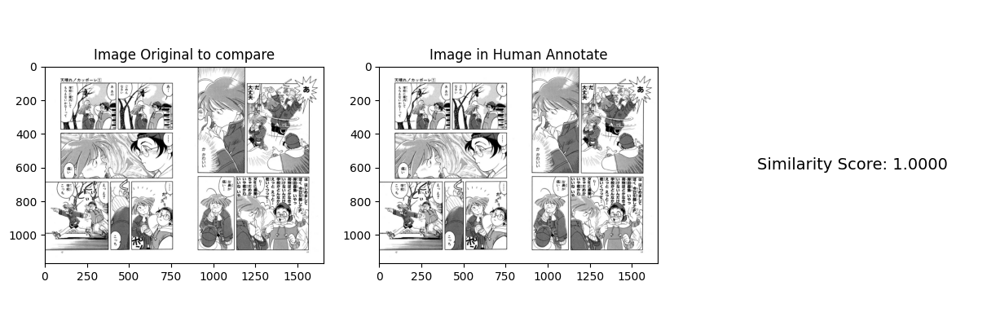

Processing original images:  19%|█▊        | 110/588 [08:39<17:38,  2.22s/it]

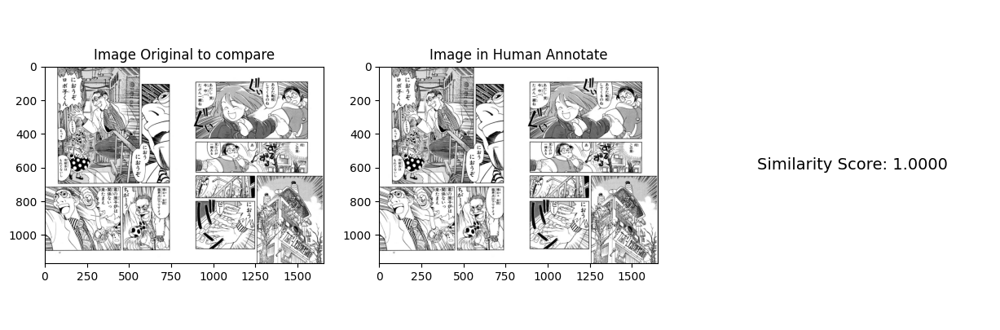

Processing original images:  19%|█▉        | 111/588 [08:42<19:07,  2.40s/it]

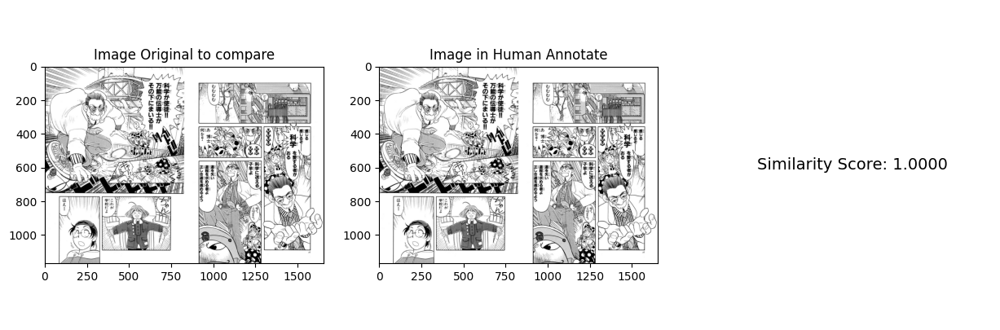

Processing original images:  19%|█▉        | 112/588 [08:45<21:21,  2.69s/it]

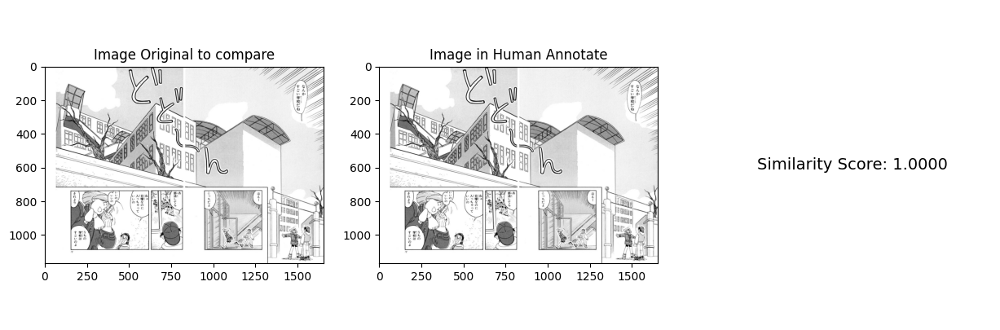

Processing original images:  19%|█▉        | 113/588 [08:49<23:28,  2.97s/it]

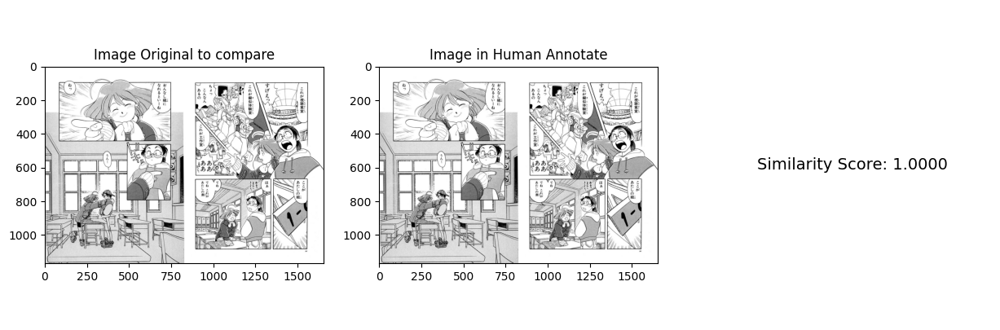

Processing original images:  19%|█▉        | 114/588 [08:53<26:56,  3.41s/it]

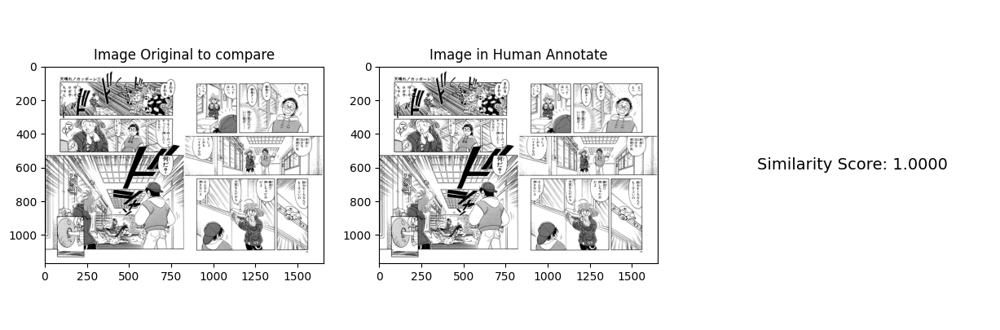

Processing original images:  22%|██▏       | 128/588 [09:54<31:21,  4.09s/it]

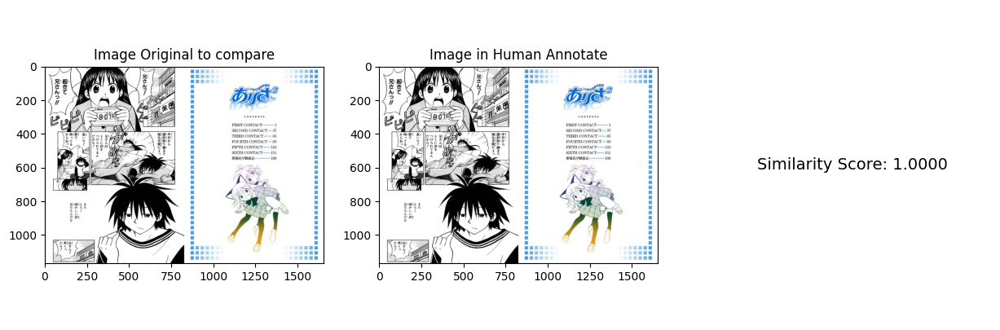

Processing original images:  22%|██▏       | 129/588 [09:55<24:09,  3.16s/it]

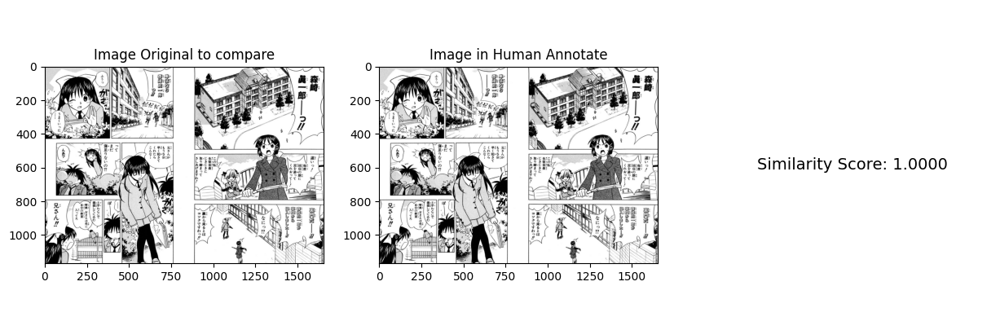

Processing original images:  22%|██▏       | 130/588 [09:56<21:09,  2.77s/it]

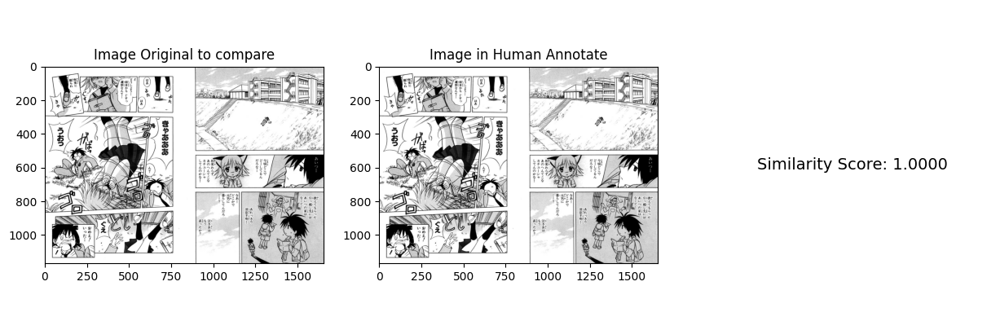

Processing original images:  22%|██▏       | 131/588 [09:59<20:00,  2.63s/it]

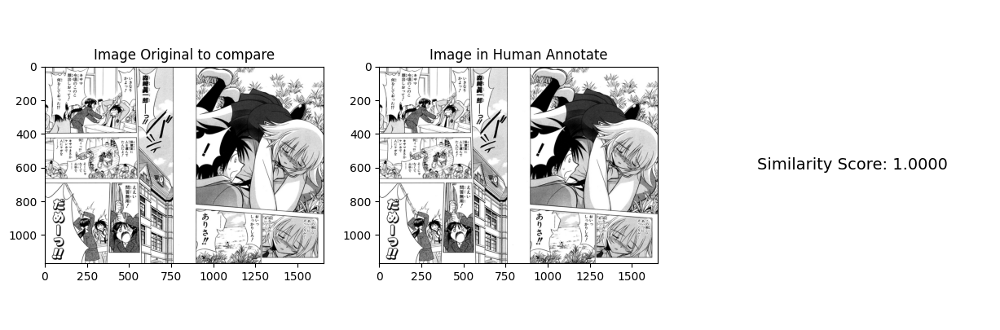

Processing original images:  22%|██▏       | 132/588 [10:01<20:21,  2.68s/it]

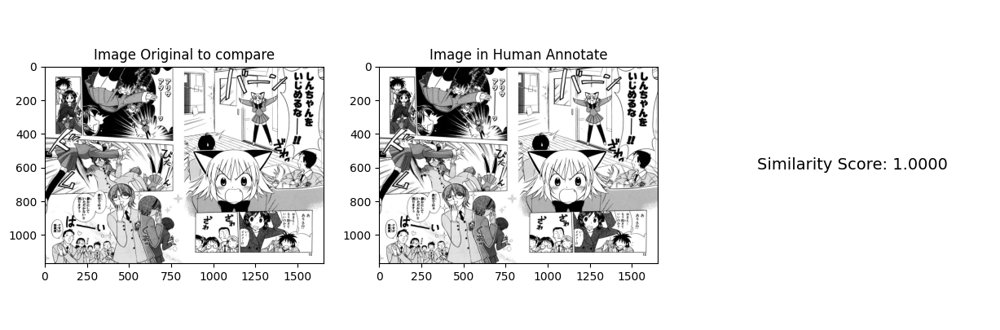

Processing original images:  23%|██▎       | 133/588 [10:04<20:49,  2.75s/it]

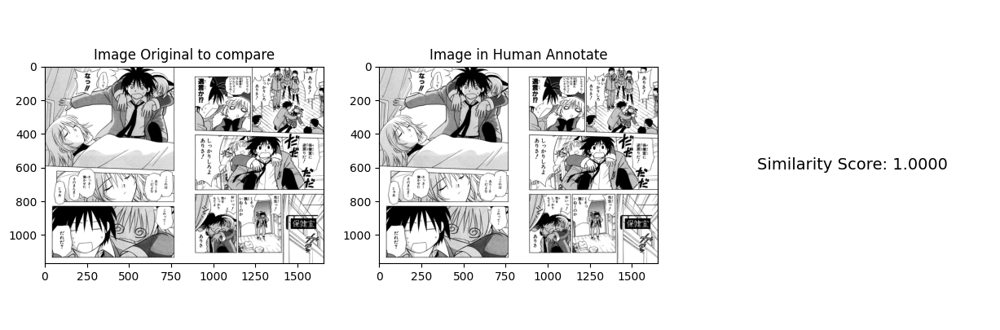

Processing original images:  23%|██▎       | 134/588 [10:08<23:08,  3.06s/it]

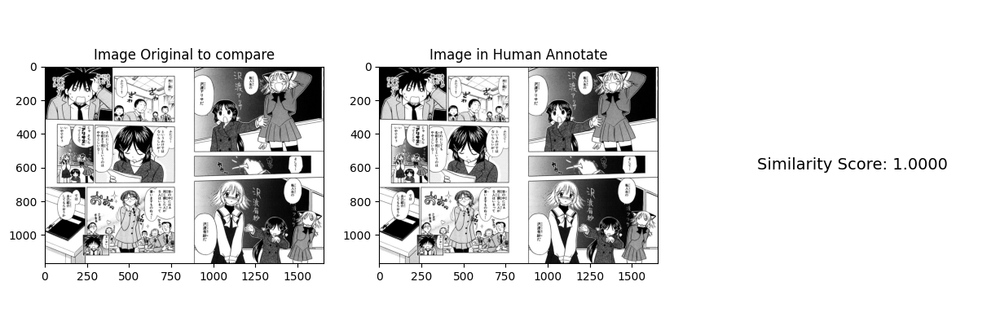

Processing original images:  23%|██▎       | 135/588 [10:12<25:20,  3.36s/it]

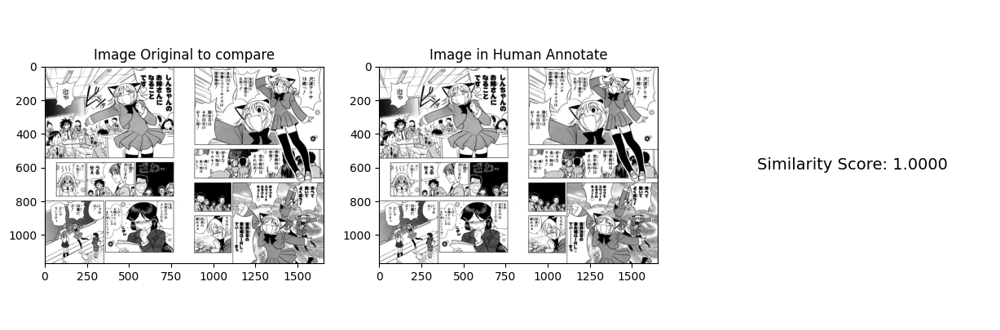

Processing original images:  26%|██▌       | 151/588 [11:20<30:14,  4.15s/it]

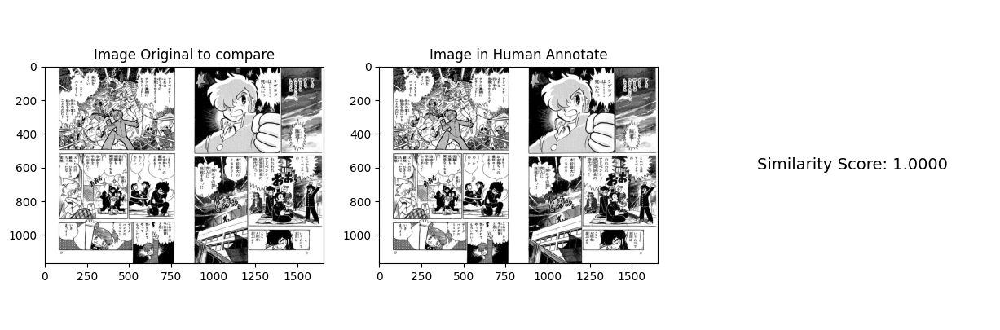

Processing original images:  26%|██▌       | 152/588 [11:22<25:30,  3.51s/it]

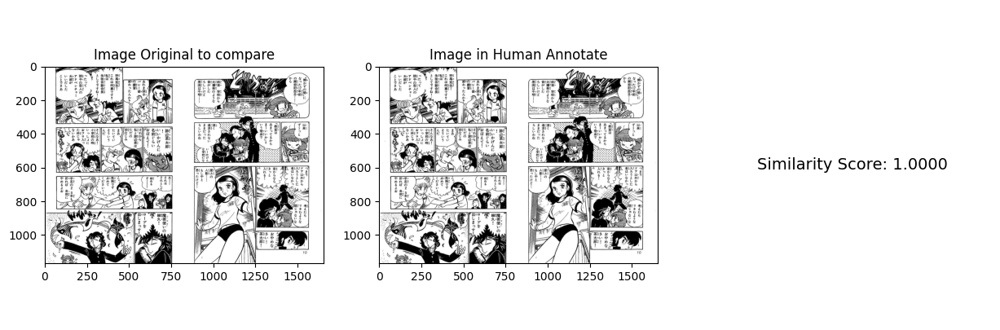

Processing original images:  26%|██▌       | 153/588 [11:25<23:41,  3.27s/it]

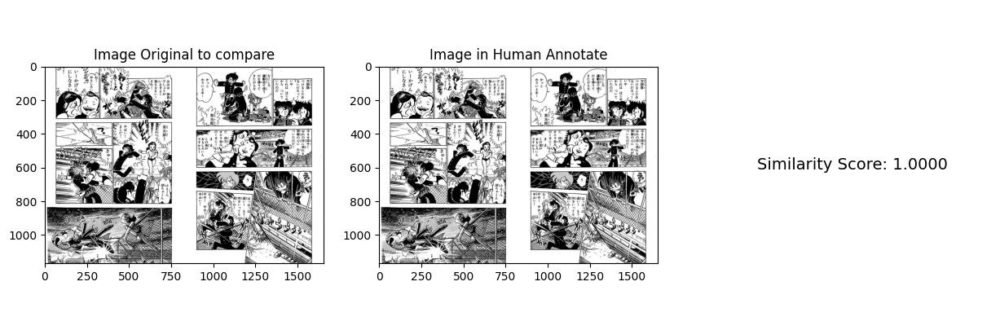

Processing original images:  26%|██▌       | 154/588 [11:28<23:27,  3.24s/it]

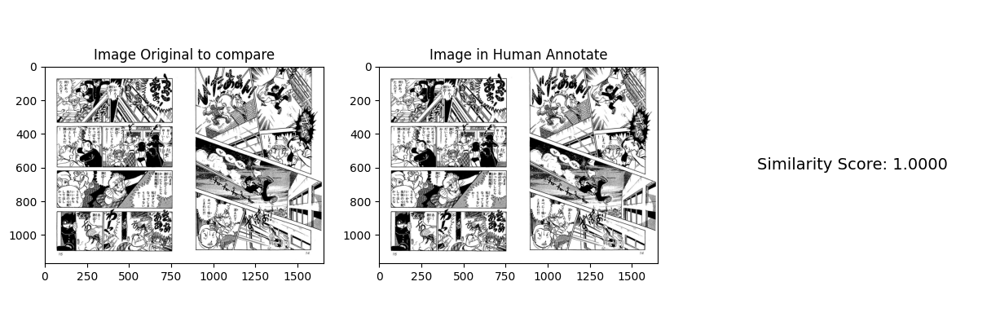

Processing original images:  26%|██▋       | 155/588 [11:32<24:35,  3.41s/it]

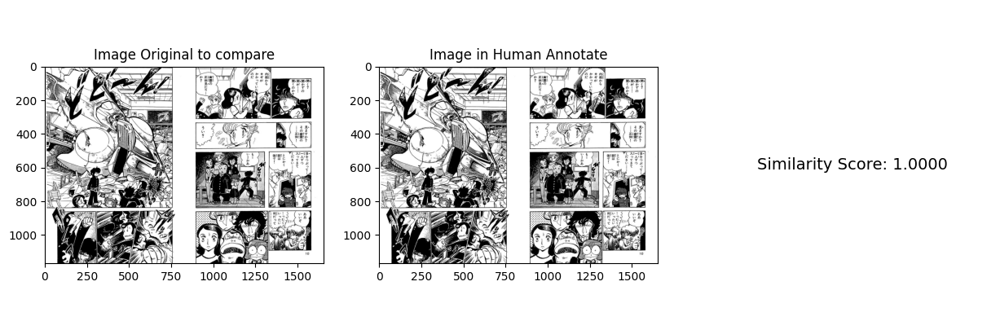

Processing original images:  27%|██▋       | 156/588 [11:36<25:46,  3.58s/it]

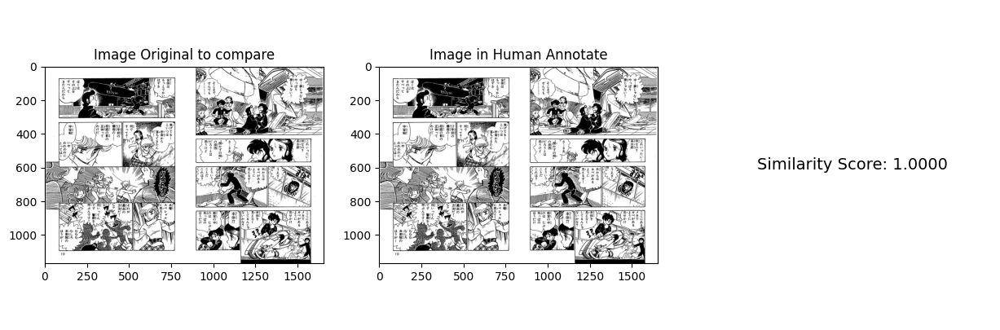

Processing original images:  29%|██▉       | 170/588 [12:33<27:09,  3.90s/it]

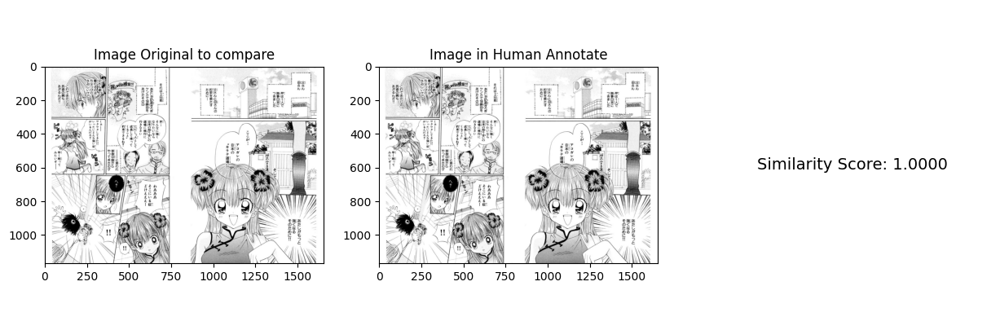

Processing original images:  29%|██▉       | 171/588 [12:34<20:44,  2.99s/it]

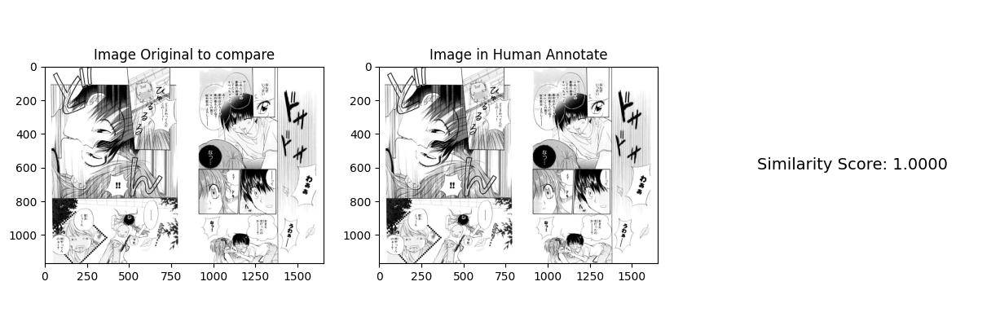

Processing original images:  29%|██▉       | 172/588 [12:36<18:20,  2.64s/it]

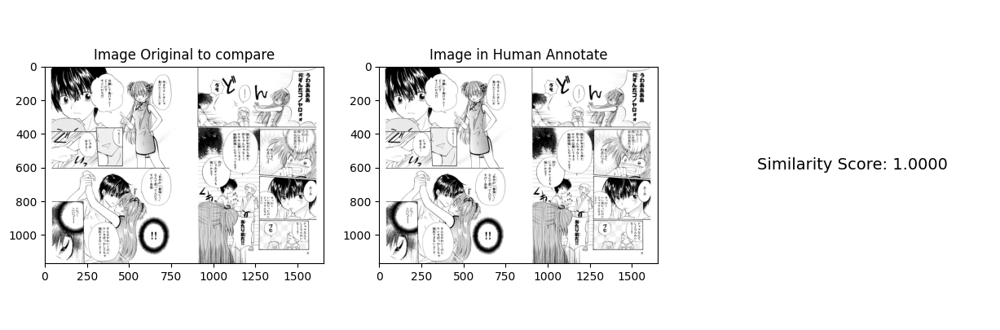

Processing original images:  29%|██▉       | 173/588 [12:38<17:02,  2.46s/it]

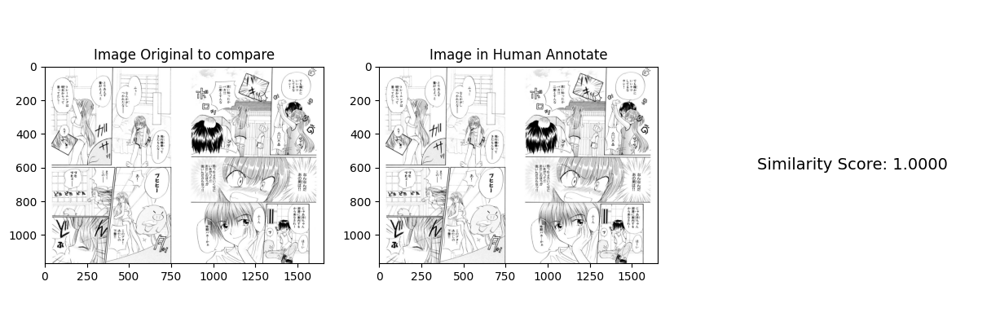

Processing original images:  30%|██▉       | 174/588 [12:40<16:41,  2.42s/it]

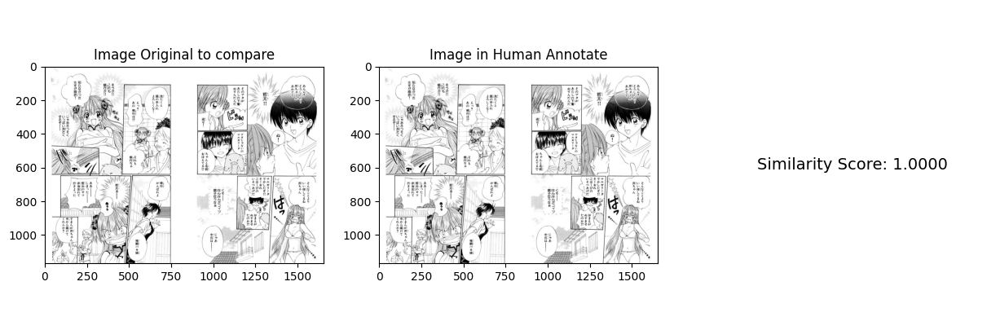

Processing original images:  30%|██▉       | 175/588 [12:43<17:20,  2.52s/it]

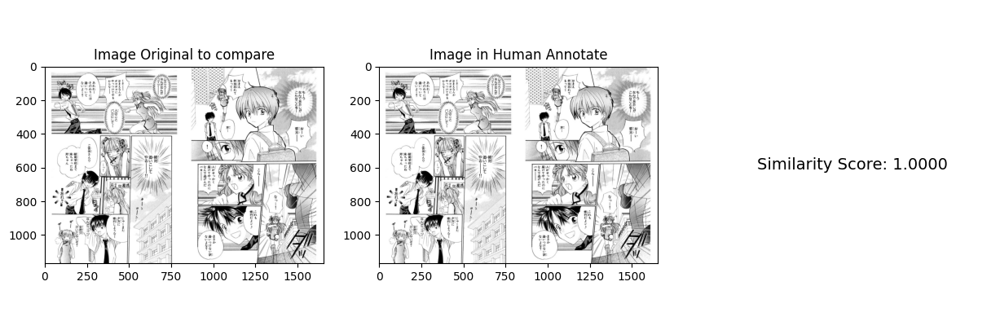

Processing original images:  30%|██▉       | 176/588 [12:47<19:58,  2.91s/it]

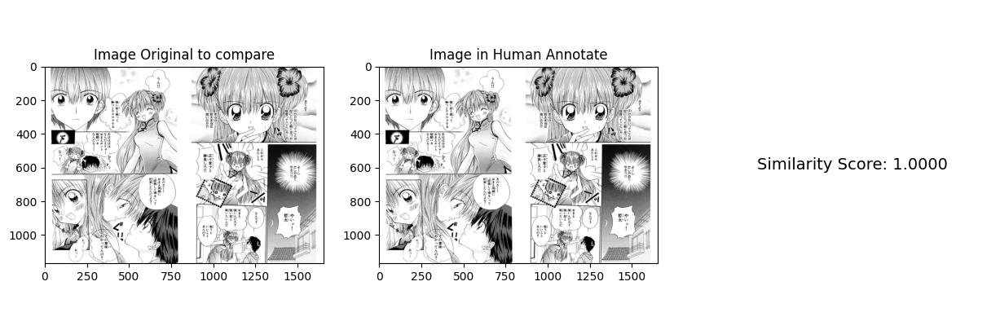

Processing original images:  30%|███       | 177/588 [12:51<22:21,  3.26s/it]

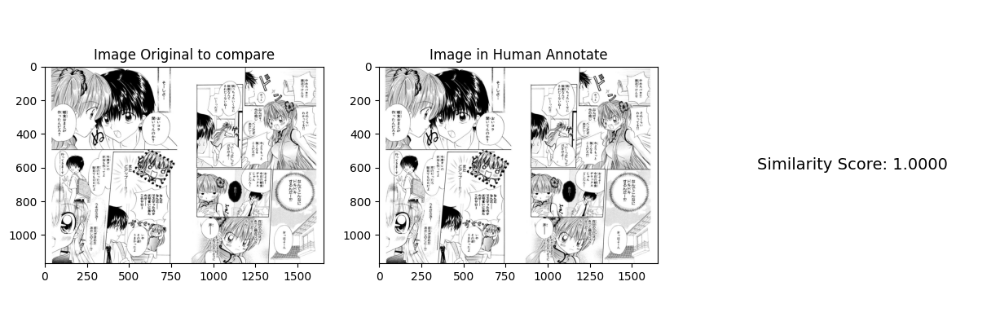

Processing original images:  32%|███▏      | 190/588 [13:39<23:50,  3.59s/it]

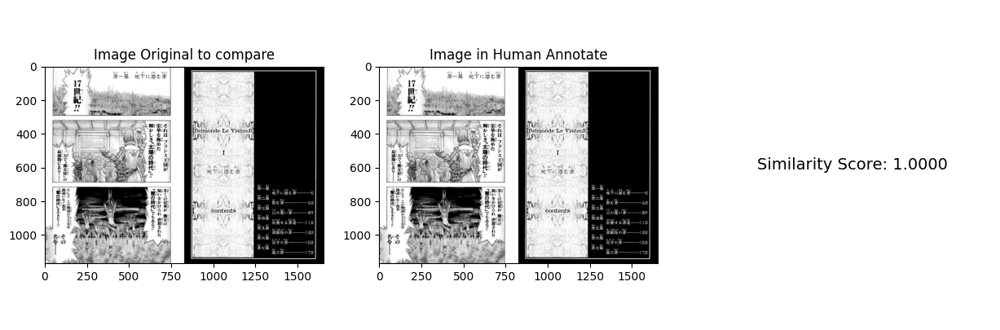

Processing original images:  32%|███▏      | 191/588 [13:40<17:57,  2.71s/it]

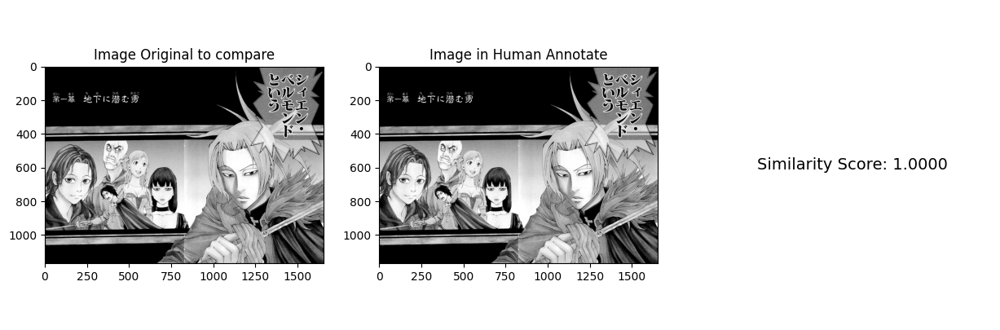

Processing original images:  33%|███▎      | 192/588 [13:41<14:13,  2.15s/it]

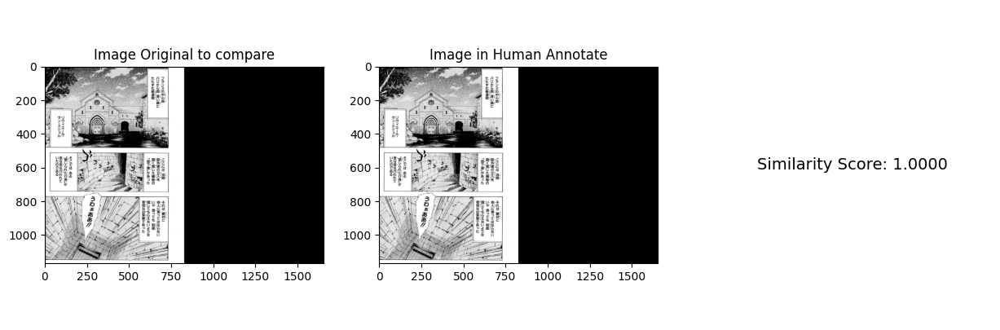

Processing original images:  33%|███▎      | 193/588 [13:42<12:50,  1.95s/it]

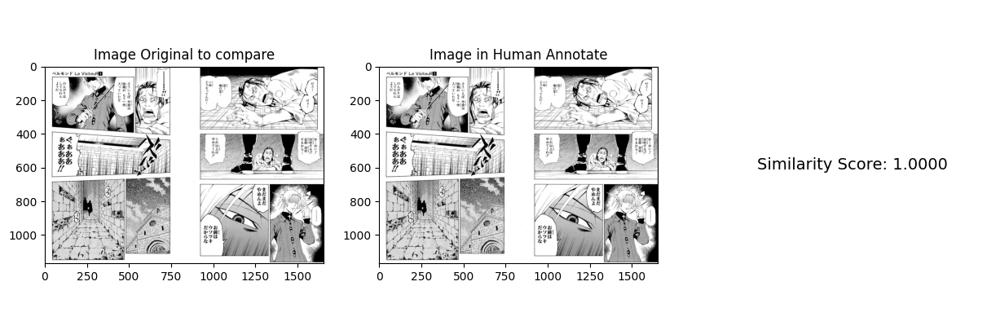

Processing original images:  33%|███▎      | 194/588 [13:44<12:45,  1.94s/it]

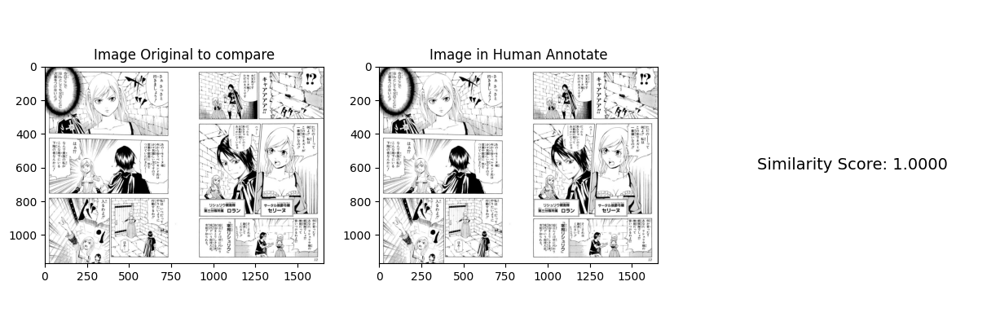

Processing original images:  33%|███▎      | 195/588 [13:47<13:17,  2.03s/it]

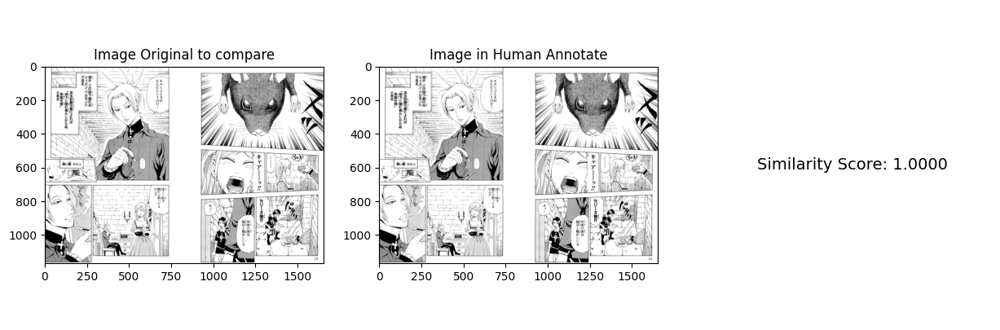

Processing original images:  33%|███▎      | 196/588 [13:49<14:37,  2.24s/it]

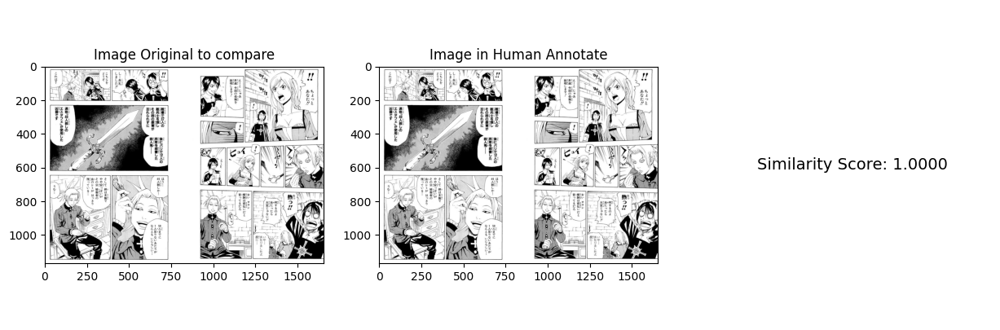

Processing original images:  34%|███▎      | 197/588 [13:52<16:05,  2.47s/it]

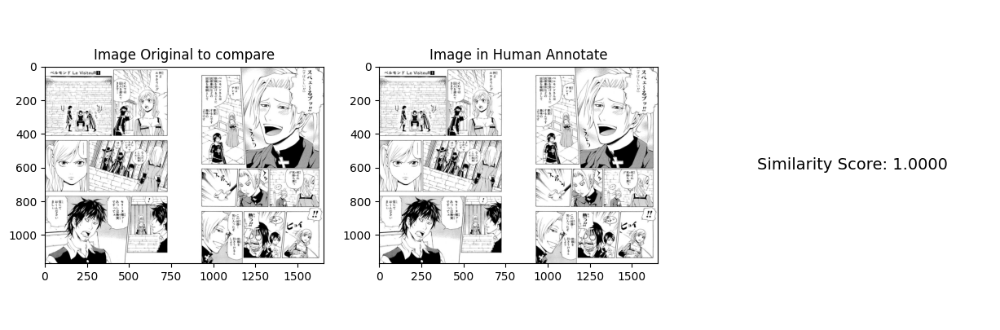

Processing original images:  34%|███▎      | 198/588 [13:56<18:00,  2.77s/it]

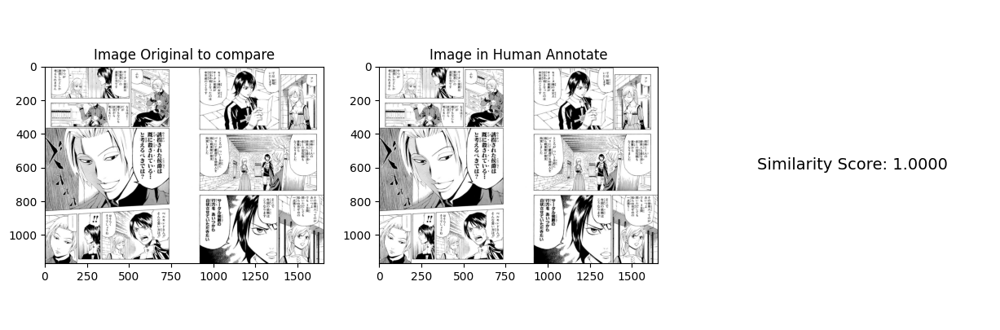

Processing original images:  36%|███▌      | 211/588 [14:44<23:37,  3.76s/it]

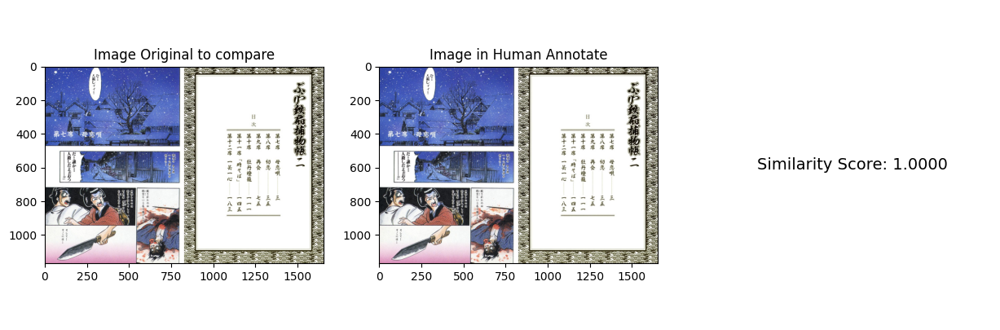

Processing original images:  36%|███▌      | 212/588 [14:44<18:02,  2.88s/it]

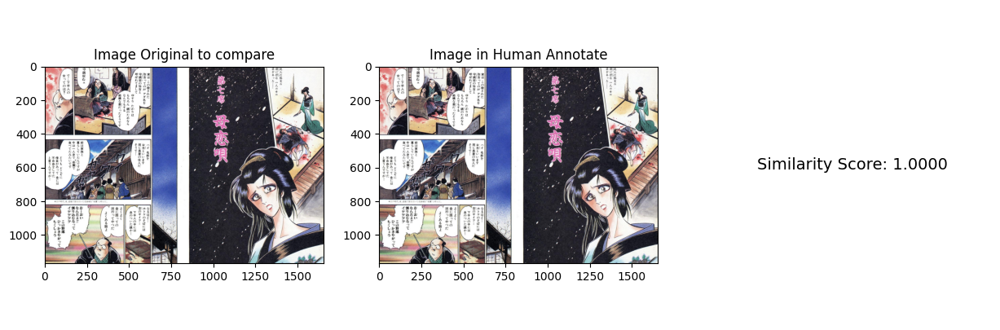

Processing original images:  36%|███▌      | 213/588 [14:46<14:54,  2.38s/it]

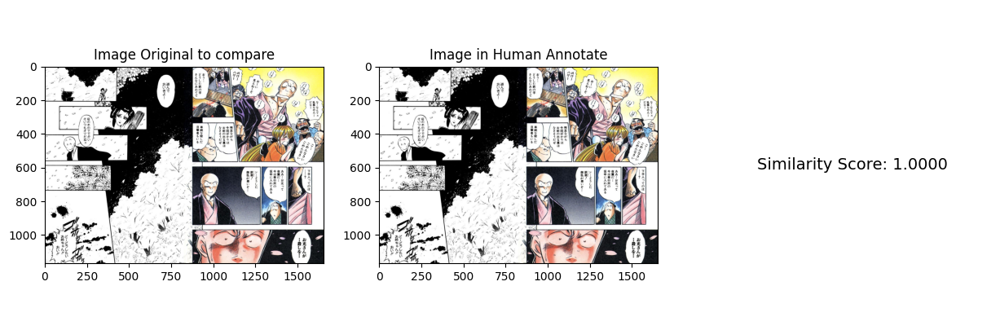

Processing original images:  36%|███▋      | 214/588 [14:47<12:38,  2.03s/it]

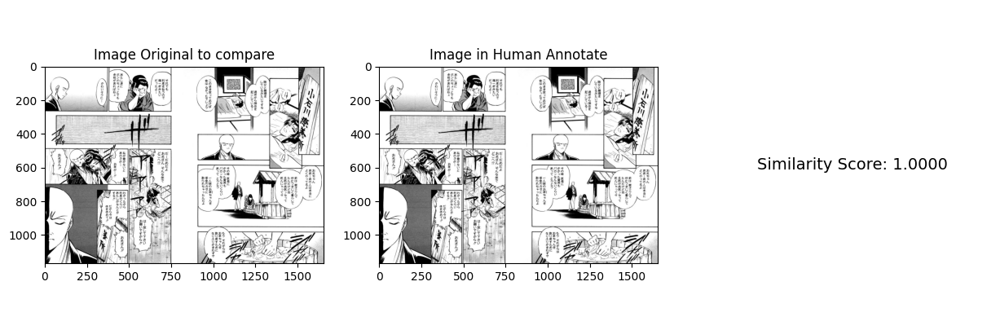

Processing original images:  37%|███▋      | 215/588 [14:48<11:55,  1.92s/it]

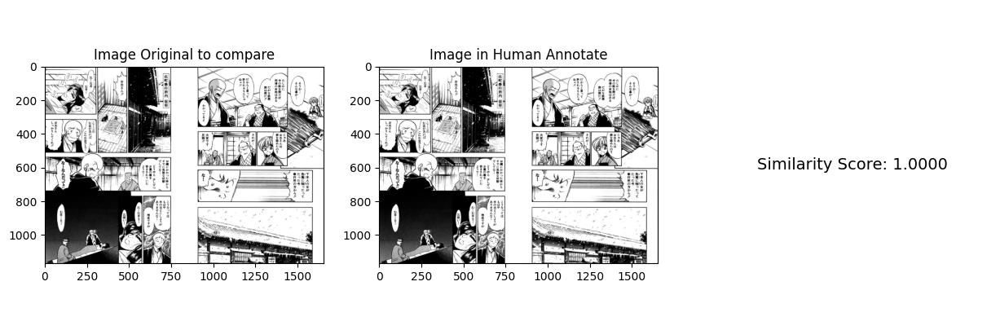

Processing original images:  37%|███▋      | 216/588 [14:50<11:53,  1.92s/it]

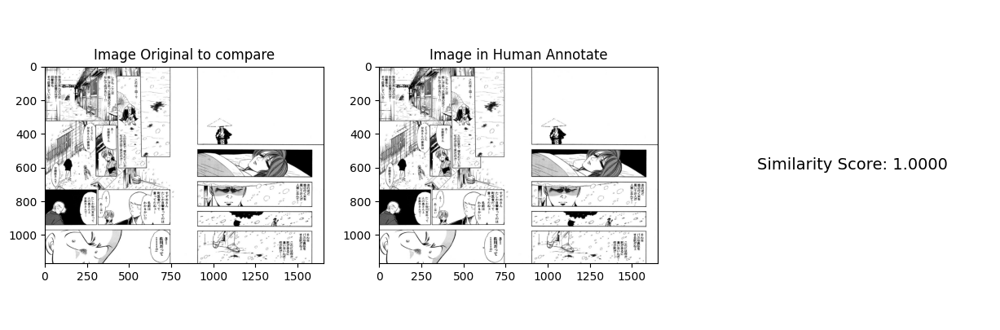

Processing original images:  37%|███▋      | 217/588 [14:53<12:31,  2.03s/it]

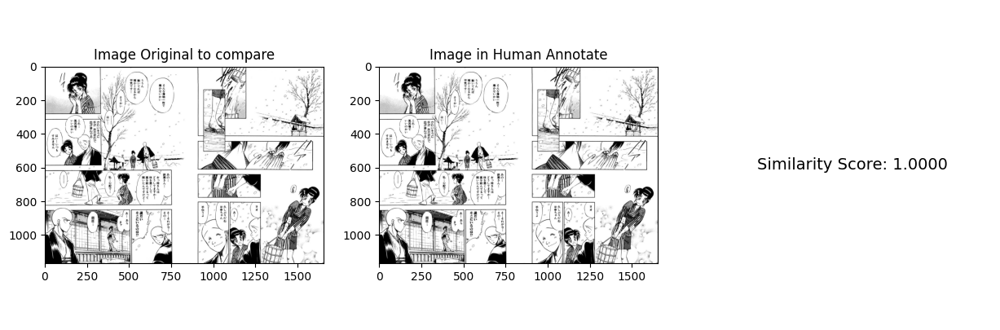

Processing original images:  37%|███▋      | 218/588 [14:55<13:50,  2.25s/it]

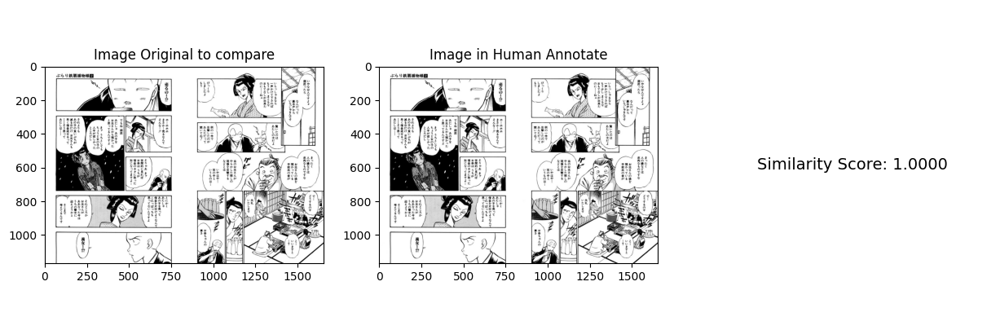

Processing original images:  37%|███▋      | 219/588 [14:59<15:42,  2.56s/it]

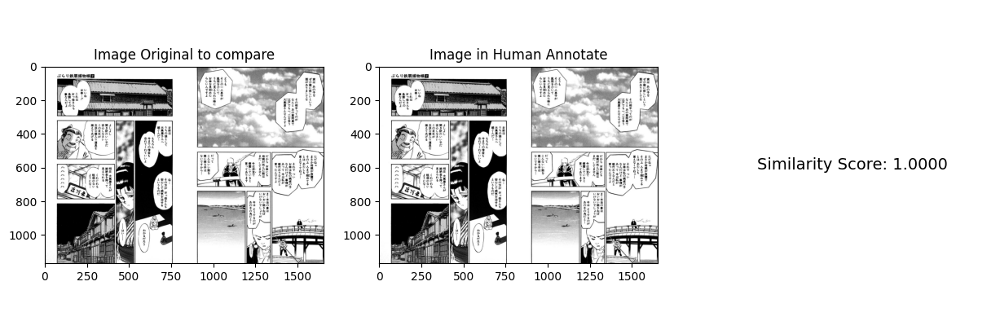

Processing original images:  40%|███▉      | 233/588 [15:43<17:50,  3.02s/it]

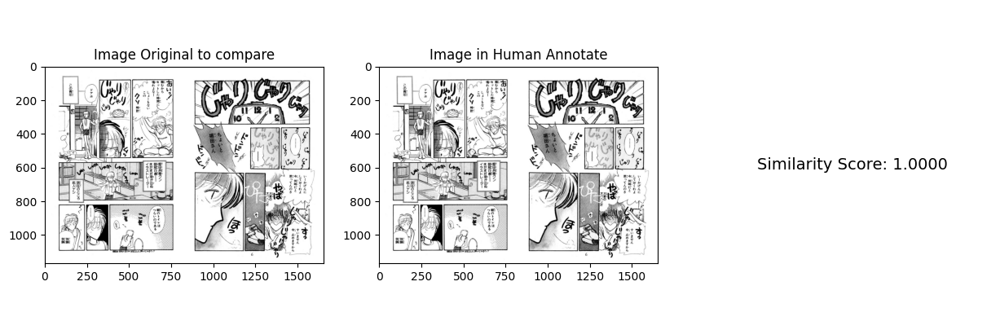

Processing original images:  40%|███▉      | 234/588 [15:44<14:18,  2.43s/it]

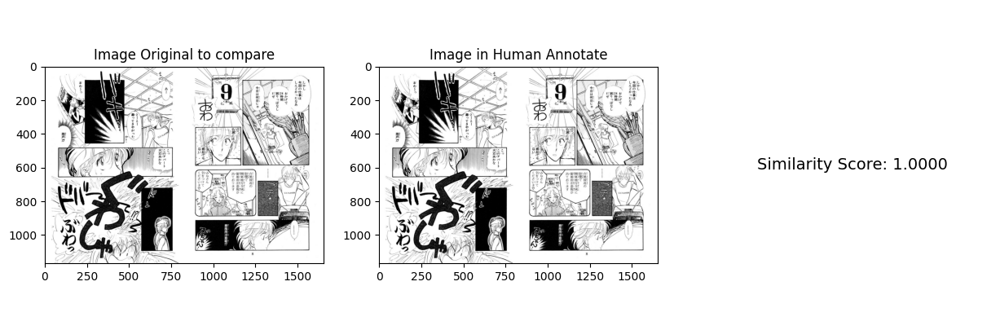

Processing original images:  40%|███▉      | 235/588 [15:45<12:18,  2.09s/it]

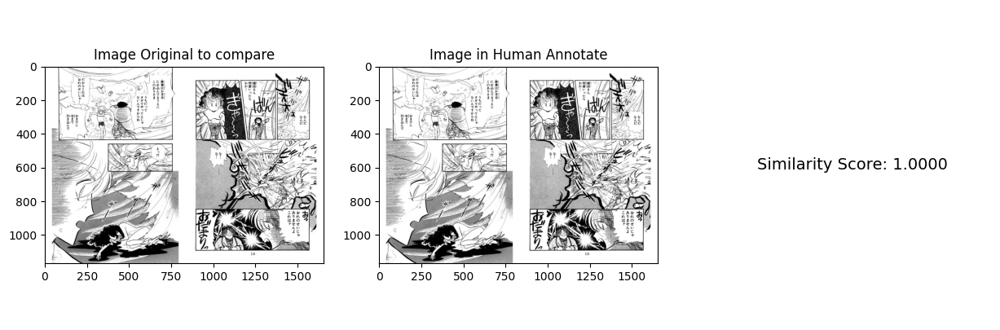

Processing original images:  40%|████      | 236/588 [15:47<11:26,  1.95s/it]

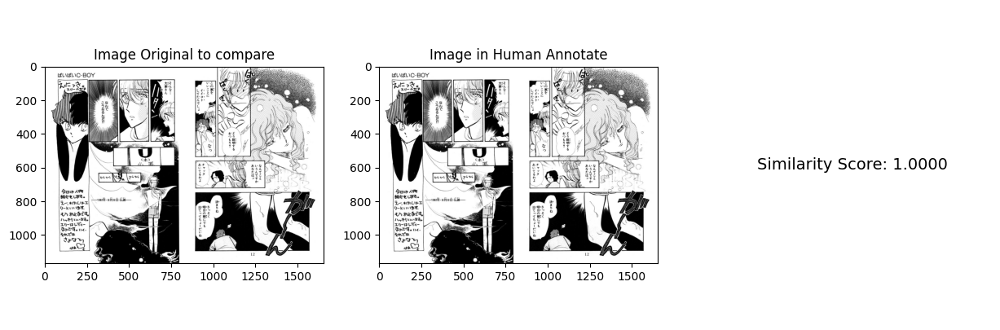

Processing original images:  40%|████      | 237/588 [15:49<11:16,  1.93s/it]

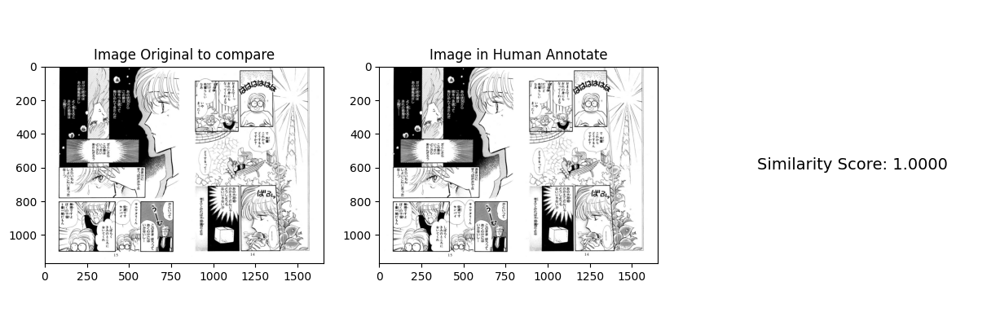

Processing original images:  40%|████      | 238/588 [15:51<12:07,  2.08s/it]

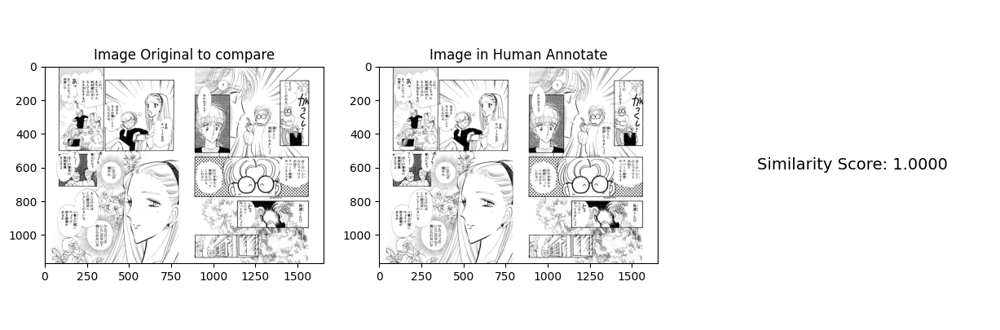

Processing original images:  41%|████      | 239/588 [15:54<12:47,  2.20s/it]

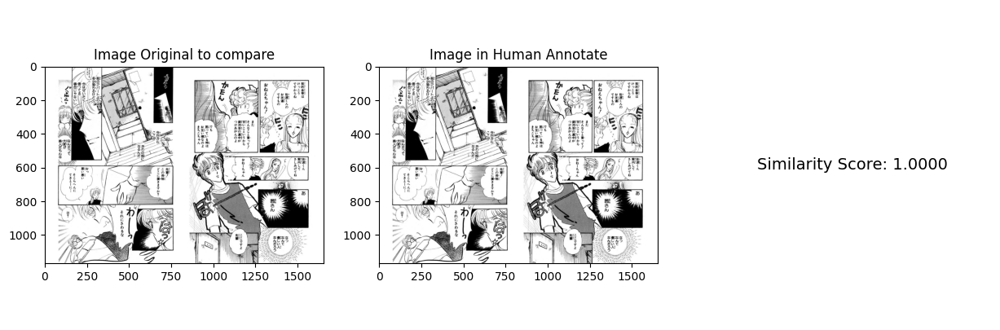

Processing original images:  41%|████      | 240/588 [15:56<14:03,  2.42s/it]

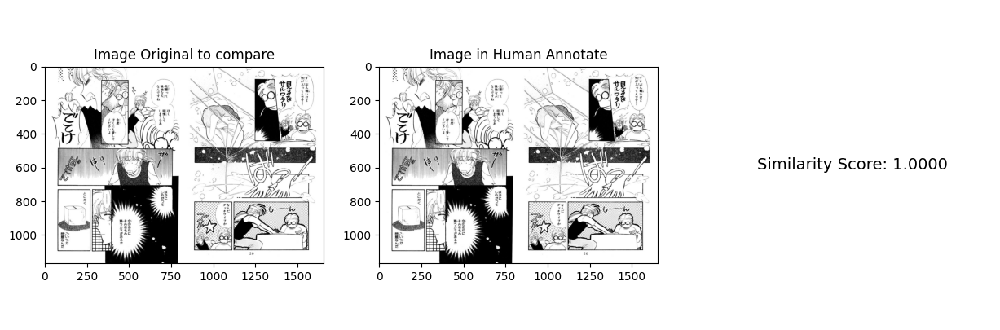

Processing original images:  43%|████▎     | 252/588 [16:34<17:10,  3.07s/it]

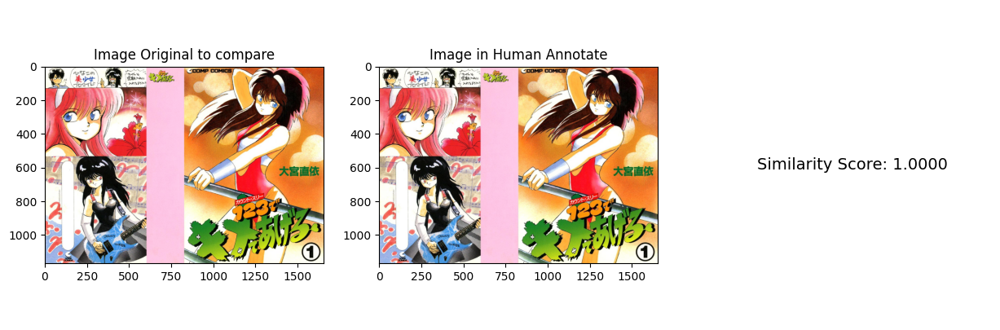

Processing original images:  43%|████▎     | 255/588 [16:41<14:30,  2.61s/it]

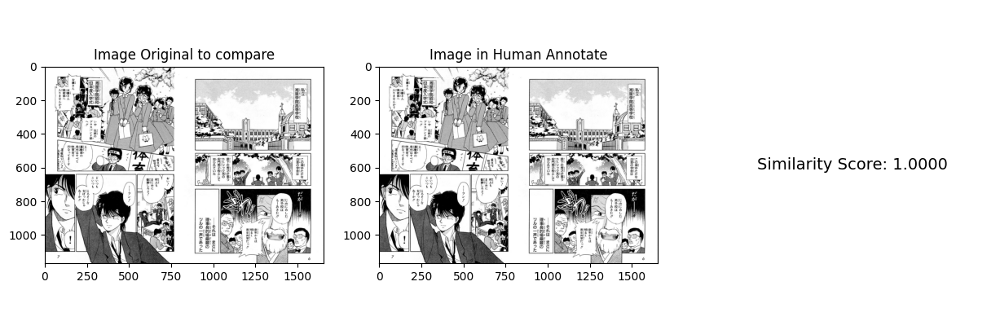

Processing original images:  44%|████▎     | 256/588 [16:42<11:57,  2.16s/it]

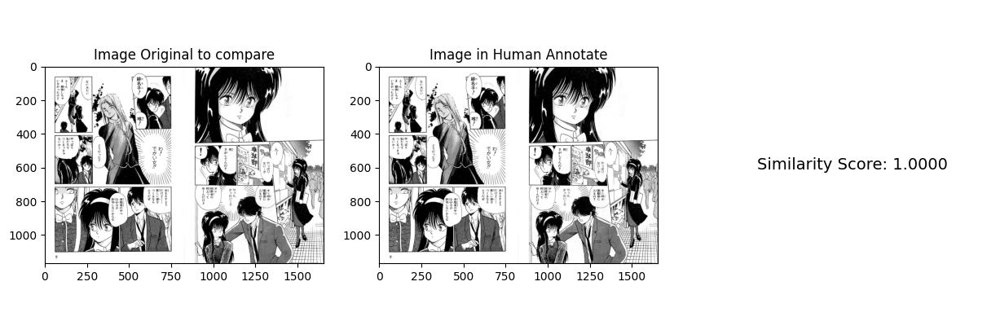

Processing original images:  44%|████▎     | 257/588 [16:43<11:10,  2.02s/it]

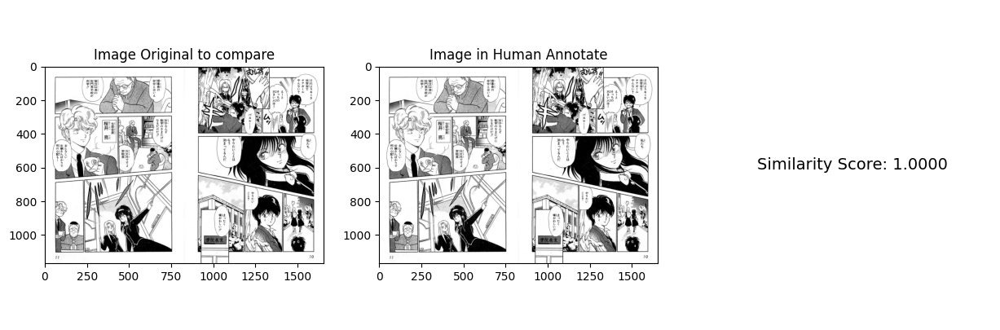

Processing original images:  44%|████▍     | 258/588 [16:45<10:42,  1.95s/it]

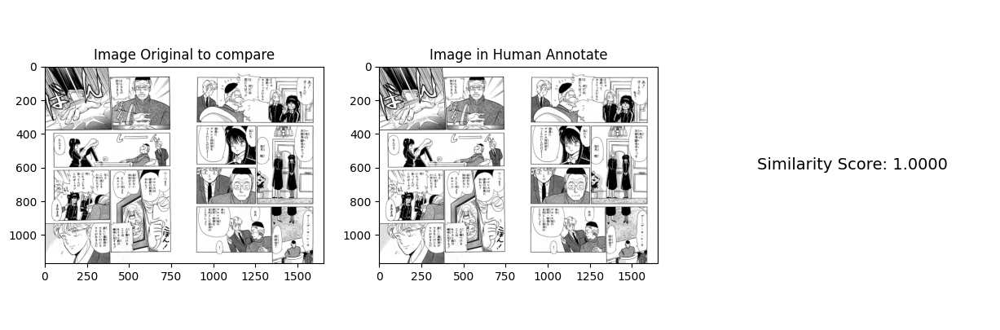

Processing original images:  44%|████▍     | 259/588 [16:47<11:12,  2.04s/it]

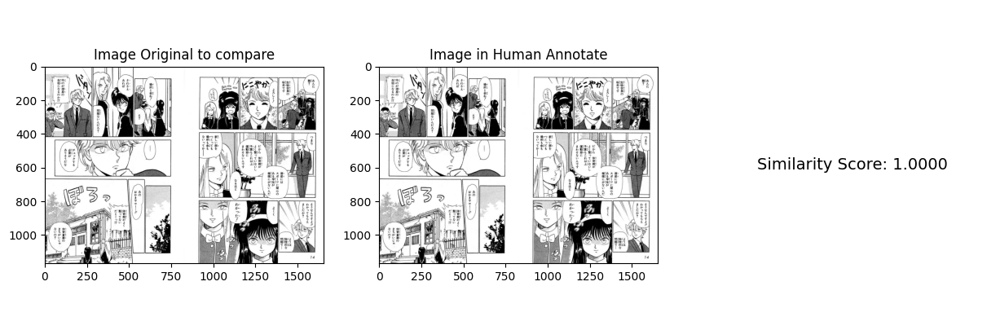

Processing original images:  44%|████▍     | 260/588 [16:50<11:56,  2.18s/it]

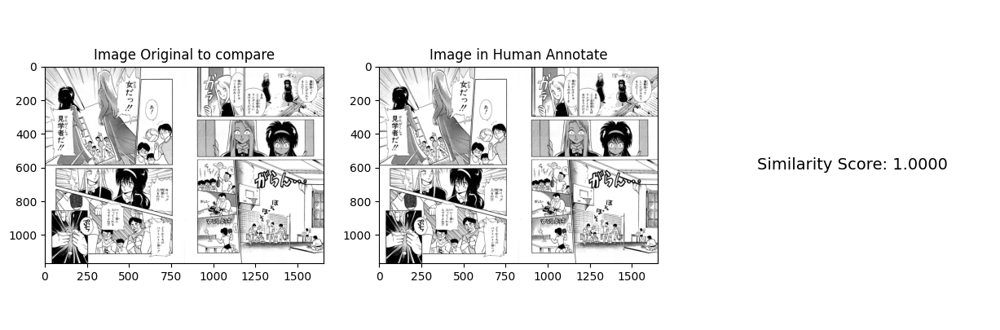

Processing original images:  44%|████▍     | 261/588 [16:53<13:44,  2.52s/it]

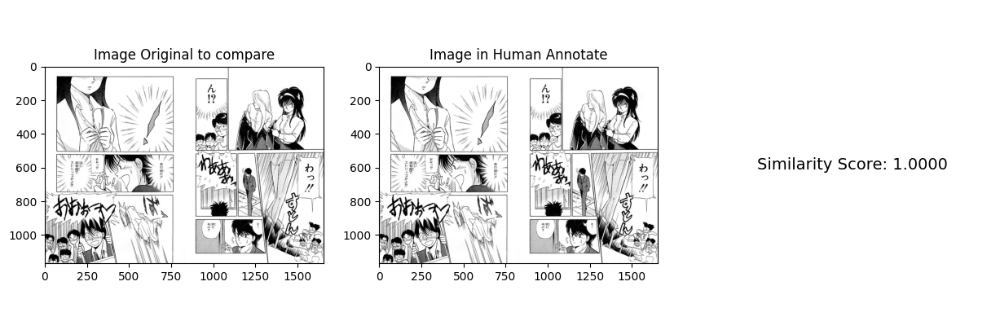

Processing original images:  47%|████▋     | 275/588 [17:35<15:33,  2.98s/it]

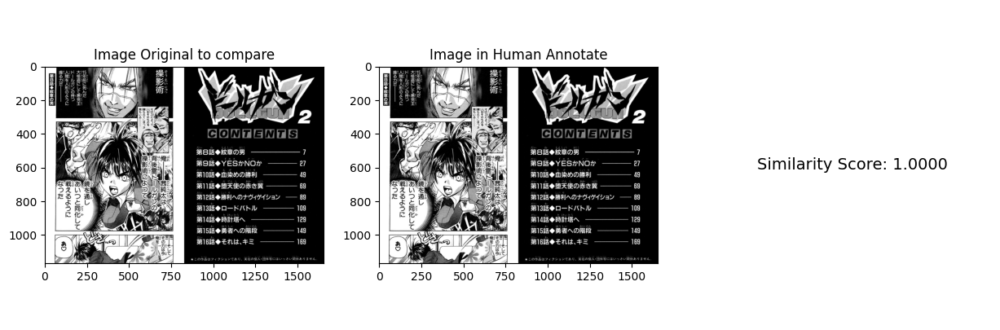

Processing original images:  47%|████▋     | 276/588 [17:36<12:16,  2.36s/it]

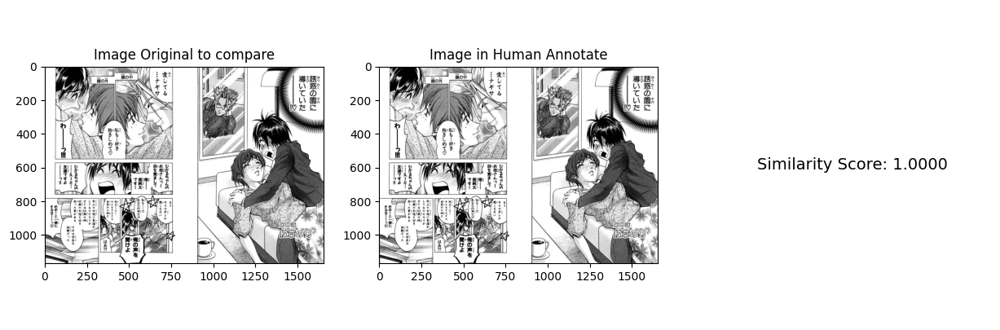

Processing original images:  47%|████▋     | 277/588 [17:37<10:23,  2.00s/it]

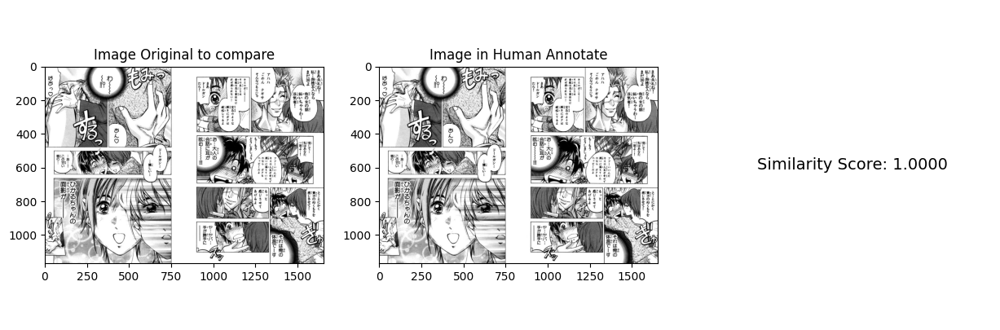

Processing original images:  47%|████▋     | 278/588 [17:39<09:46,  1.89s/it]

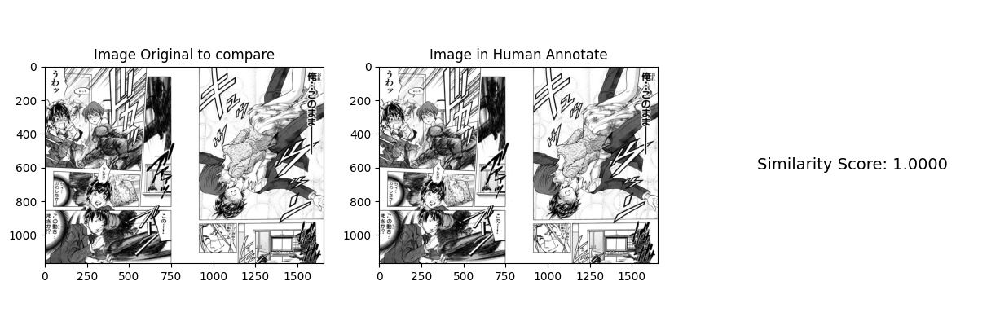

Processing original images:  47%|████▋     | 279/588 [17:40<09:44,  1.89s/it]

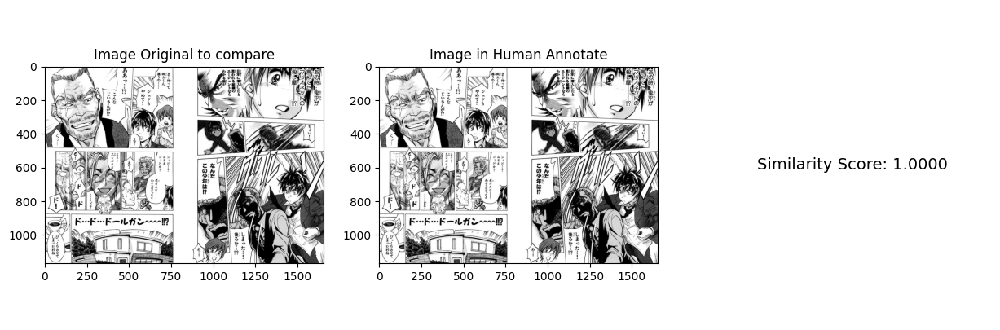

Processing original images:  48%|████▊     | 280/588 [17:43<10:28,  2.04s/it]

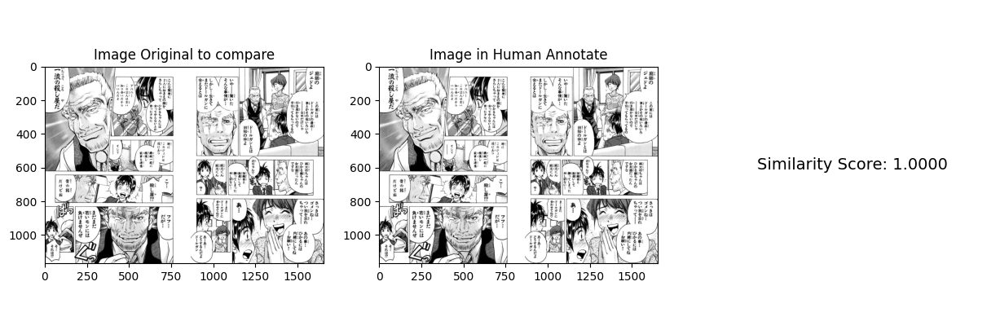

Processing original images:  48%|████▊     | 281/588 [17:45<11:02,  2.16s/it]

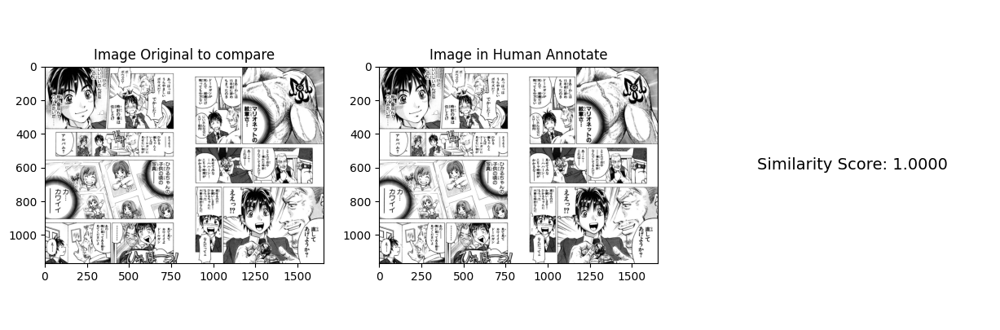

Processing original images:  48%|████▊     | 282/588 [17:48<12:34,  2.47s/it]

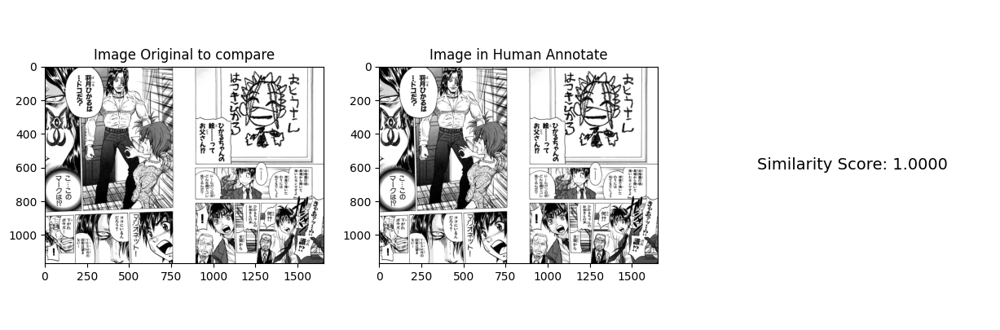

Processing original images:  50%|█████     | 296/588 [18:28<13:14,  2.72s/it]

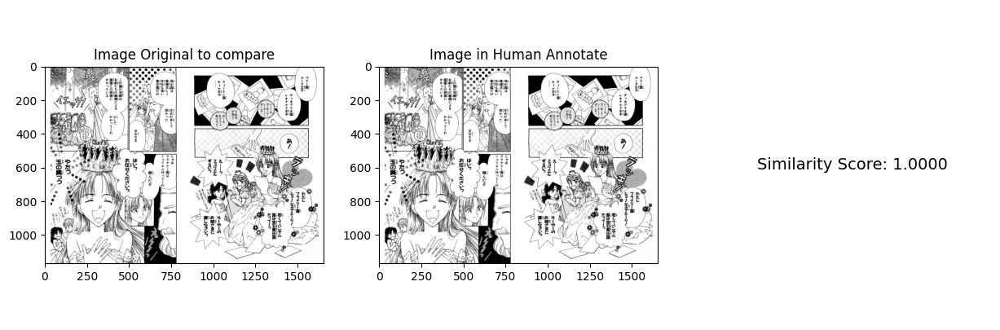

Processing original images:  51%|█████     | 297/588 [18:29<10:35,  2.18s/it]

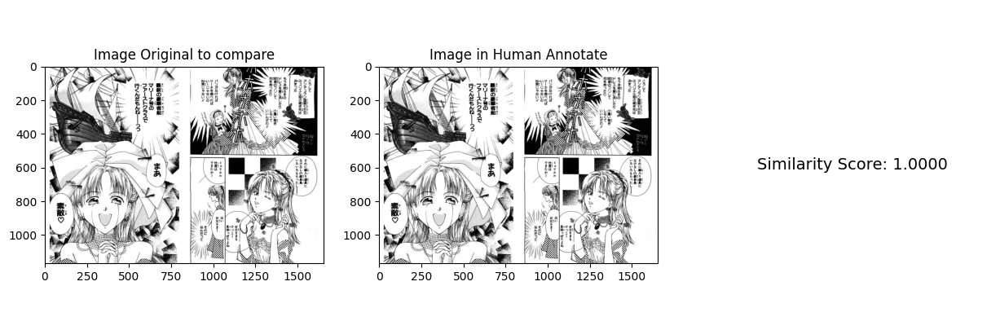

Processing original images:  51%|█████     | 298/588 [18:30<09:13,  1.91s/it]

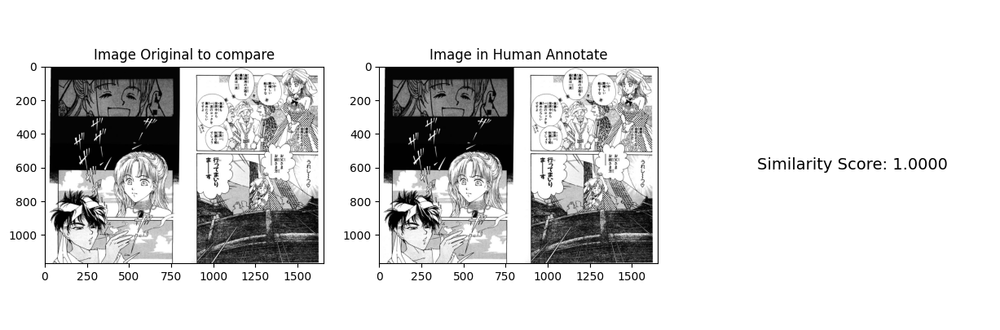

Processing original images:  51%|█████     | 299/588 [18:32<09:01,  1.87s/it]

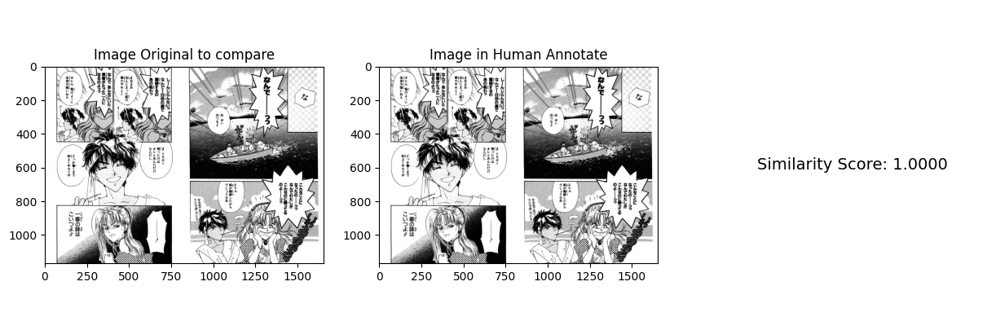

Processing original images:  51%|█████     | 300/588 [18:33<08:41,  1.81s/it]

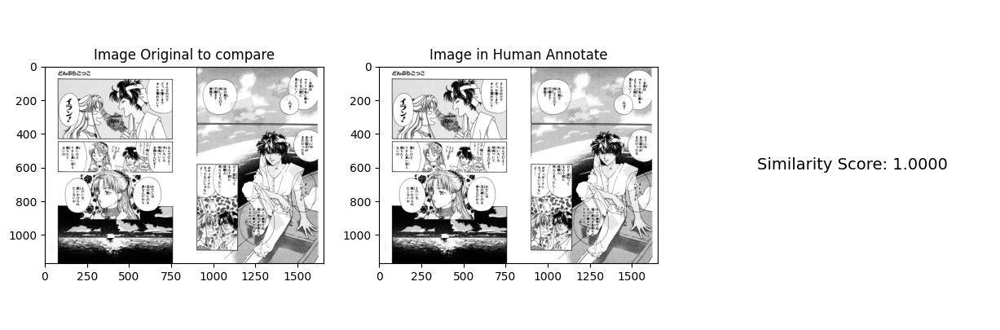

Processing original images:  51%|█████     | 301/588 [18:36<09:19,  1.95s/it]

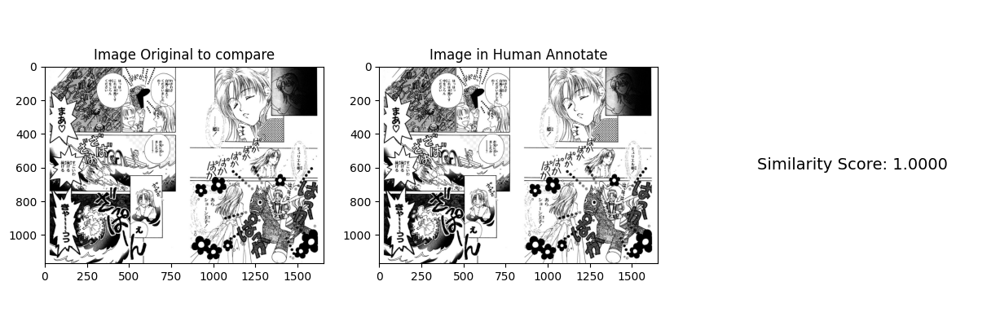

Processing original images:  51%|█████▏    | 302/588 [18:38<10:15,  2.15s/it]

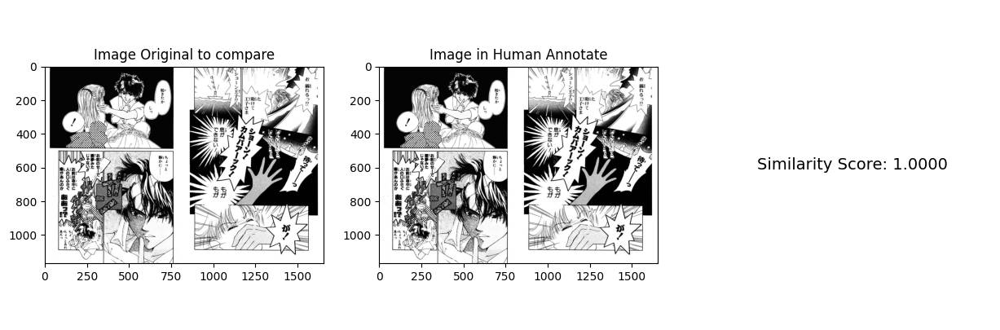

Processing original images:  52%|█████▏    | 303/588 [18:41<10:59,  2.31s/it]

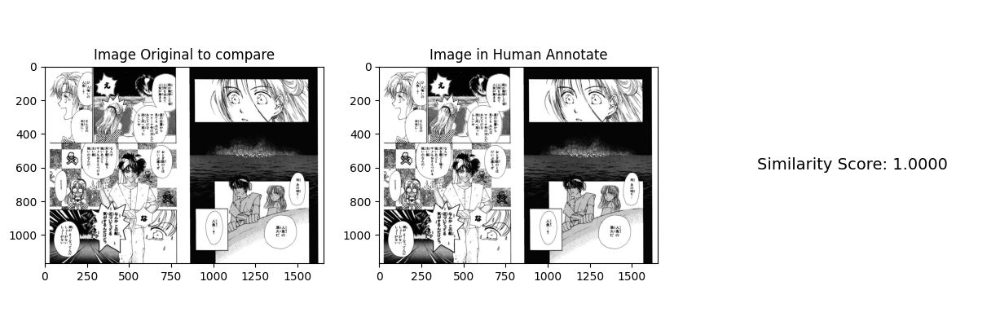

Processing original images:  54%|█████▍    | 317/588 [19:18<11:23,  2.52s/it]

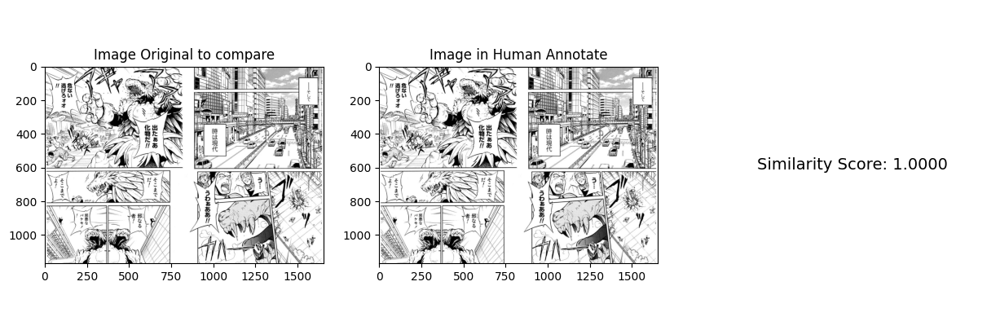

Processing original images:  54%|█████▍    | 318/588 [19:18<08:55,  1.98s/it]

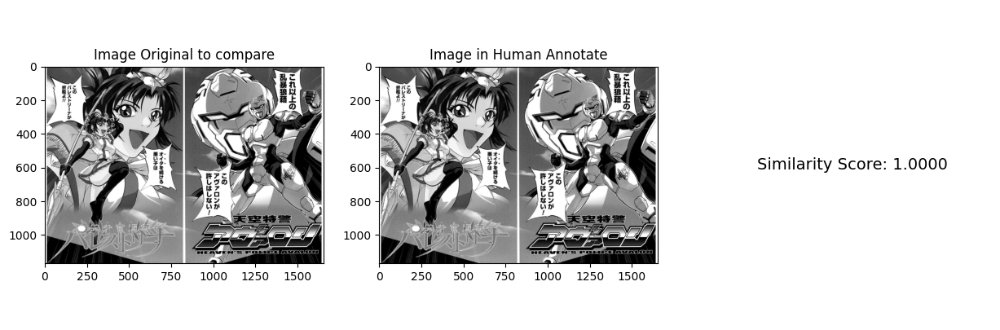

Processing original images:  54%|█████▍    | 319/588 [19:20<07:59,  1.78s/it]

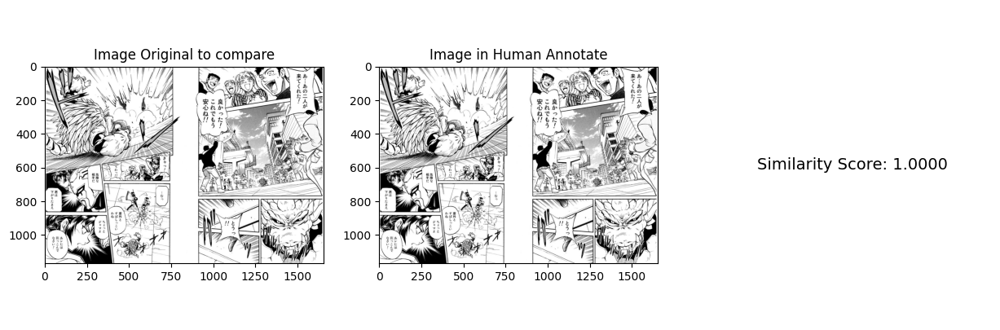

Processing original images:  54%|█████▍    | 320/588 [19:21<07:32,  1.69s/it]

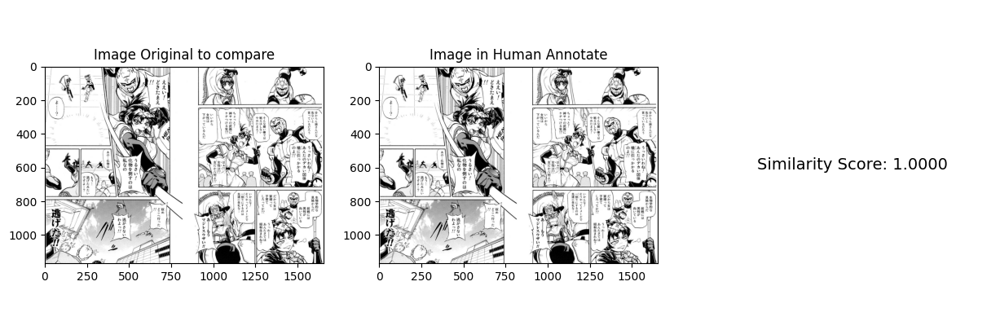

Processing original images:  55%|█████▍    | 321/588 [19:23<07:33,  1.70s/it]

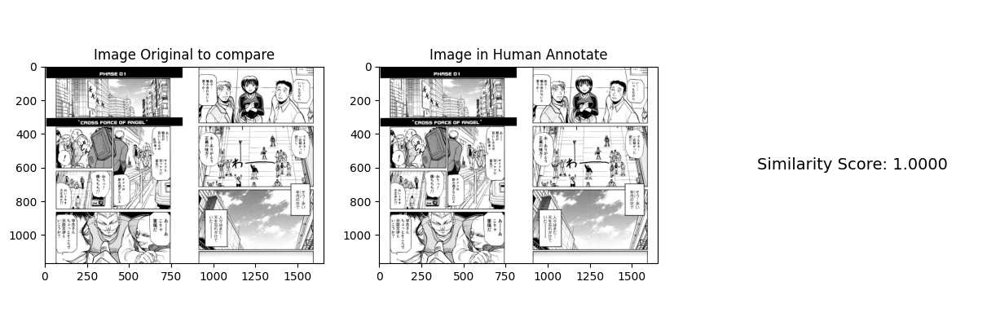

Processing original images:  55%|█████▍    | 322/588 [19:25<07:42,  1.74s/it]

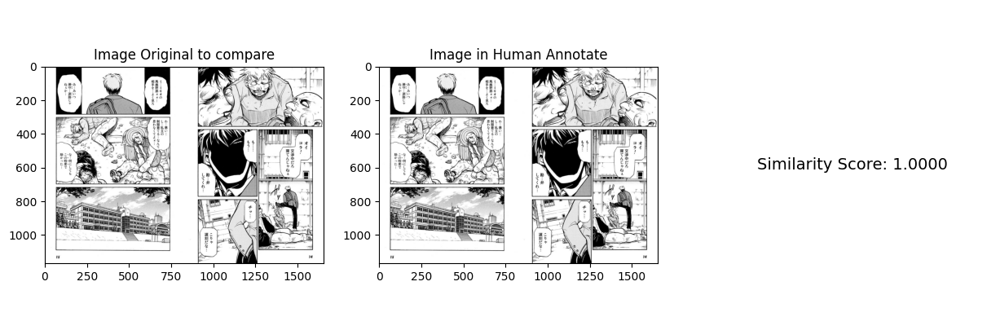

Processing original images:  55%|█████▍    | 323/588 [19:27<08:36,  1.95s/it]

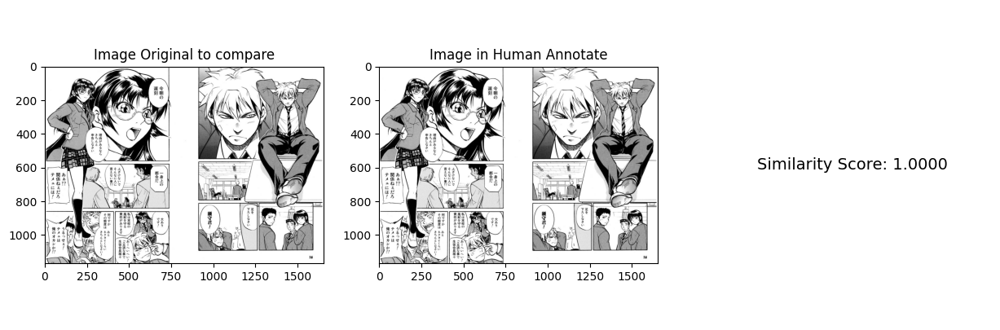

Processing original images:  55%|█████▌    | 324/588 [19:30<09:19,  2.12s/it]

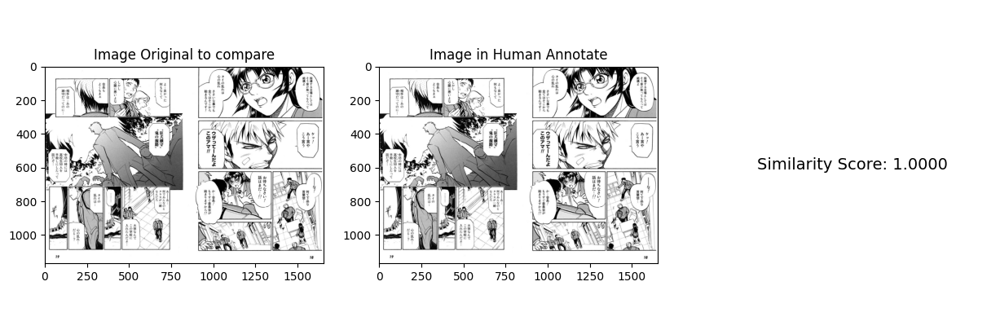

Processing original images:  57%|█████▋    | 338/588 [20:02<09:06,  2.19s/it]

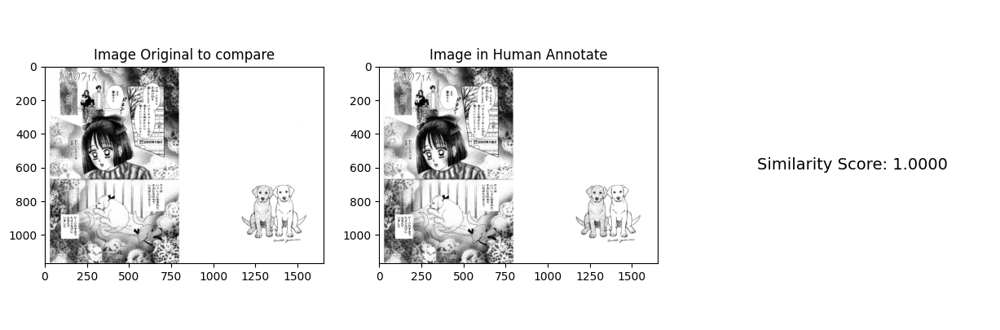

Processing original images:  58%|█████▊    | 339/588 [20:03<07:14,  1.75s/it]

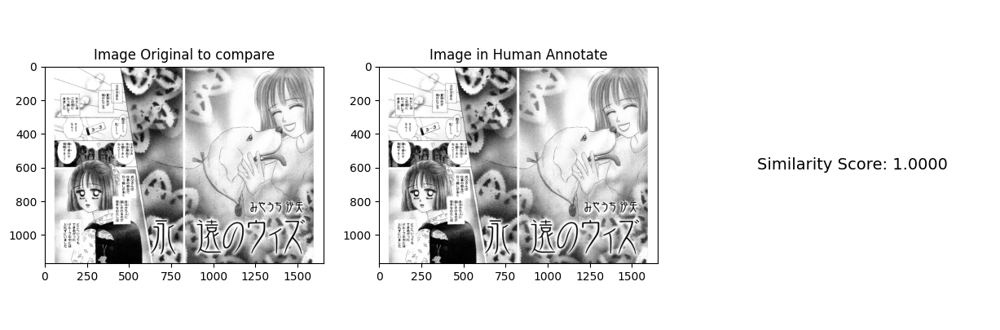

Processing original images:  58%|█████▊    | 340/588 [20:04<06:40,  1.61s/it]

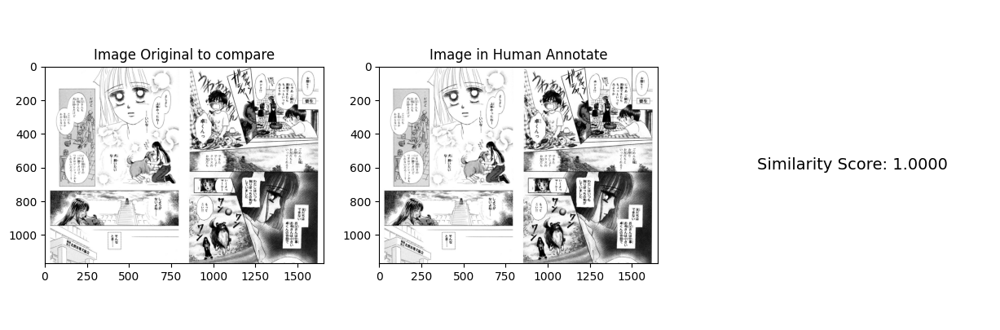

Processing original images:  58%|█████▊    | 341/588 [20:06<06:31,  1.59s/it]

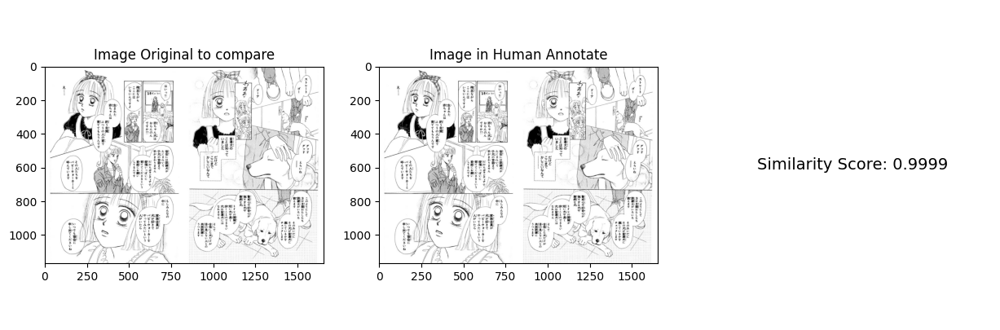

Processing original images:  58%|█████▊    | 342/588 [20:07<06:31,  1.59s/it]

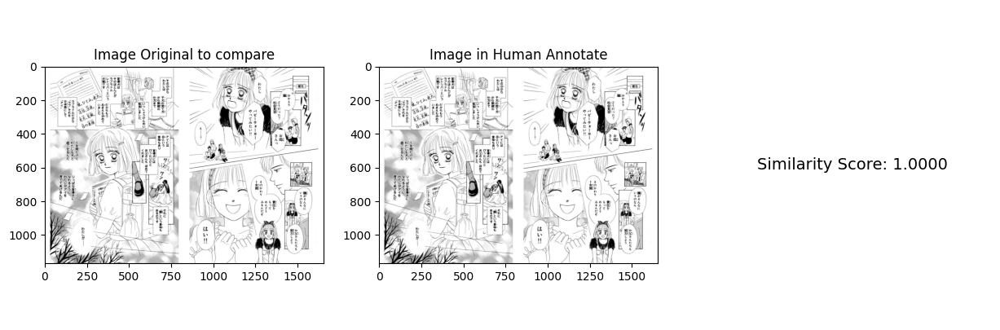

Processing original images:  58%|█████▊    | 343/588 [20:09<06:51,  1.68s/it]

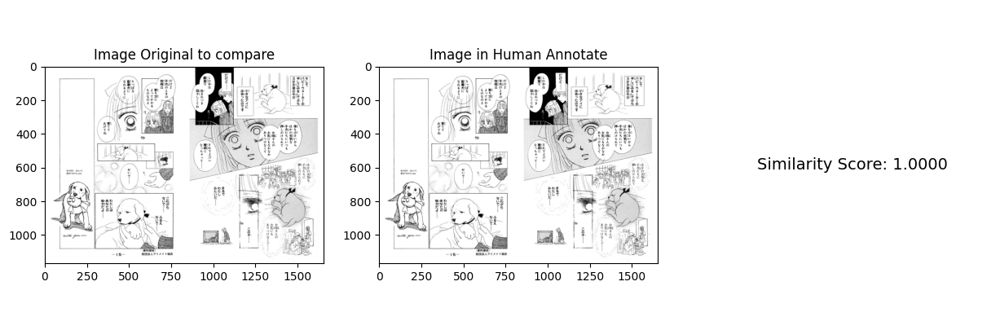

Processing original images:  59%|█████▊    | 344/588 [20:11<07:19,  1.80s/it]

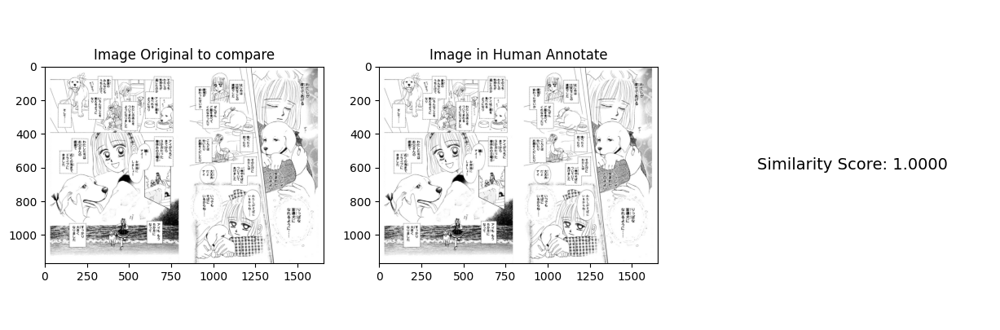

Processing original images:  59%|█████▊    | 345/588 [20:14<08:01,  1.98s/it]

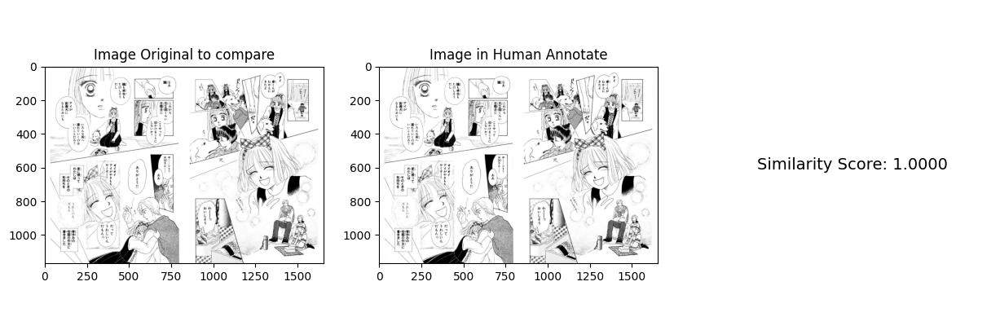

Processing original images:  61%|██████    | 359/588 [20:44<08:07,  2.13s/it]

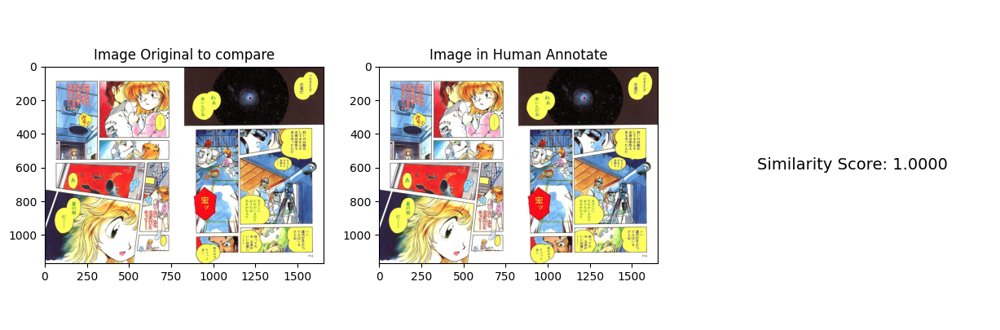

Processing original images:  61%|██████    | 360/588 [20:45<06:36,  1.74s/it]

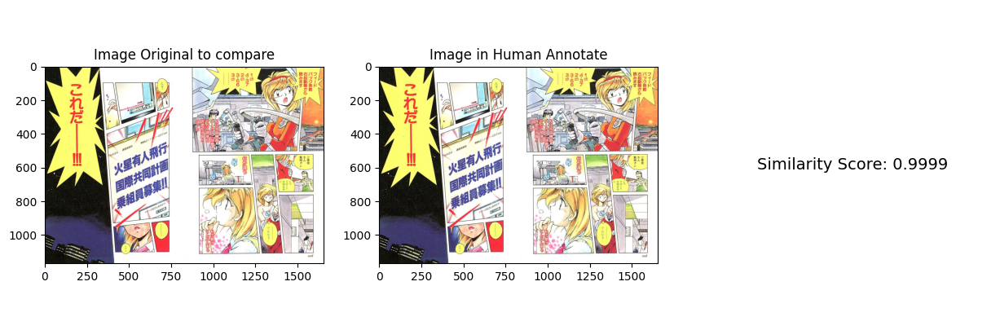

Processing original images:  62%|██████▏   | 362/588 [20:48<06:46,  1.80s/it]

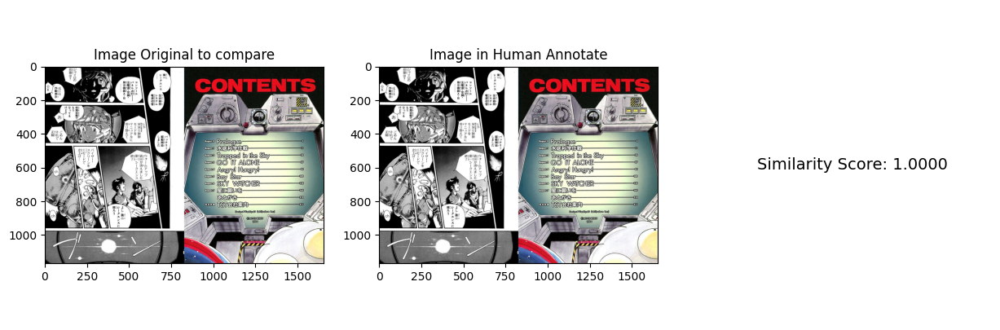

Processing original images:  62%|██████▏   | 364/588 [20:52<06:45,  1.81s/it]

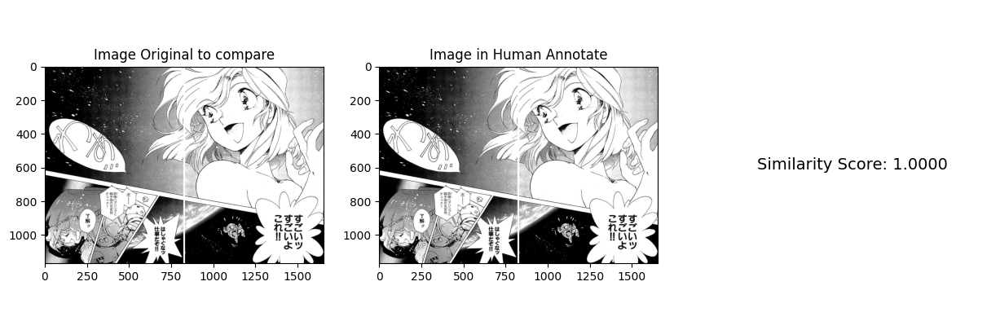

Processing original images:  62%|██████▏   | 365/588 [20:54<07:08,  1.92s/it]

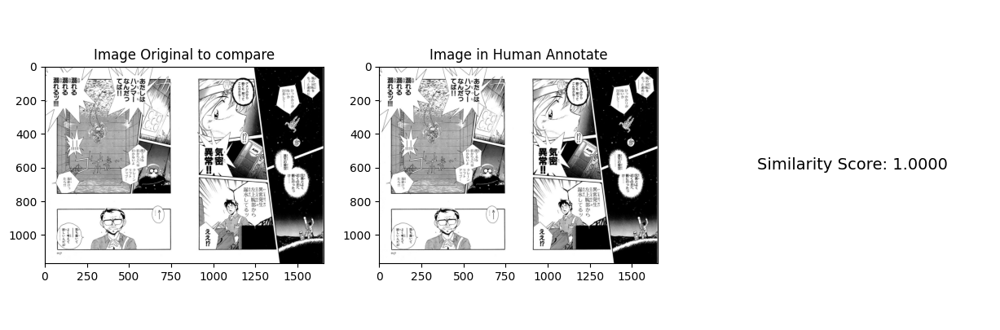

Processing original images:  62%|██████▏   | 366/588 [20:57<07:48,  2.11s/it]

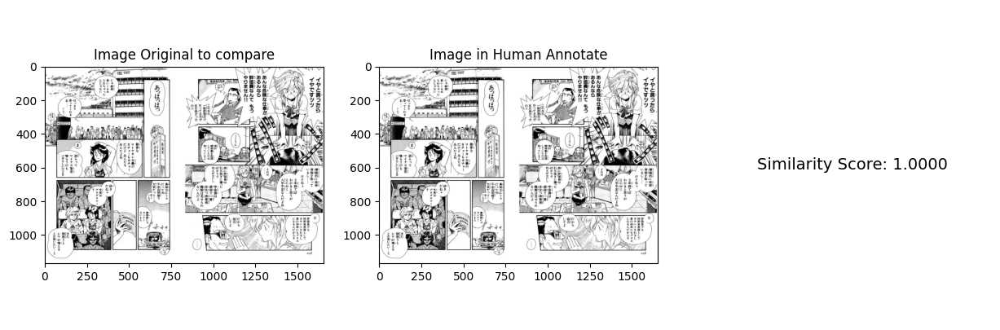

Processing original images:  65%|██████▍   | 380/588 [21:29<07:20,  2.12s/it]

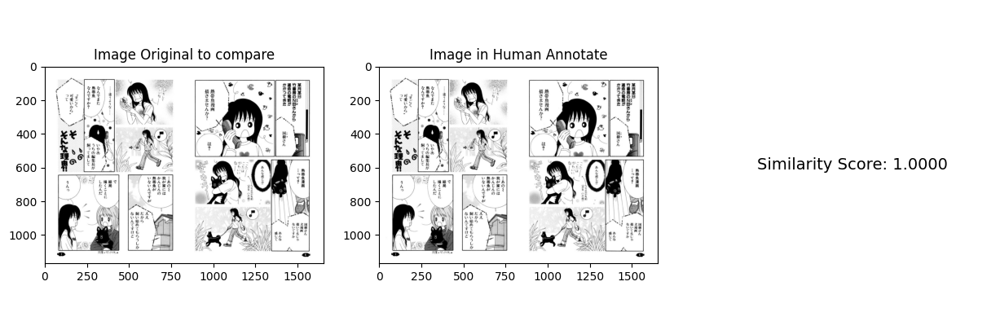

Processing original images:  65%|██████▍   | 381/588 [21:29<05:55,  1.72s/it]

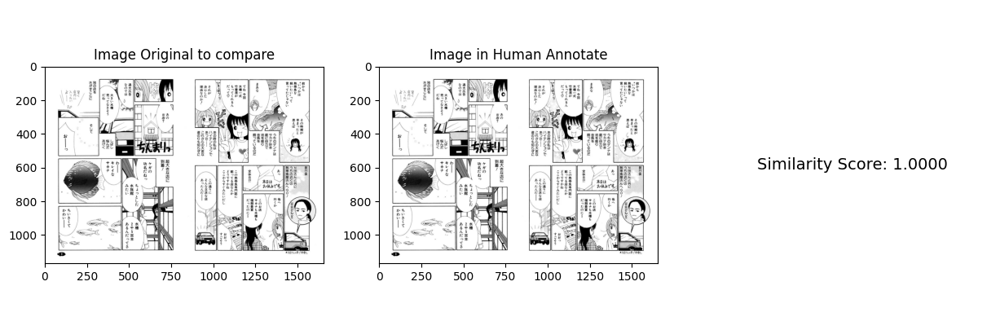

Processing original images:  65%|██████▍   | 382/588 [21:31<05:20,  1.56s/it]

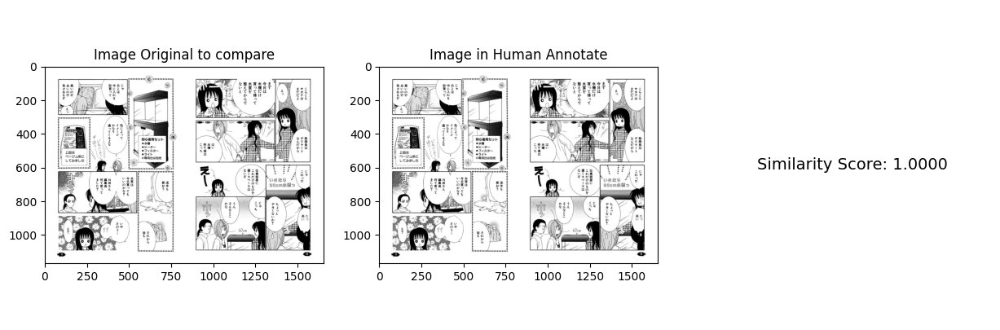

Processing original images:  65%|██████▌   | 383/588 [21:32<05:17,  1.55s/it]

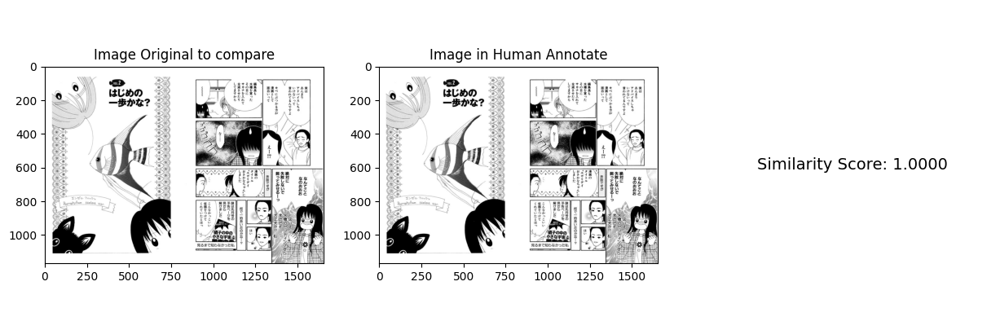

Processing original images:  65%|██████▌   | 384/588 [21:34<05:21,  1.58s/it]

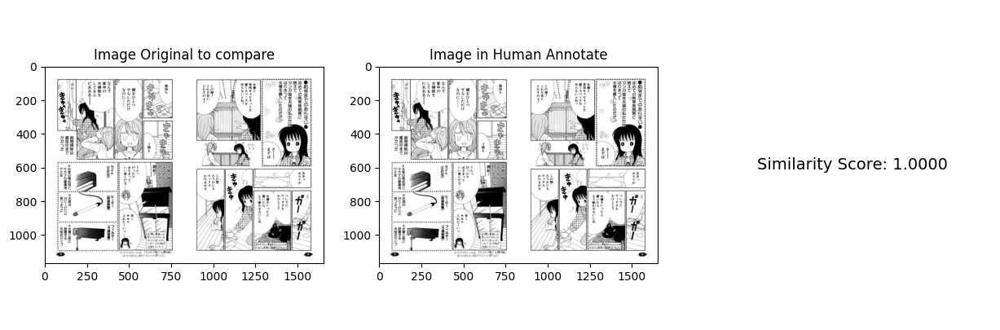

Processing original images:  65%|██████▌   | 385/588 [21:35<05:26,  1.61s/it]

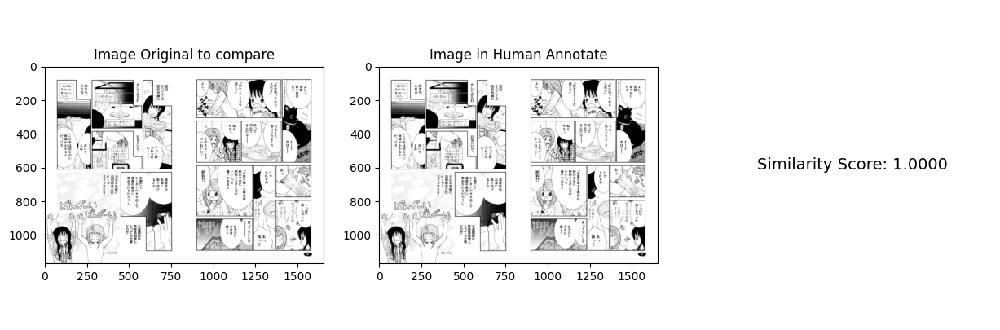

Processing original images:  66%|██████▌   | 386/588 [21:38<06:00,  1.79s/it]

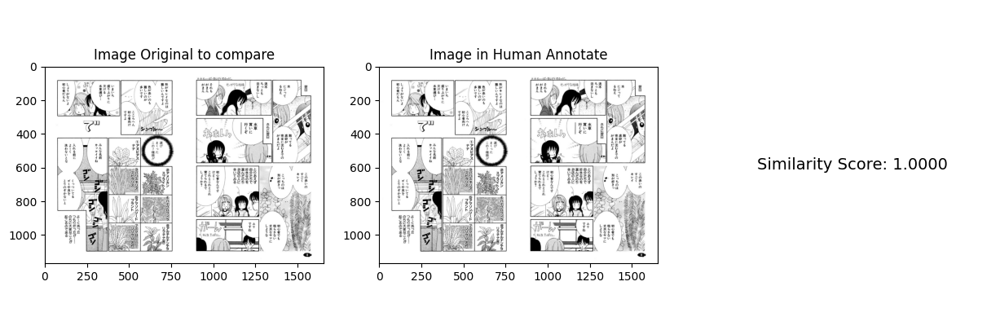

Processing original images:  66%|██████▌   | 387/588 [21:40<06:26,  1.92s/it]

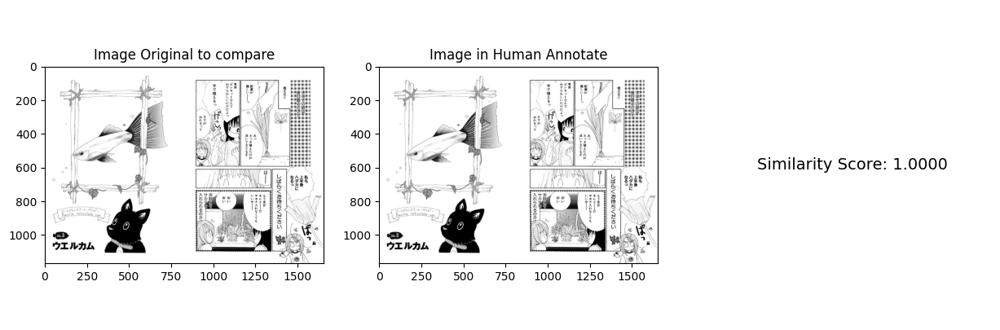

Processing original images:  68%|██████▊   | 400/588 [22:05<05:48,  1.86s/it]

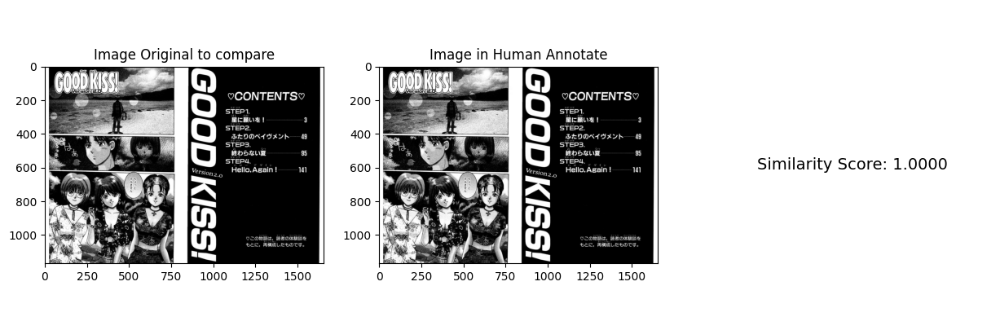

Processing original images:  68%|██████▊   | 402/588 [22:08<05:15,  1.70s/it]

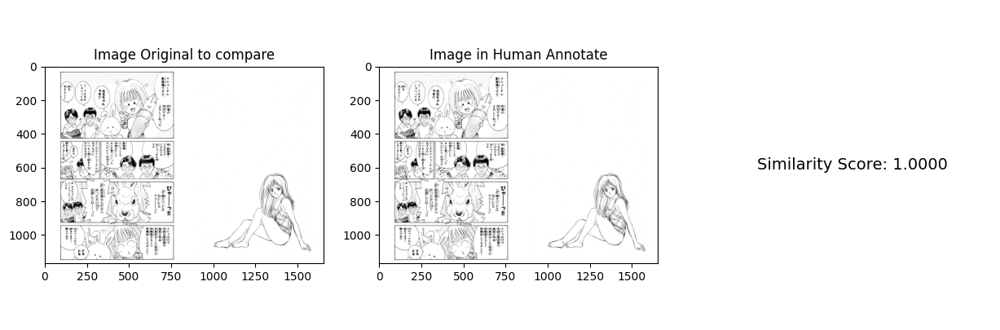

Processing original images:  69%|██████▊   | 403/588 [22:09<04:32,  1.47s/it]

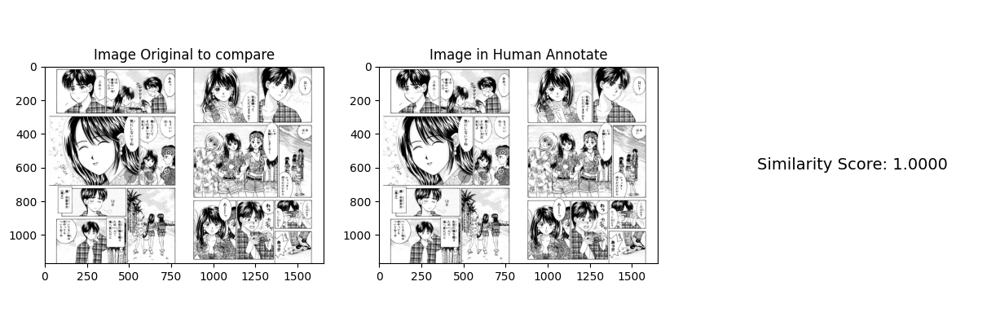

Processing original images:  69%|██████▊   | 404/588 [22:10<04:27,  1.45s/it]

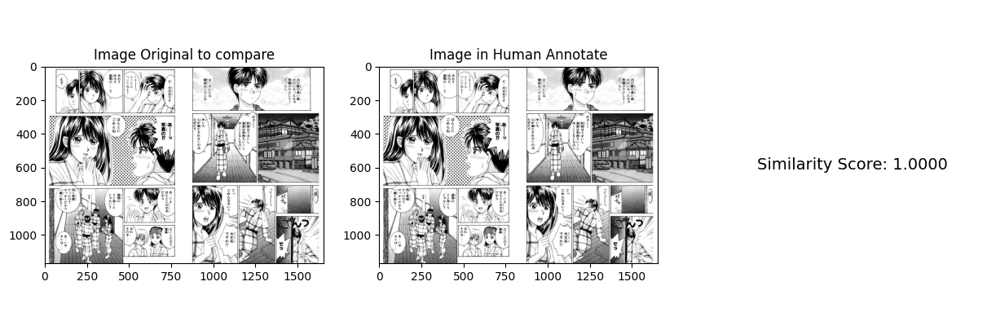

Processing original images:  69%|██████▉   | 405/588 [22:11<04:24,  1.45s/it]

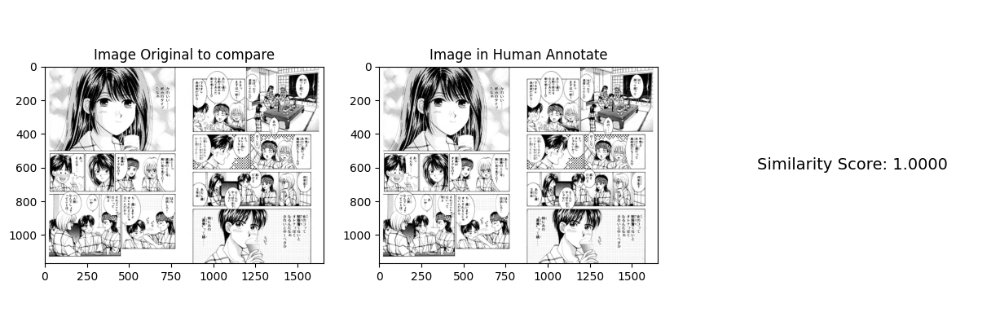

Processing original images:  69%|██████▉   | 406/588 [22:13<04:41,  1.55s/it]

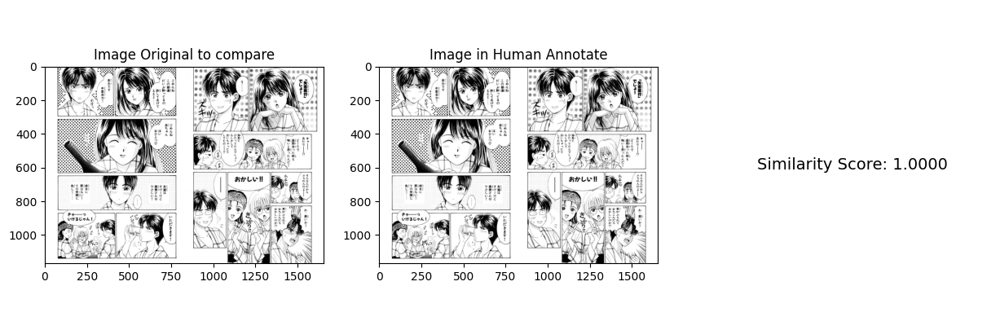

Processing original images:  69%|██████▉   | 407/588 [22:15<05:20,  1.77s/it]

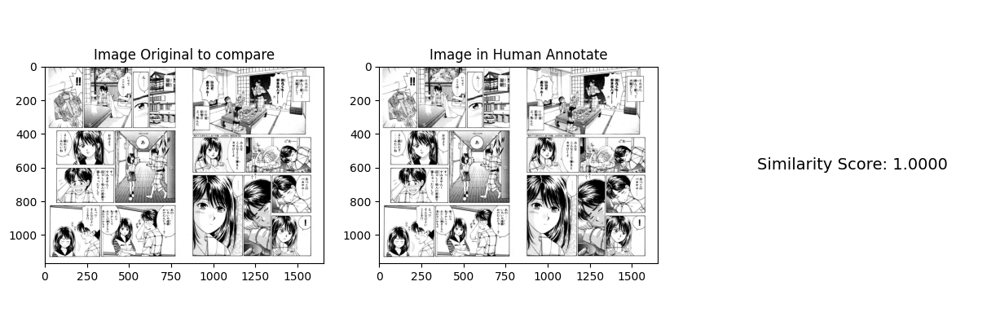

Processing original images:  69%|██████▉   | 408/588 [22:18<05:50,  1.95s/it]

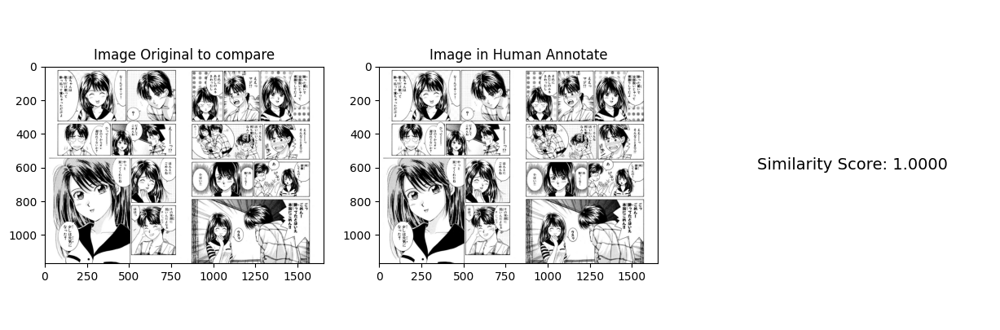

Processing original images:  72%|███████▏  | 422/588 [22:48<05:47,  2.09s/it]

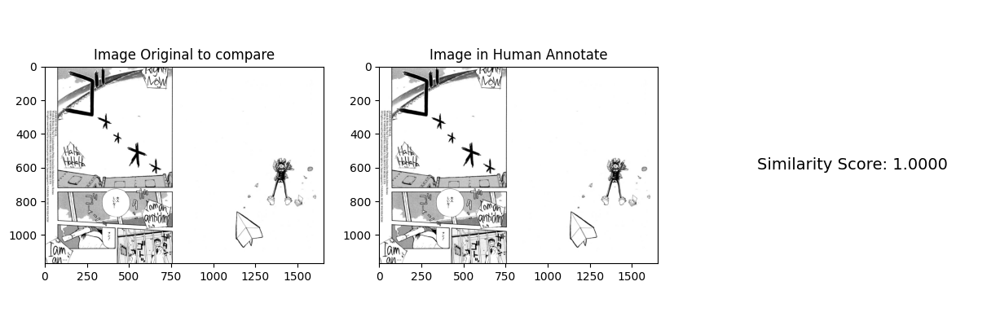

Processing original images:  72%|███████▏  | 423/588 [22:48<04:36,  1.67s/it]

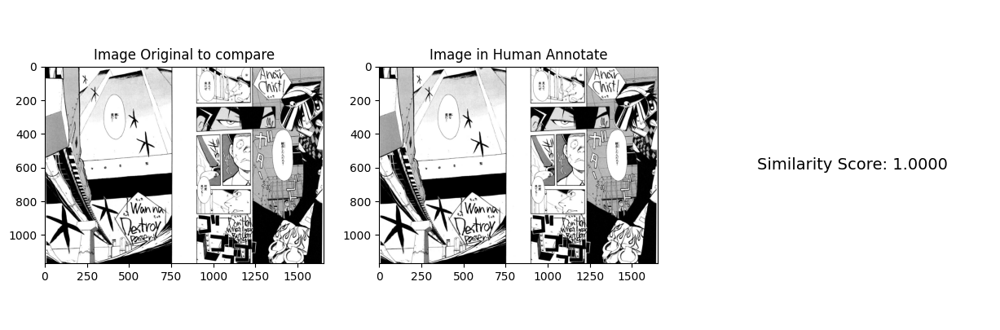

Processing original images:  72%|███████▏  | 424/588 [22:50<04:08,  1.51s/it]

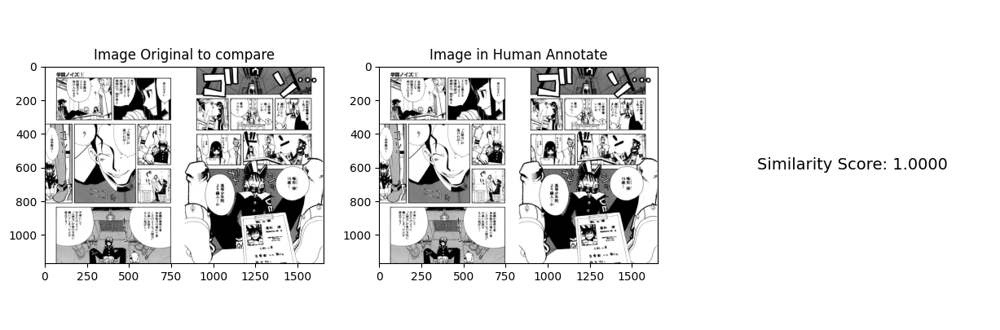

Processing original images:  72%|███████▏  | 425/588 [22:51<04:05,  1.50s/it]

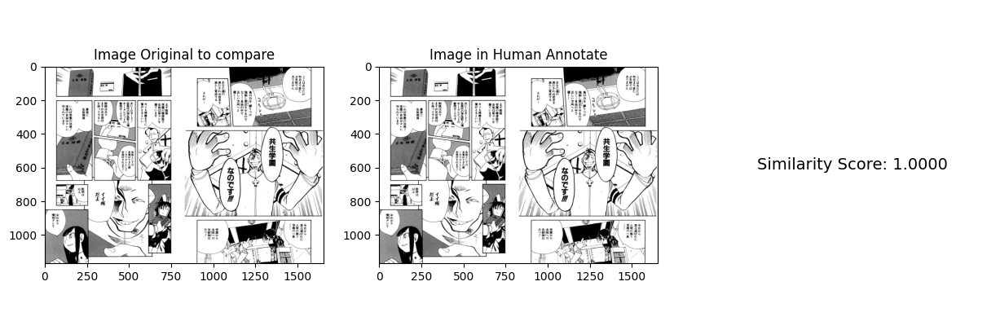

Processing original images:  72%|███████▏  | 426/588 [22:53<04:36,  1.71s/it]

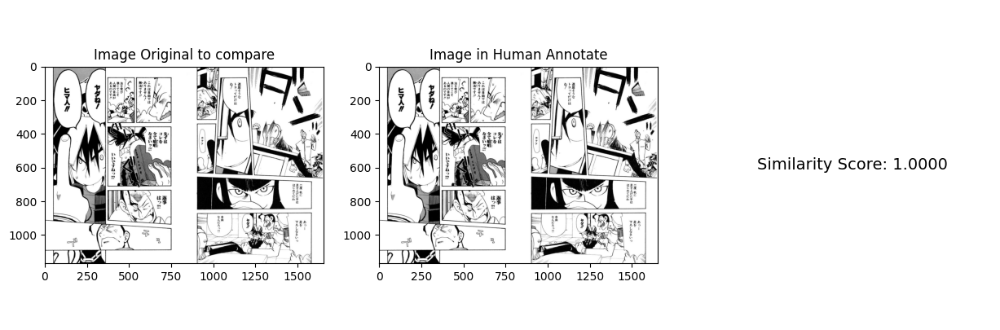

Processing original images:  73%|███████▎  | 427/588 [22:56<05:12,  1.94s/it]

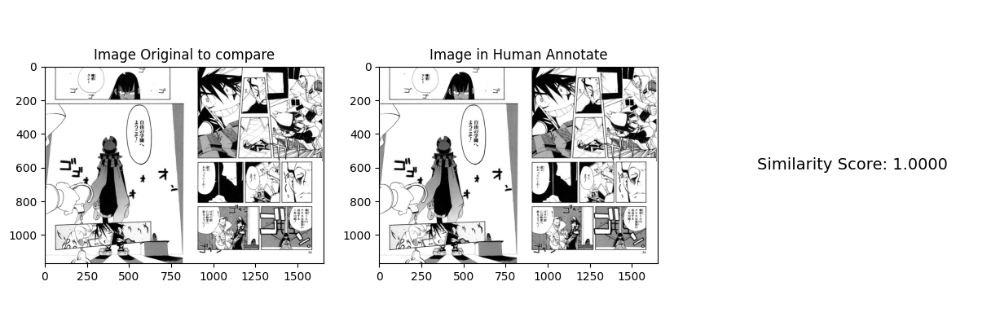

Processing original images:  73%|███████▎  | 428/588 [22:58<05:43,  2.15s/it]

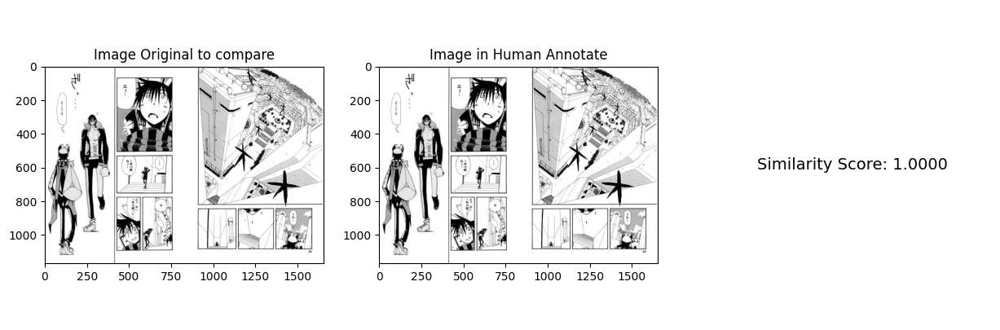

Processing original images:  73%|███████▎  | 429/588 [23:01<06:16,  2.37s/it]

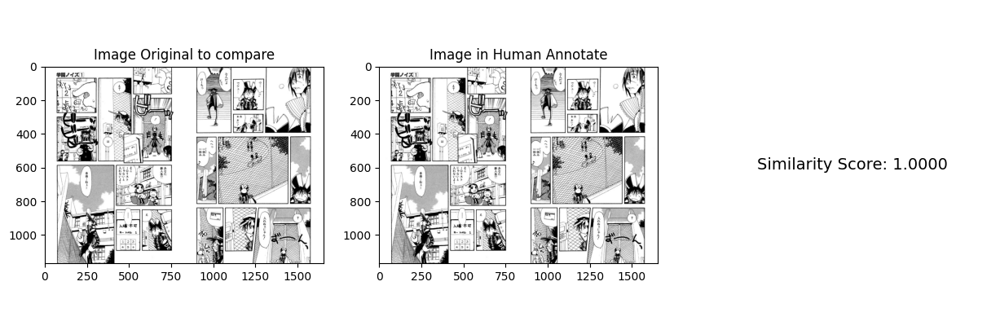

Processing original images:  75%|███████▌  | 443/588 [23:30<04:38,  1.92s/it]

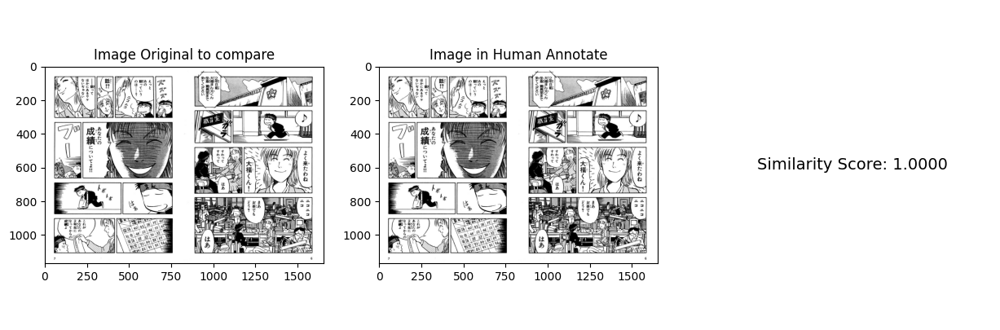

Processing original images:  76%|███████▌  | 444/588 [23:31<03:46,  1.57s/it]

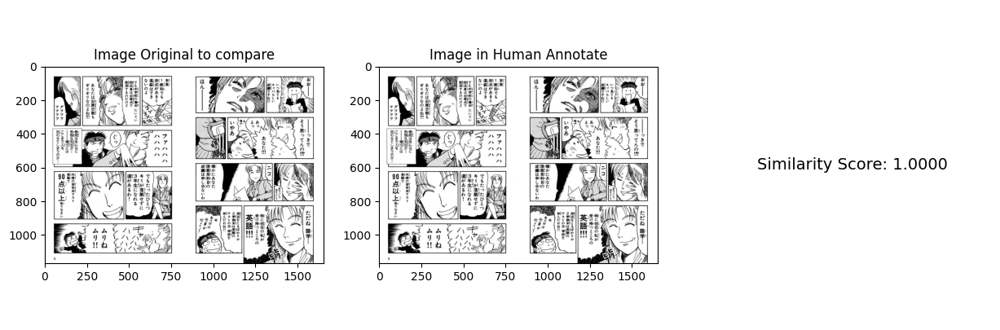

Processing original images:  76%|███████▌  | 445/588 [23:32<03:38,  1.53s/it]

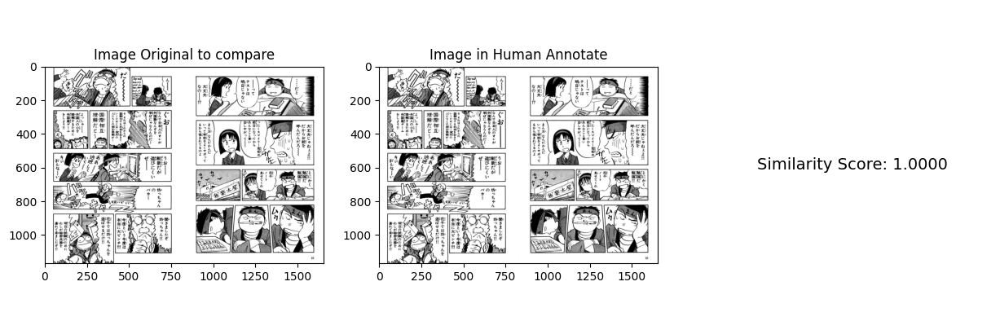

Processing original images:  76%|███████▌  | 446/588 [23:34<03:39,  1.55s/it]

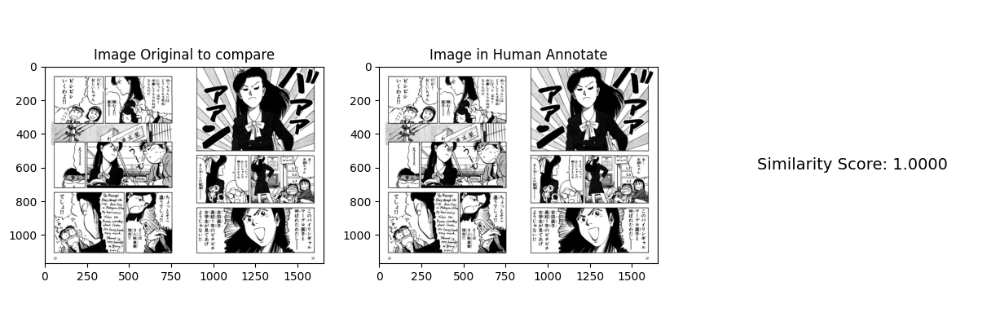

Processing original images:  76%|███████▌  | 447/588 [23:35<03:40,  1.56s/it]

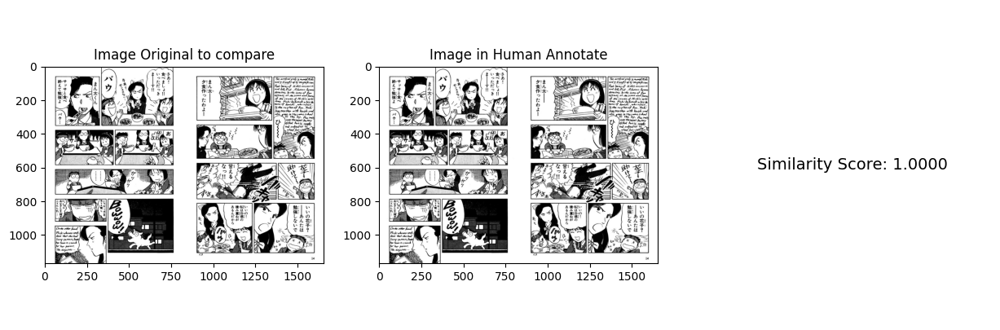

Processing original images:  76%|███████▌  | 448/588 [23:37<04:03,  1.74s/it]

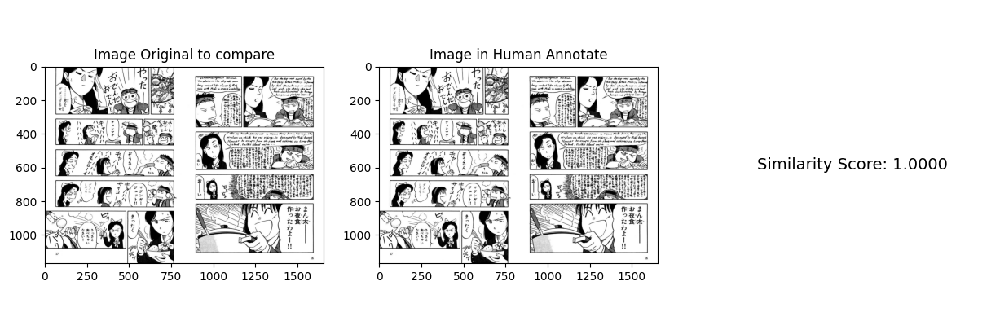

Processing original images:  76%|███████▋  | 449/588 [23:40<04:18,  1.86s/it]

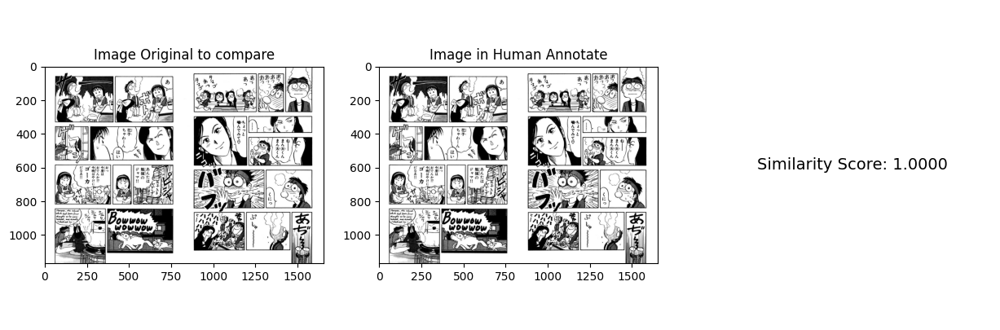

Processing original images:  77%|███████▋  | 450/588 [23:42<04:30,  1.96s/it]

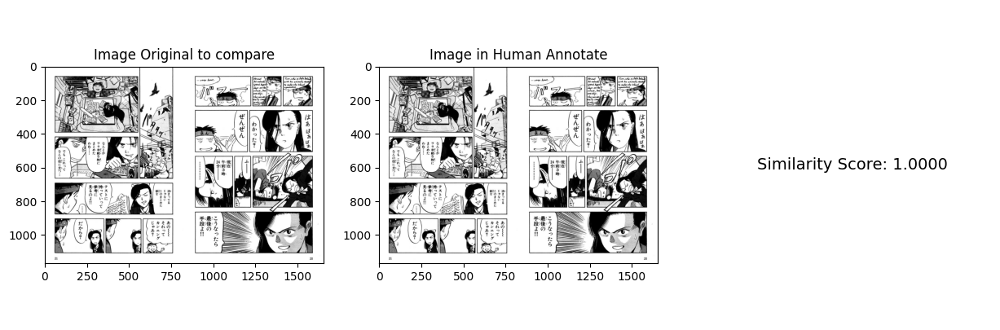

Processing original images:  79%|███████▊  | 463/588 [24:03<03:04,  1.47s/it]

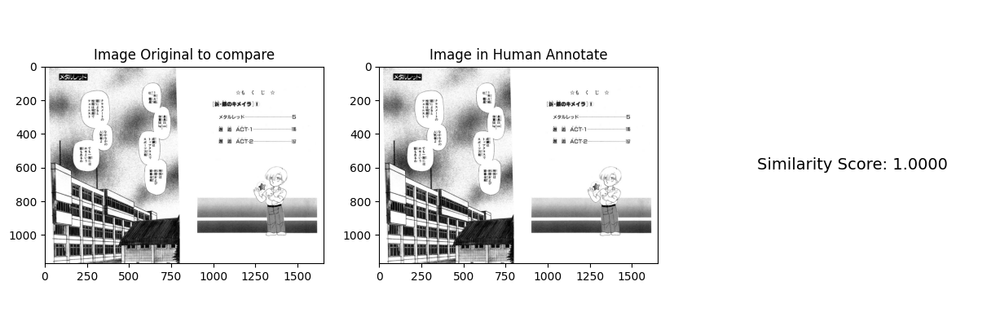

Processing original images:  79%|███████▉  | 465/588 [24:06<02:48,  1.37s/it]

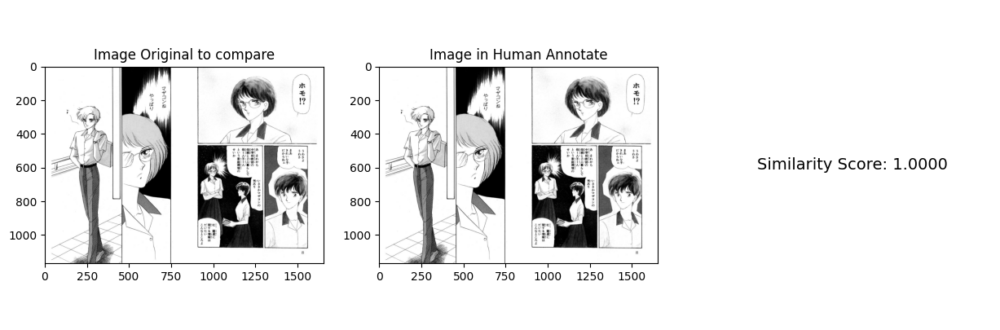

Processing original images:  79%|███████▉  | 466/588 [24:07<02:30,  1.23s/it]

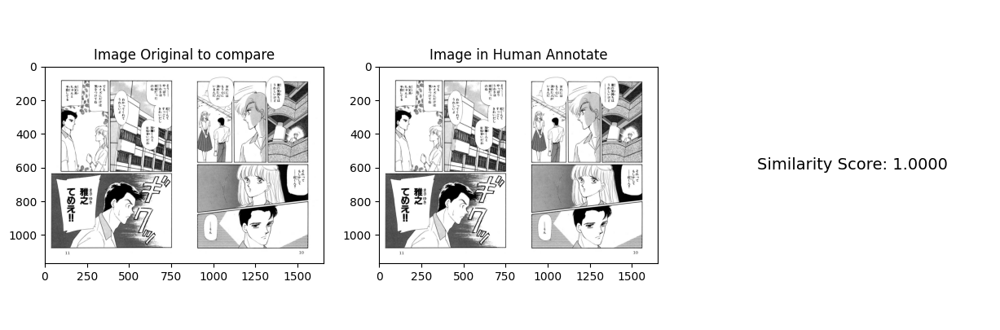

Processing original images:  79%|███████▉  | 467/588 [24:08<02:27,  1.22s/it]

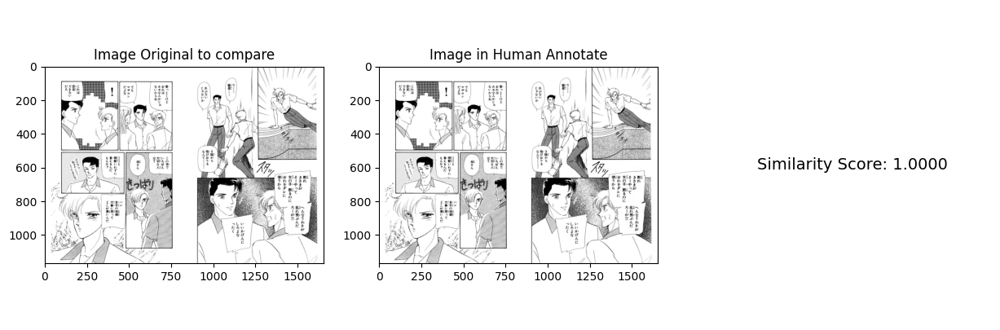

Processing original images:  80%|███████▉  | 468/588 [24:09<02:34,  1.29s/it]

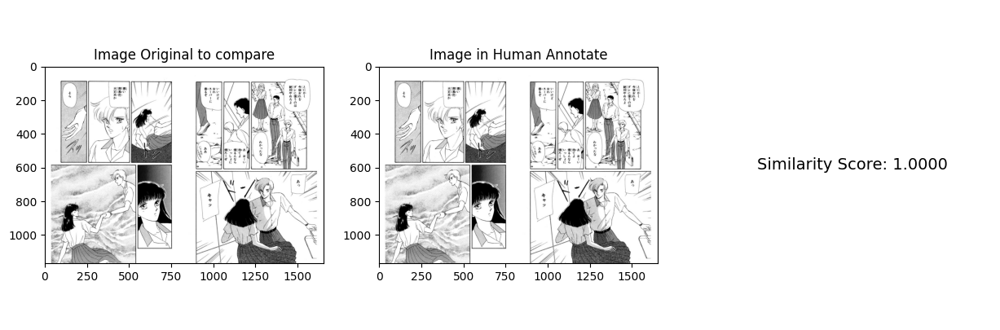

Processing original images:  80%|███████▉  | 469/588 [24:11<02:40,  1.35s/it]

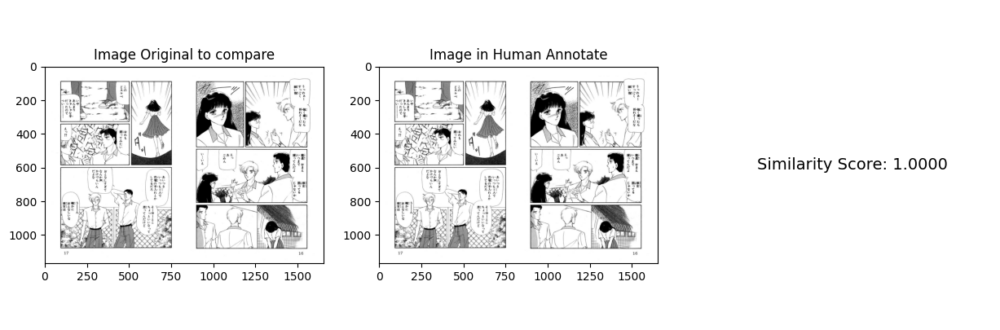

Processing original images:  80%|███████▉  | 470/588 [24:12<02:52,  1.46s/it]

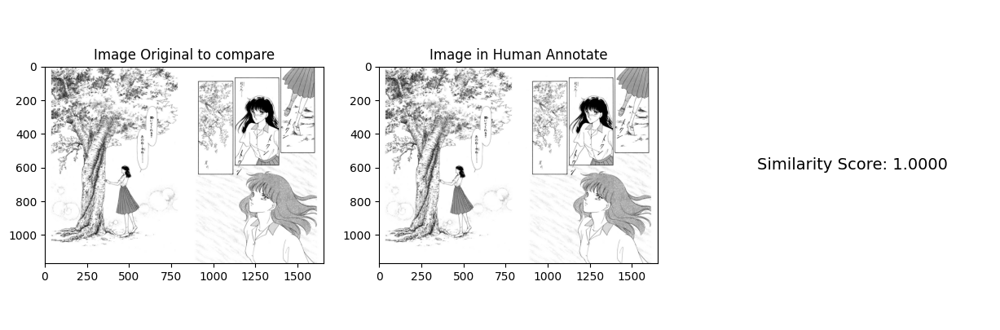

Processing original images:  80%|████████  | 471/588 [24:14<03:06,  1.60s/it]

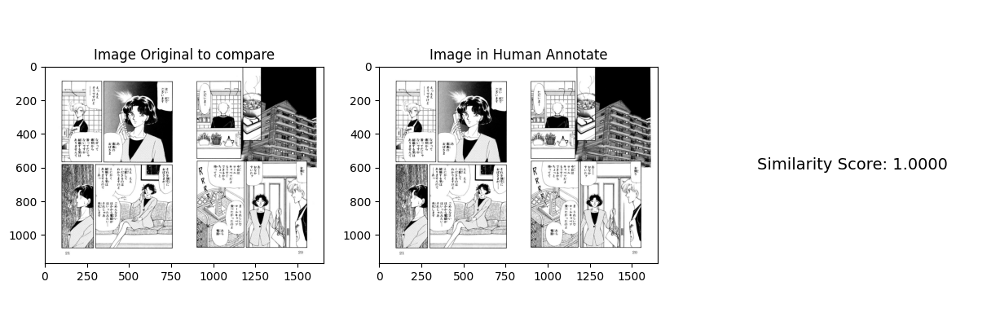

Processing original images:  82%|████████▏ | 483/588 [24:31<02:17,  1.31s/it]

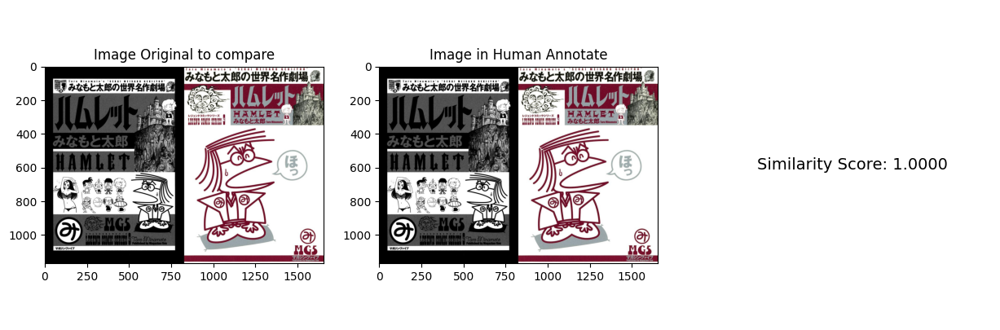

Processing original images:  83%|████████▎ | 489/588 [24:37<01:59,  1.20s/it]

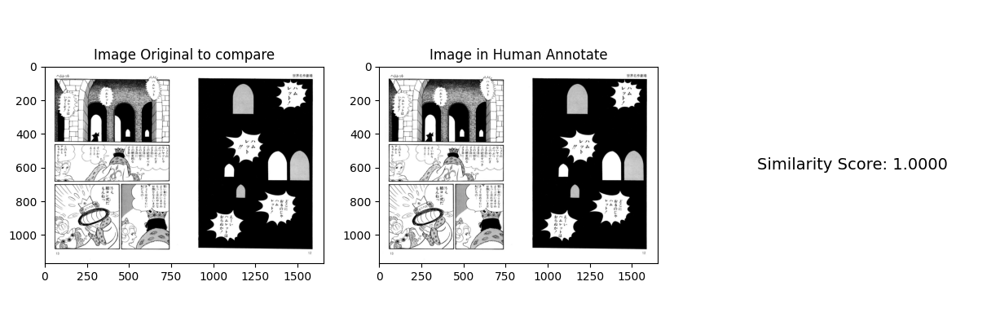

Processing original images:  83%|████████▎ | 490/588 [24:39<02:14,  1.38s/it]

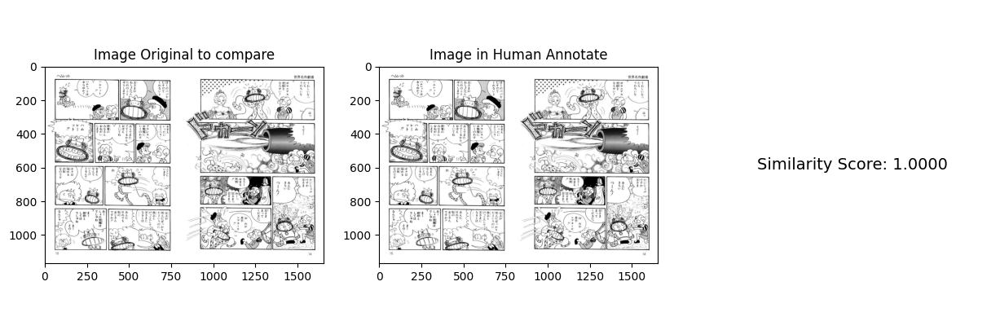

Processing original images:  84%|████████▎ | 491/588 [24:42<02:46,  1.72s/it]

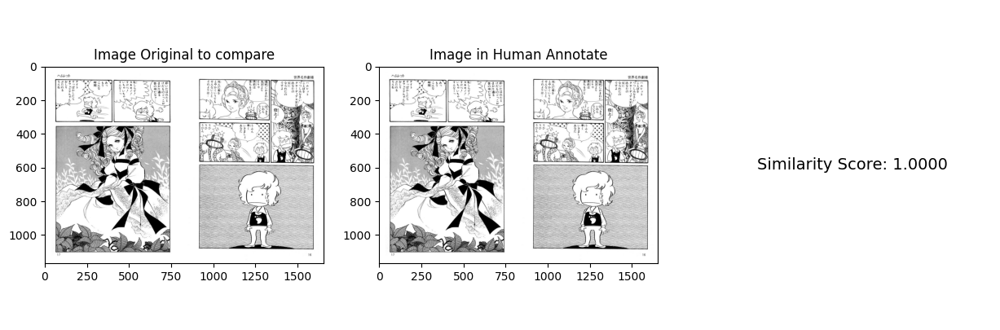

Processing original images:  84%|████████▎ | 492/588 [24:44<02:49,  1.77s/it]

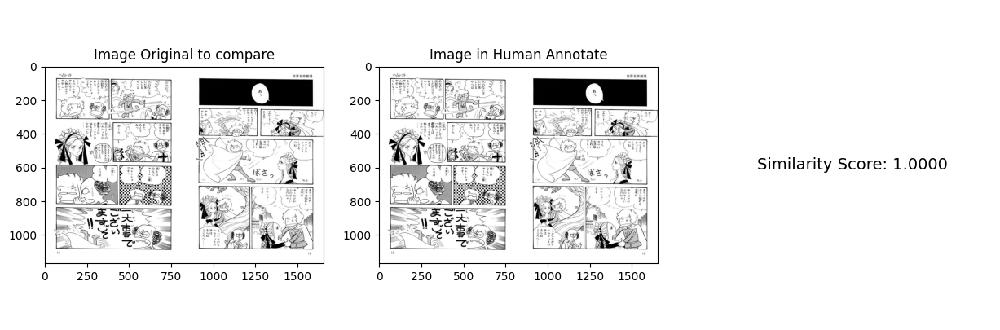

Processing original images:  86%|████████▌ | 506/588 [25:01<01:34,  1.16s/it]

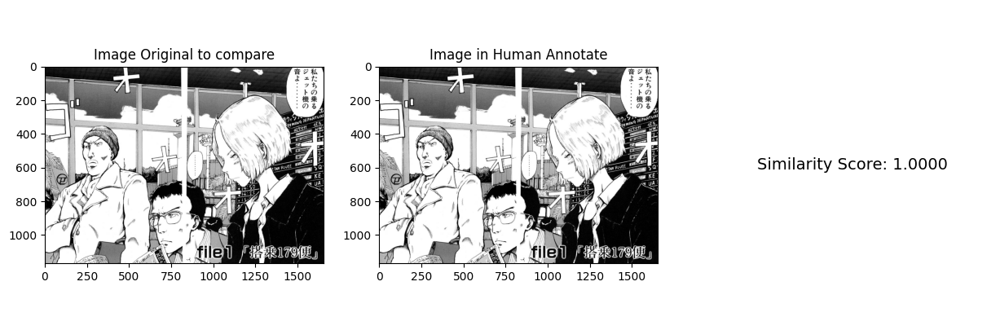

Processing original images:  86%|████████▌ | 507/588 [25:02<01:24,  1.04s/it]

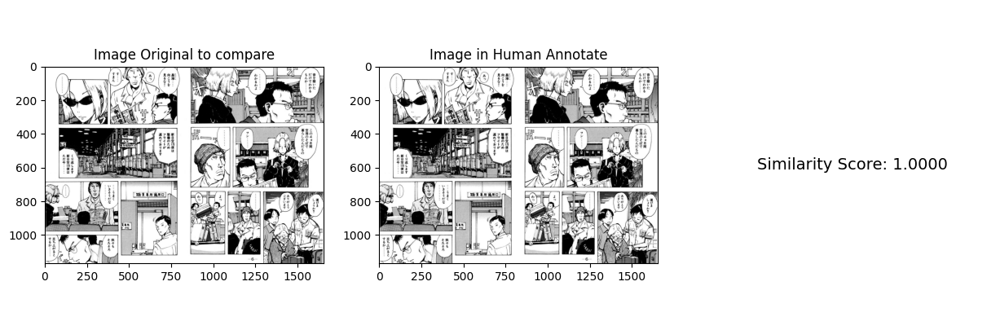

Processing original images:  86%|████████▋ | 508/588 [25:03<01:22,  1.03s/it]

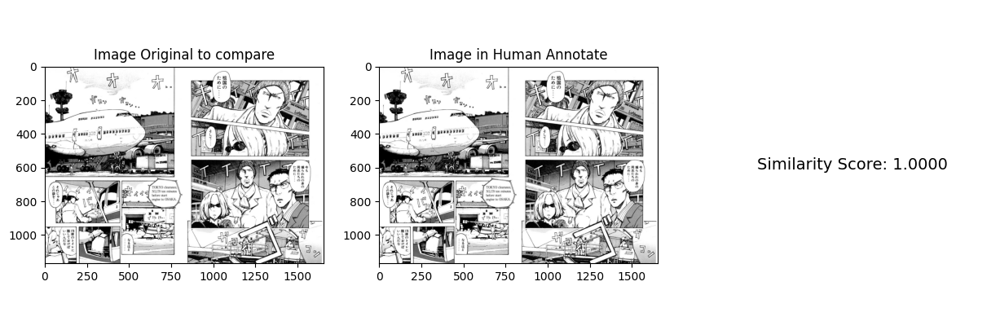

Processing original images:  87%|████████▋ | 509/588 [25:04<01:26,  1.09s/it]

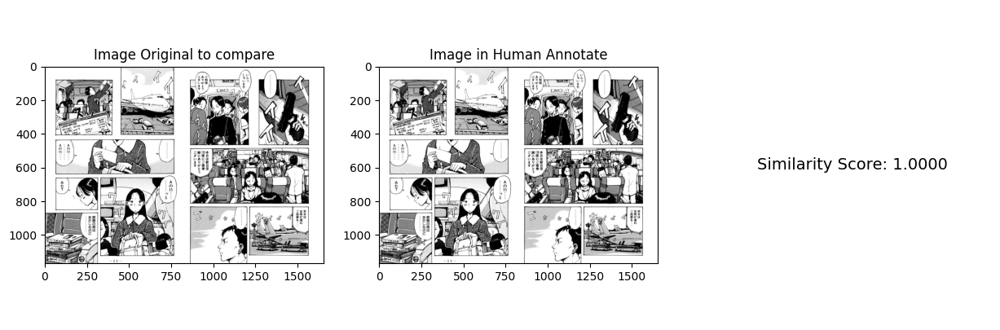

Processing original images:  87%|████████▋ | 510/588 [25:05<01:32,  1.18s/it]

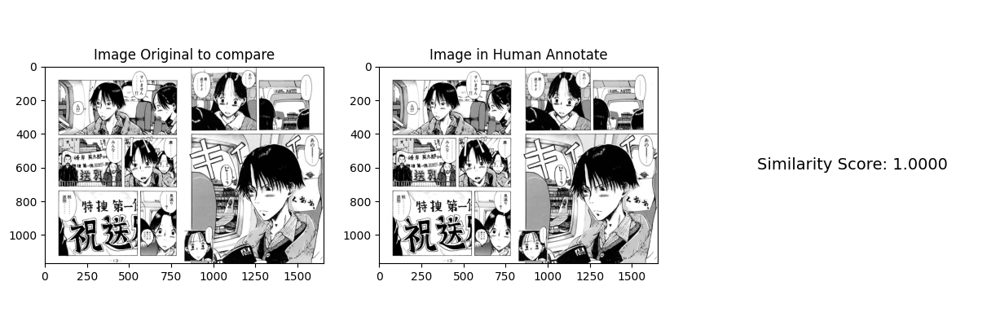

Processing original images:  87%|████████▋ | 511/588 [25:07<01:37,  1.26s/it]

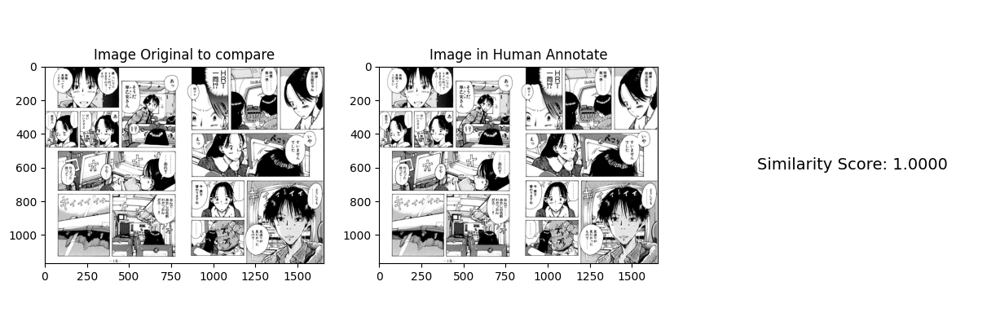

Processing original images:  87%|████████▋ | 512/588 [25:08<01:42,  1.35s/it]

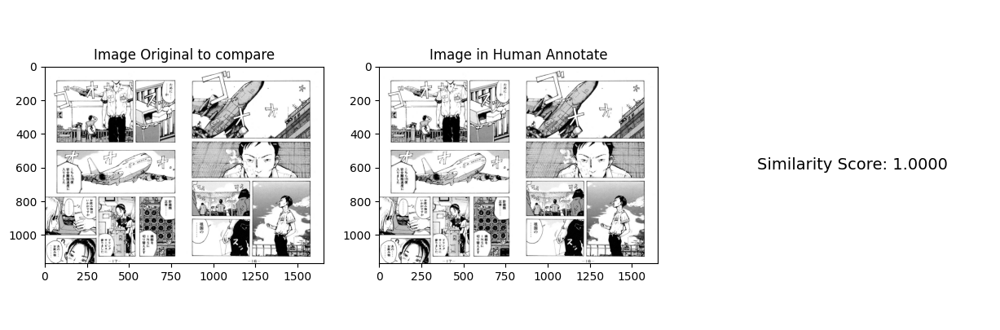

Processing original images:  87%|████████▋ | 513/588 [25:10<01:48,  1.45s/it]

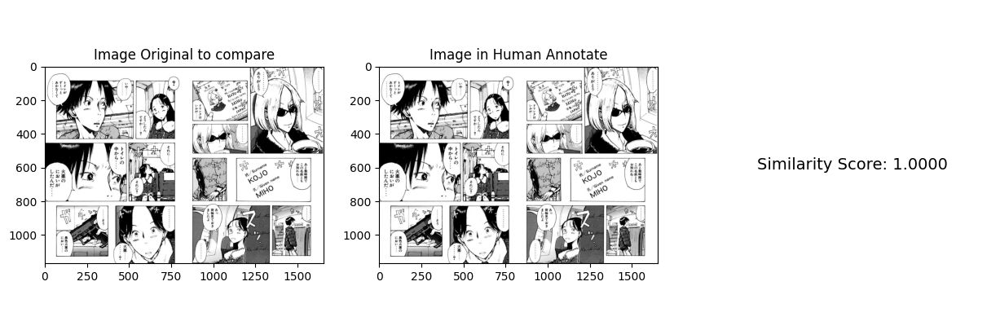

Processing original images:  90%|████████▉ | 527/588 [25:25<00:59,  1.03it/s]

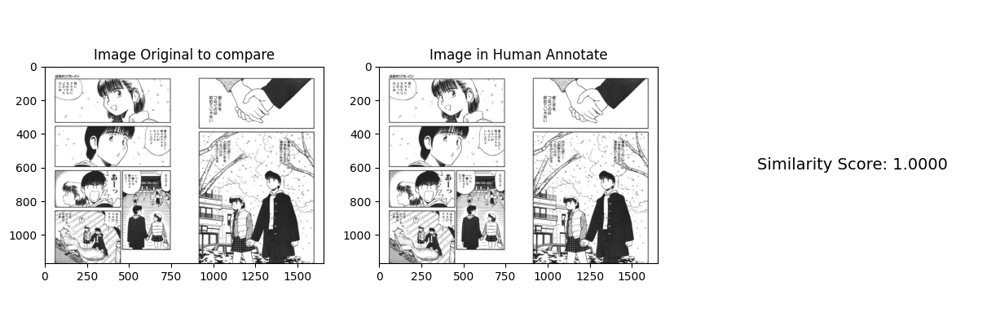

Processing original images:  90%|████████▉ | 528/588 [25:26<00:53,  1.13it/s]

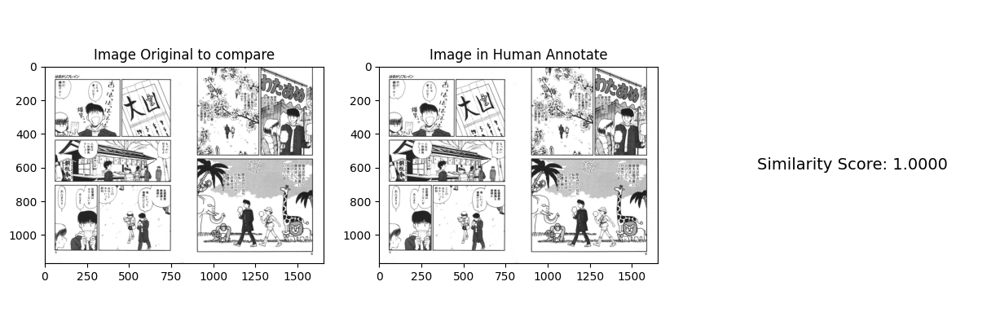

Processing original images:  90%|████████▉ | 529/588 [25:27<00:54,  1.08it/s]

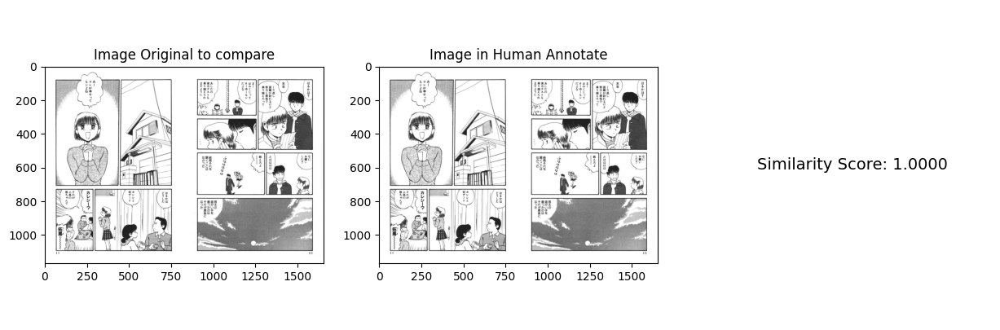

Processing original images:  90%|█████████ | 530/588 [25:28<00:57,  1.00it/s]

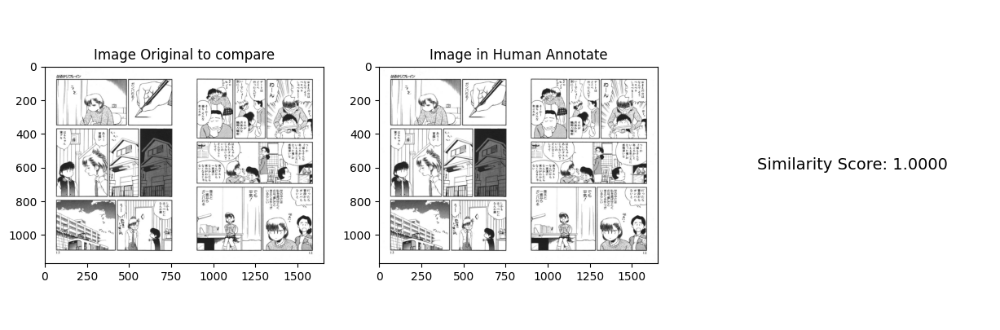

Processing original images:  90%|█████████ | 531/588 [25:29<00:59,  1.04s/it]

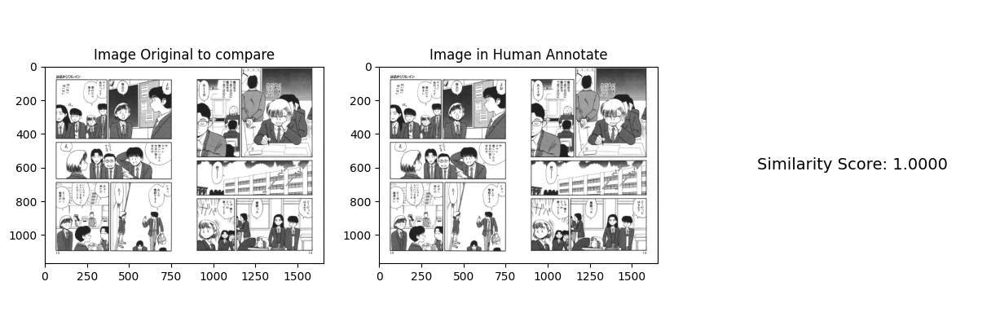

Processing original images:  90%|█████████ | 532/588 [25:30<01:01,  1.10s/it]

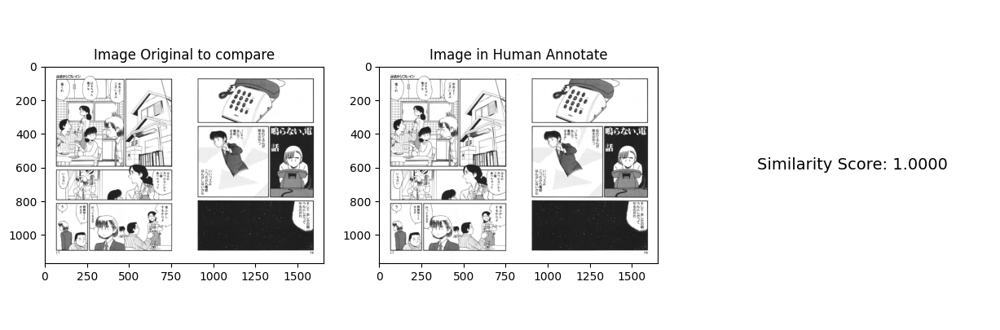

Processing original images:  91%|█████████ | 533/588 [25:32<01:06,  1.21s/it]

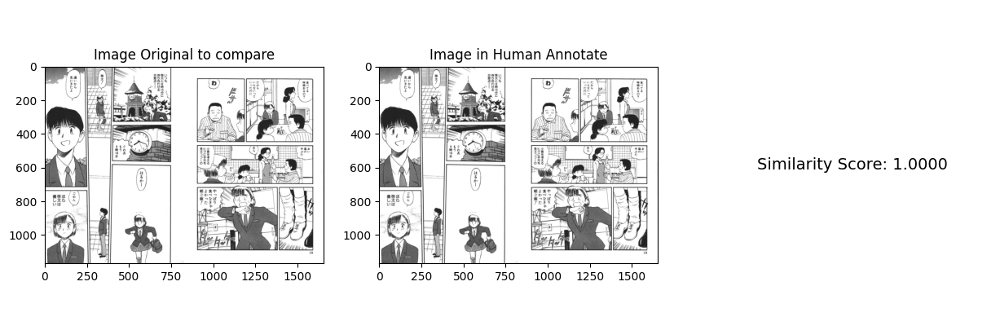

Processing original images:  91%|█████████ | 534/588 [25:33<01:09,  1.28s/it]

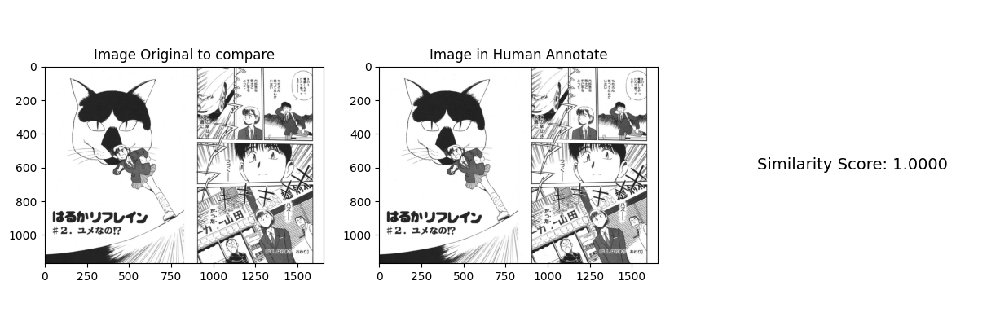

Processing original images:  93%|█████████▎| 549/588 [25:46<00:30,  1.27it/s]

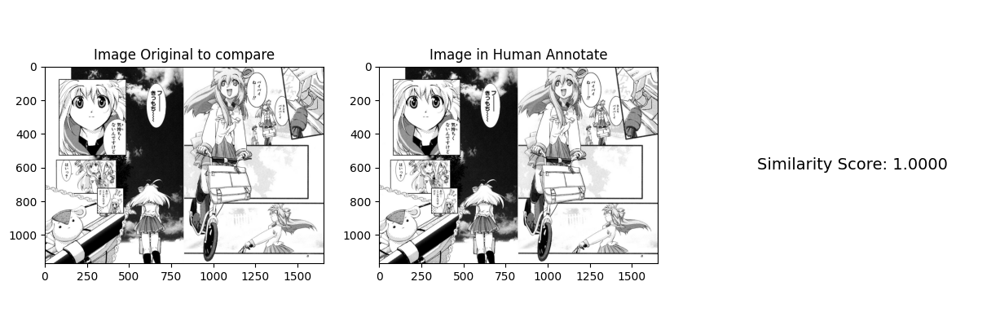

Processing original images:  94%|█████████▎| 550/588 [25:47<00:29,  1.29it/s]

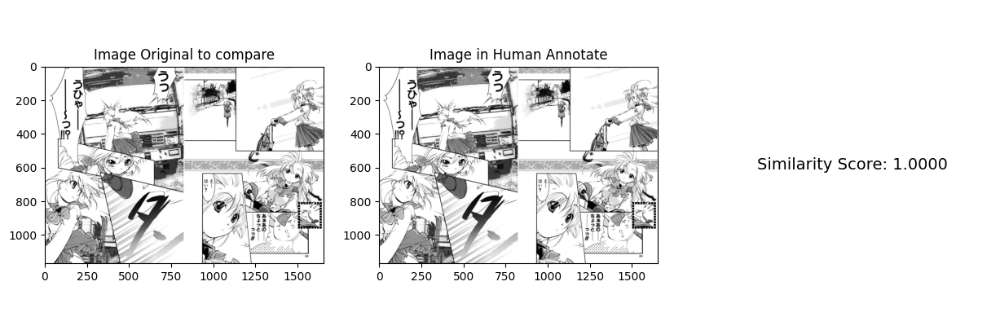

Processing original images:  94%|█████████▎| 551/588 [25:48<00:31,  1.16it/s]

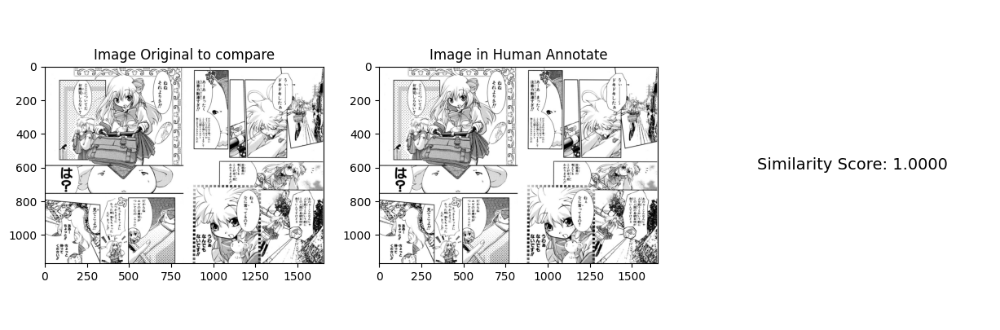

Processing original images:  94%|█████████▍| 552/588 [25:49<00:35,  1.03it/s]

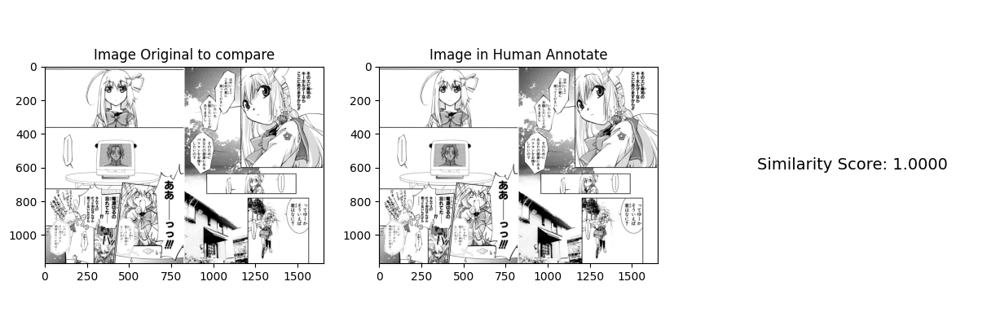

Processing original images:  94%|█████████▍| 553/588 [25:50<00:37,  1.08s/it]

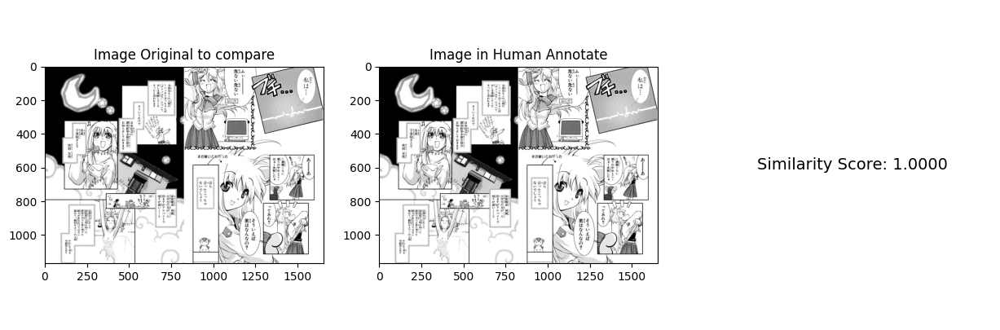

Processing original images:  94%|█████████▍| 554/588 [25:52<00:38,  1.14s/it]

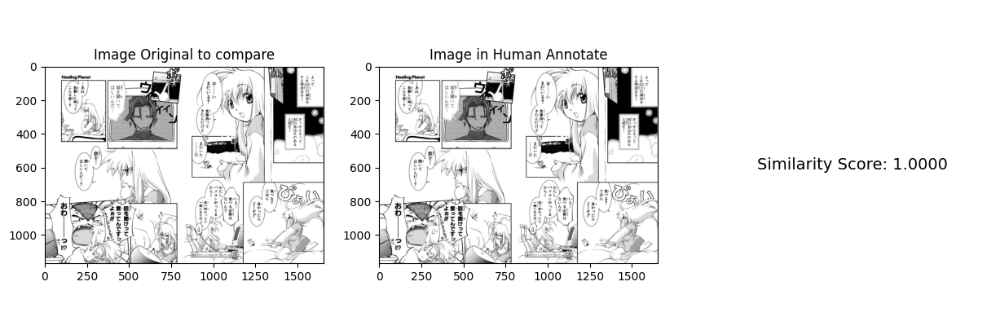

Processing original images:  94%|█████████▍| 555/588 [25:53<00:39,  1.20s/it]

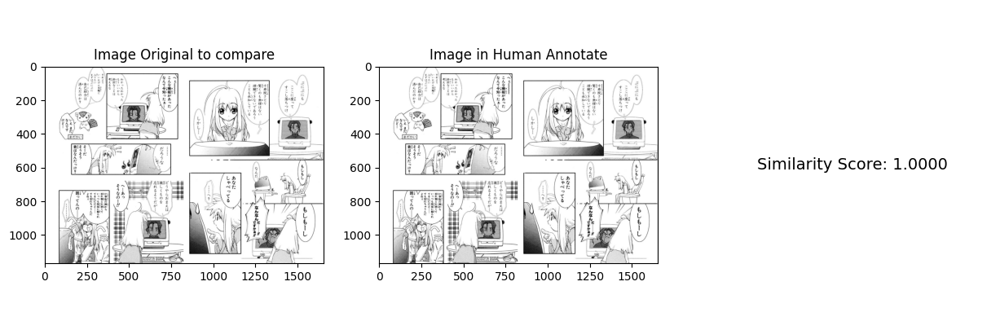

Processing original images:  97%|█████████▋| 568/588 [26:03<00:13,  1.47it/s]

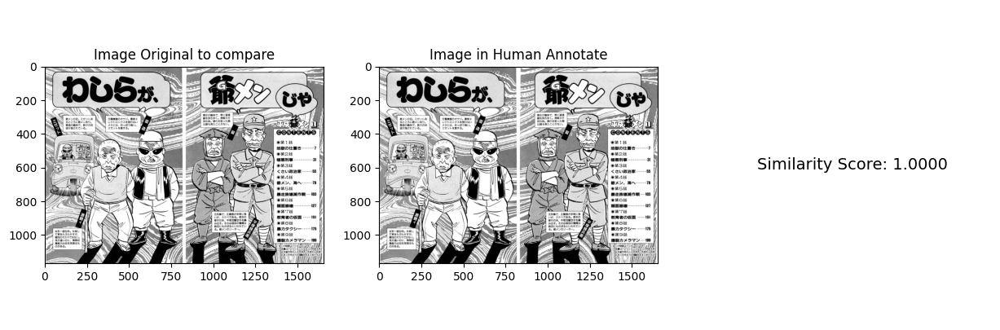

Processing original images:  97%|█████████▋| 569/588 [26:03<00:12,  1.49it/s]

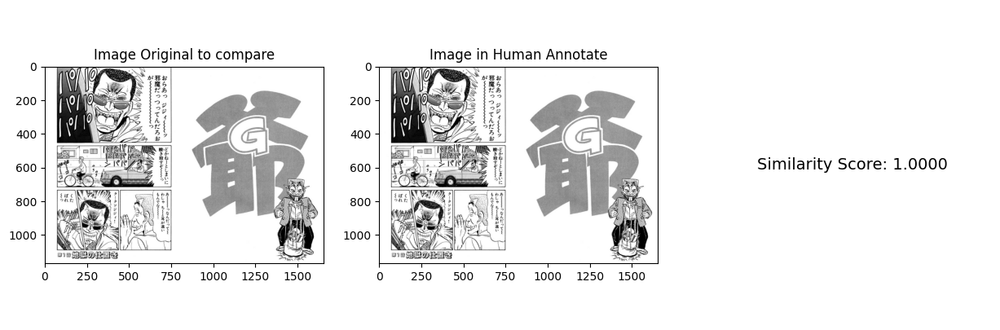

Processing original images:  97%|█████████▋| 570/588 [26:04<00:13,  1.34it/s]

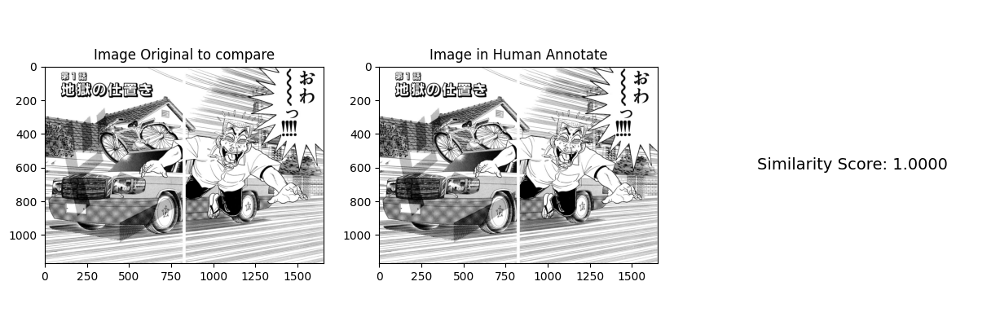

Processing original images:  97%|█████████▋| 571/588 [26:05<00:13,  1.26it/s]

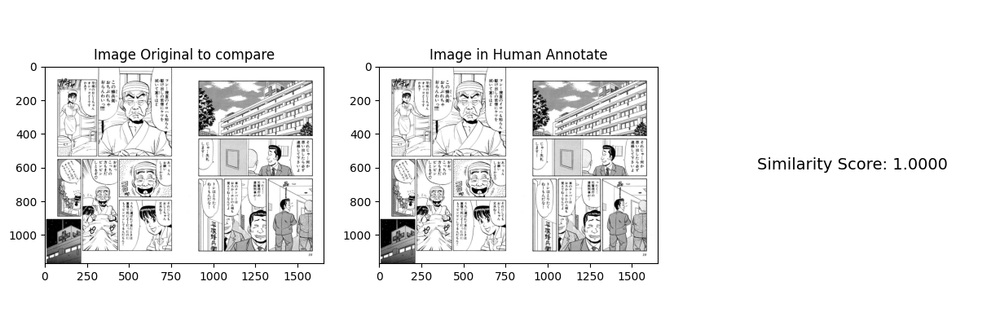

Processing original images:  97%|█████████▋| 572/588 [26:07<00:15,  1.03it/s]

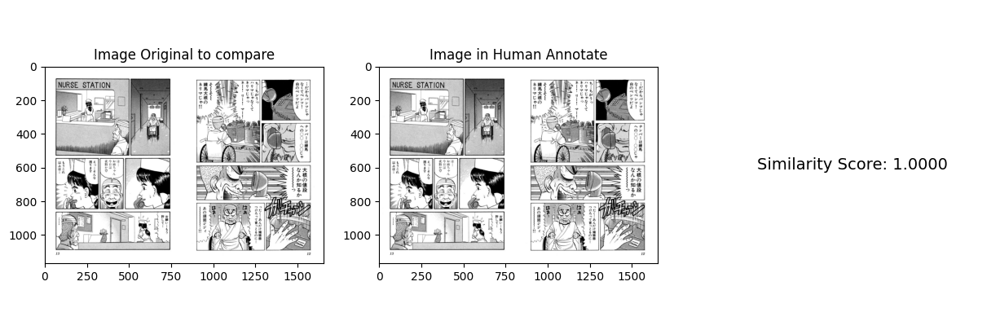

Processing original images:  97%|█████████▋| 573/588 [26:08<00:16,  1.09s/it]

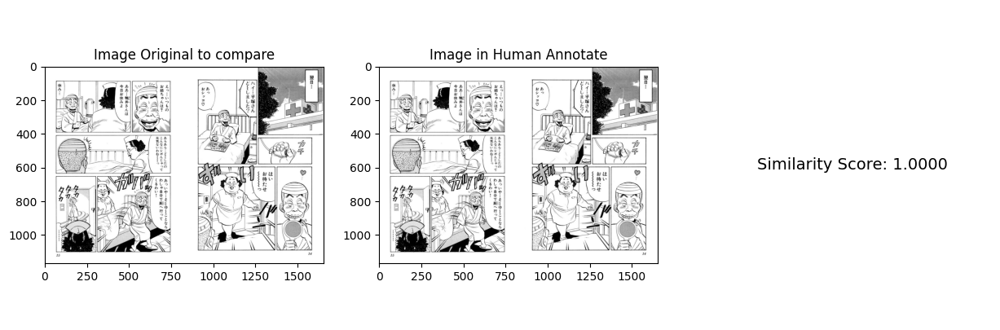

Processing original images:  98%|█████████▊| 574/588 [26:09<00:16,  1.19s/it]

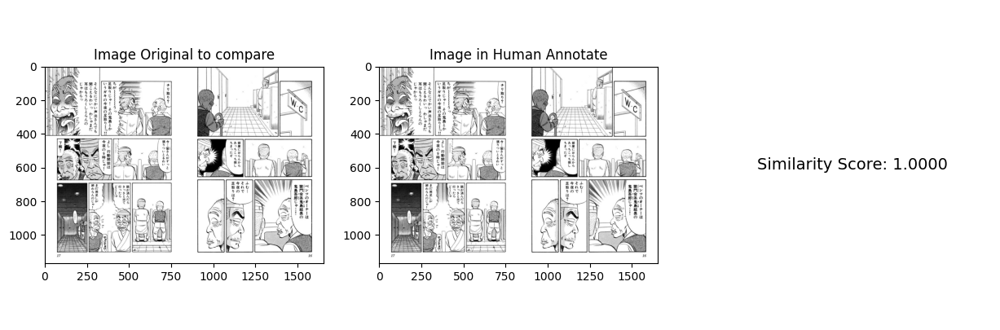

Processing original images:  98%|█████████▊| 575/588 [26:10<00:15,  1.16s/it]

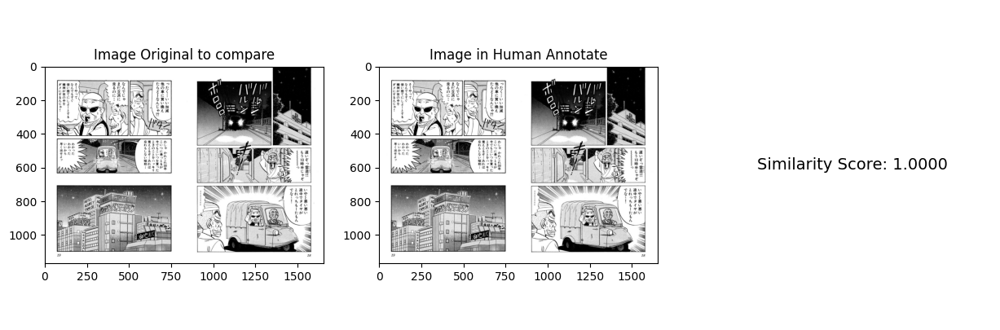

Processing original images:  98%|█████████▊| 576/588 [26:12<00:14,  1.18s/it]

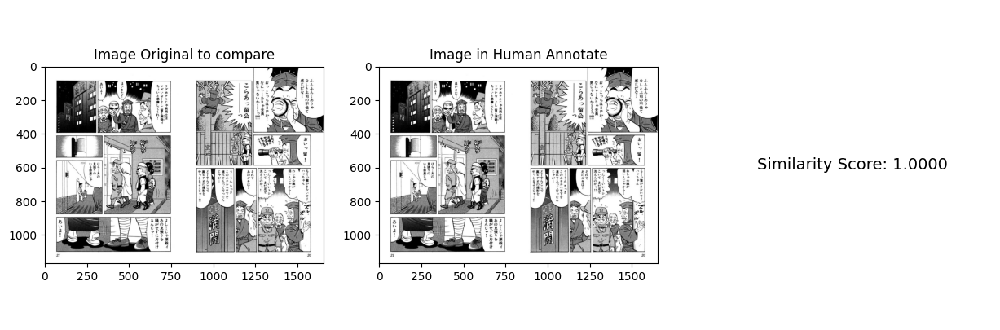

Processing original images: 100%|██████████| 588/588 [26:19<00:00,  2.69s/it]


In [35]:
import shutil
import os
from tqdm import tqdm

count_found = 0
original_image_path_len = len(original_image_path)
print(f"Total original images to find: {original_image_path_len}")
all_img_paths_len = len(all_img_paths)
print(f"Total images in human annotate directory: {all_img_paths_len}")

for img_path in tqdm(original_image_path, desc="Processing original images"):
    copy_img_path = os.path.join(human_annotate_dir, Path(img_path).parent.name)
    copy_img_name = Path(img_path).name
    for img_human in all_img_paths:
        if compare_images(img_path, img_human):
            found = True
            # Copy and rename the image
            shutil.copy(img_human, os.path.join(copy_img_path, copy_img_name))
            # Copy and rename the XML if it exists
            xml_human = os.path.splitext(img_human)[0] + ".xml"
            if os.path.exists(xml_human):
                shutil.copy(xml_human, os.path.join(copy_img_path, os.path.splitext(copy_img_name)[0] + ".xml"))
                os.remove(xml_human)  # Remove the xml file after copying
            # Remove img_human from all_img_paths and delete the file
            all_img_paths.remove(img_human)
            os.remove(img_human)  # Remove the image file after copying
            count_found += 1
            break
        else:
            continue

In [36]:
print(count_found)

211


In [37]:
# Delete the remaining files in train directory which are not matched
print(f"Remaining unmatched images to delete: {len(all_img_paths)}")

for file_path in all_img_paths:
    try:
        # Delete the image file itself
        if os.path.exists(file_path):
            os.remove(file_path)

        # Delete the corresponding XML file
        xml_path = os.path.splitext(file_path)[0] + ".xml"
        if os.path.exists(xml_path):
            os.remove(xml_path)
            
    except OSError as e:
        print(f"Error deleting file {file_path}: {e}")

print("Cleanup complete. All unmatched files have been deleted from the root of the train directory.")

Remaining unmatched images to delete: 20
Cleanup complete. All unmatched files have been deleted from the root of the train directory.


In [38]:
# Transform to XML format

import os
import xml.etree.ElementTree as ET
from pathlib import Path
import uuid
from xml.dom import minidom
from tqdm import tqdm

def generate_unique_id():
    """Generate a unique 8-character hex ID."""
    return uuid.uuid4().hex[:8]

def parse_roboflow_xml(xml_file_path):
    """Parse a Roboflow XML file and extract bounding box information."""
    tree = ET.parse(xml_file_path)
    root = tree.getroot()
    
    size = root.find('size')
    width = int(size.find('width').text)
    height = int(size.find('height').text)
    
    speech_balloons = []
    for obj in root.findall('object'):
        name = obj.find('name').text
        if name == 'Speech-Balloons':
            bndbox = obj.find('bndbox')
            balloon = {
                'xmin': int(bndbox.find('xmin').text),
                'ymin': int(bndbox.find('ymin').text),
                'xmax': int(bndbox.find('xmax').text),
                'ymax': int(bndbox.find('ymax').text)
            }
            speech_balloons.append(balloon)
    
    return width, height, speech_balloons

def create_manga109_xml(book_title, pages_data, output_path):
    """Create the consolidated XML file in the target Manga109-like format."""
    book = ET.Element('book', title=book_title)
    characters = ET.SubElement(book, 'characters')
    pages = ET.SubElement(book, 'pages')
    
    for page_index, page_data in sorted(pages_data.items()):
        if page_data is None:
            # Create an empty page entry if no XML was found
            page_elem = ET.SubElement(pages, 'page', index=str(page_index), width="0", height="0")
        else:
            width, height, speech_balloons = page_data
            page_elem = ET.SubElement(pages, 'page', index=str(page_index), width=str(width), height=str(height))
            
            for balloon in speech_balloons:
                bubble_id = generate_unique_id()
                ET.SubElement(page_elem, 'bubble', id=bubble_id,
                              xmin=str(balloon['xmin']),
                              ymin=str(balloon['ymin']),
                              xmax=str(balloon['xmax']),
                              ymax=str(balloon['ymax']))
    
    xml_string = ET.tostring(book, encoding='unicode')
    dom = minidom.parseString(xml_string)
    pretty_xml = dom.toprettyxml(indent="  ")
    
    # Write the pretty-printed XML to the output file
    with open(output_path, 'w', encoding='utf-8') as f:
        # Write without the default XML declaration line
        f.write('\n'.join(pretty_xml.split('\n')[1:]))

def process_book_folders(input_root, output_root):
    """Iterate through book folders, parse their XMLs, and create consolidated files."""
    input_path = Path(input_root)
    output_path = Path(output_root)
    output_path.mkdir(exist_ok=True)
    
    book_folders = [f for f in input_path.iterdir() if f.is_dir()]
    
    for book_folder in tqdm(book_folders, desc="Processing books"):
        book_title = book_folder.name
        xml_files = {}
        max_page = -1
        
        for xml_file in book_folder.glob('*.xml'):
            try:
                page_num = int(xml_file.stem)
                xml_files[page_num] = xml_file
                max_page = max(max_page, page_num)
            except ValueError:
                continue
        
        pages_data = {}
        for page_index in range(max_page + 1):
            if page_index in xml_files:
                try:
                    width, height, speech_balloons = parse_roboflow_xml(xml_files[page_index])
                    pages_data[page_index] = (width, height, speech_balloons)
                except Exception:
                    pages_data[page_index] = None # Mark as empty on error
            else:
                pages_data[page_index] = None # Mark as empty if no XML exists
        
        output_xml_path = output_path / f"{book_title}.xml"
        create_manga109_xml(book_title, pages_data, output_xml_path)

# --- Main Execution ---
input_directory = human_annotate_dir
output_directory = os.path.join(os.path.dirname(human_annotate_dir), 'annotations_xml')

print(f"Starting XML transformation...")
print(f"Input annotations folder: {input_directory}")
print(f"Output XML folder: {output_directory}")
print("-" * 60)

process_book_folders(input_directory, output_directory)

print("-" * 60)
print("Transformation complete.")
print(f"Consolidated XML files have been saved to: {output_directory}")

Starting XML transformation...
Input annotations folder: E:\B3\group_prj\characters-and-dialouges-association-in-comics\code\bubble-detection\../../data/Manga109/Human_Annotate_300/train
Output XML folder: E:\B3\group_prj\characters-and-dialouges-association-in-comics\code\bubble-detection\../../data/Manga109/Human_Annotate_300\annotations_xml
------------------------------------------------------------


Processing books: 100%|██████████| 35/35 [00:00<00:00, 71.74it/s]

------------------------------------------------------------
Transformation complete.
Consolidated XML files have been saved to: E:\B3\group_prj\characters-and-dialouges-association-in-comics\code\bubble-detection\../../data/Manga109/Human_Annotate_300\annotations_xml
